# Afriat

In [1]:
import warnings
import os
import sys
import gc
import warnings

In [2]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [3]:
torch.cuda.is_available()

False

In [4]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [5]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [6]:
asdp_1 = adata.X.sum()

In [7]:
ratio_true=0.92

from tardis._utils.functions import create_random_mask
mask = create_random_mask(adata.shape[1], ratio_true=ratio_true, seed=2024)
adata.X[:, mask] = 0.0

In [8]:
asdp_2 = adata.X.sum()

In [9]:
mask.sum()/adata.shape[1],  1-asdp_2/asdp_1

(0.9176, 0.909037359058857)

In [10]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [11]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [12]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_ablation_{ratio_true}"
)

vae.save(
    dir_path,
    overwrite=True,
)

W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_conference
ID: wbbkylxo
Name: mythical-midichlorian-123
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_conference/runs/wbbkylxo
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240504_155910-wbbkylxo/files



/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...


GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2562,3294,9387
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2562,2546,1691,3462,1606,3376
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4495,10748
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 643,815,2352
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 643,656,417,828,443,823
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1089,2721
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:16<2:45:47, 16.61s/it]

Epoch 1/600:   0%|          | 1/600 [00:16<2:45:47, 16.61s/it, v_num=xo_1, total_loss_train=544, kl_local_train=52.2]

Epoch 2/600:   0%|          | 1/600 [00:16<2:45:47, 16.61s/it, v_num=xo_1, total_loss_train=544, kl_local_train=52.2]

Epoch 2/600:   0%|          | 2/600 [00:31<2:37:48, 15.83s/it, v_num=xo_1, total_loss_train=544, kl_local_train=52.2]

Epoch 2/600:   0%|          | 2/600 [00:31<2:37:48, 15.83s/it, v_num=xo_1, total_loss_train=309, kl_local_train=85.9]

Epoch 3/600:   0%|          | 2/600 [00:31<2:37:48, 15.83s/it, v_num=xo_1, total_loss_train=309, kl_local_train=85.9]

Epoch 3/600:   0%|          | 3/600 [00:47<2:34:45, 15.55s/it, v_num=xo_1, total_loss_train=309, kl_local_train=85.9]

Epoch 3/600:   0%|          | 3/600 [00:47<2:34:45, 15.55s/it, v_num=xo_1, total_loss_train=289, kl_local_train=86.3]

Epoch 4/600:   0%|          | 3/600 [00:47<2:34:45, 15.55s/it, v_num=xo_1, total_loss_train=289, kl_local_train=86.3]

Epoch 4/600:   1%|          | 4/600 [01:02<2:32:55, 15.40s/it, v_num=xo_1, total_loss_train=289, kl_local_train=86.3]

Epoch 4/600:   1%|          | 4/600 [01:02<2:32:55, 15.40s/it, v_num=xo_1, total_loss_train=284, kl_local_train=77.4]

Epoch 5/600:   1%|          | 4/600 [01:02<2:32:55, 15.40s/it, v_num=xo_1, total_loss_train=284, kl_local_train=77.4]

Epoch 5/600:   1%|          | 5/600 [01:17<2:32:54, 15.42s/it, v_num=xo_1, total_loss_train=284, kl_local_train=77.4]

Epoch 5/600:   1%|          | 5/600 [01:17<2:32:54, 15.42s/it, v_num=xo_1, total_loss_train=281, kl_local_train=63.4]

Epoch 6/600:   1%|          | 5/600 [01:19<2:32:54, 15.42s/it, v_num=xo_1, total_loss_train=281, kl_local_train=63.4]

Epoch 6/600:   1%|          | 6/600 [01:33<2:34:05, 15.57s/it, v_num=xo_1, total_loss_train=281, kl_local_train=63.4]

Epoch 6/600:   1%|          | 6/600 [01:33<2:34:05, 15.57s/it, v_num=xo_1, total_loss_train=280, kl_local_train=46.3, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00728, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 7/600:   1%|          | 6/600 [01:33<2:34:05, 15.57s/it, v_num=xo_1, total_loss_train=280, kl_local_train=46.3, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00728, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 7/600:   1%|          | 7/600 [01:48<2:30:30, 15.23s/it, v_num=xo_1, total_loss_train=280, kl_local_train=46.3, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00728, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 7/600:   1%|          | 7/600 [01:48<2:30:30, 15.23s/it, v_num=xo_1, total_loss_train=279, kl_local_train=29.3, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00728, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 8/600:   1%|          | 7/600 [01:48<2:30:30, 15.23s/it, v_num=xo_1, total_loss_train=279, kl_local_train=29.3, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00728, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 8/600:   1%|▏         | 8/600 [02:02<2:28:00, 15.00s/it, v_num=xo_1, total_loss_train=279, kl_local_train=29.3, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00728, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 8/600:   1%|▏         | 8/600 [02:02<2:28:00, 15.00s/it, v_num=xo_1, total_loss_train=286, kl_local_train=16.4, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00728, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 9/600:   1%|▏         | 8/600 [02:02<2:28:00, 15.00s/it, v_num=xo_1, total_loss_train=286, kl_local_train=16.4, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00728, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 9/600:   2%|▏         | 9/600 [02:17<2:26:09, 14.84s/it, v_num=xo_1, total_loss_train=286, kl_local_train=16.4, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00728, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 9/600:   2%|▏         | 9/600 [02:17<2:26:09, 14.84s/it, v_num=xo_1, total_loss_train=293, kl_local_train=13.5, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00728, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 10/600:   2%|▏         | 9/600 [02:17<2:26:09, 14.84s/it, v_num=xo_1, total_loss_train=293, kl_local_train=13.5, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00728, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 10/600:   2%|▏         | 10/600 [02:31<2:25:09, 14.76s/it, v_num=xo_1, total_loss_train=293, kl_local_train=13.5, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00728, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 10/600:   2%|▏         | 10/600 [02:31<2:25:09, 14.76s/it, v_num=xo_1, total_loss_train=301, kl_local_train=12.5, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00728, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 11/600:   2%|▏         | 10/600 [02:33<2:25:09, 14.76s/it, v_num=xo_1, total_loss_train=301, kl_local_train=12.5, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00728, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 11/600:   2%|▏         | 11/600 [02:47<2:28:12, 15.10s/it, v_num=xo_1, total_loss_train=301, kl_local_train=12.5, metric_mi|status_control_train=0.0187, metric_mi|zone_train=0.00728, metric_mi|time_cat_train=0.0125, metric_mi|mouse_train=0.0352]

Epoch 11/600:   2%|▏         | 11/600 [02:47<2:28:12, 15.10s/it, v_num=xo_1, total_loss_train=308, kl_local_train=12.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00755, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 12/600:   2%|▏         | 11/600 [02:47<2:28:12, 15.10s/it, v_num=xo_1, total_loss_train=308, kl_local_train=12.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00755, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 12/600:   2%|▏         | 12/600 [03:02<2:26:03, 14.90s/it, v_num=xo_1, total_loss_train=308, kl_local_train=12.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00755, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 12/600:   2%|▏         | 12/600 [03:02<2:26:03, 14.90s/it, v_num=xo_1, total_loss_train=316, kl_local_train=17.2, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00755, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 13/600:   2%|▏         | 12/600 [03:02<2:26:03, 14.90s/it, v_num=xo_1, total_loss_train=316, kl_local_train=17.2, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00755, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 13/600:   2%|▏         | 13/600 [03:16<2:24:27, 14.77s/it, v_num=xo_1, total_loss_train=316, kl_local_train=17.2, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00755, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 13/600:   2%|▏         | 13/600 [03:16<2:24:27, 14.77s/it, v_num=xo_1, total_loss_train=321, kl_local_train=56.6, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00755, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 14/600:   2%|▏         | 13/600 [03:16<2:24:27, 14.77s/it, v_num=xo_1, total_loss_train=321, kl_local_train=56.6, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00755, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 14/600:   2%|▏         | 14/600 [03:30<2:23:20, 14.68s/it, v_num=xo_1, total_loss_train=321, kl_local_train=56.6, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00755, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 14/600:   2%|▏         | 14/600 [03:30<2:23:20, 14.68s/it, v_num=xo_1, total_loss_train=323, kl_local_train=95.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00755, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 15/600:   2%|▏         | 14/600 [03:30<2:23:20, 14.68s/it, v_num=xo_1, total_loss_train=323, kl_local_train=95.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00755, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 15/600:   2%|▎         | 15/600 [03:45<2:22:49, 14.65s/it, v_num=xo_1, total_loss_train=323, kl_local_train=95.8, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00755, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 15/600:   2%|▎         | 15/600 [03:45<2:22:49, 14.65s/it, v_num=xo_1, total_loss_train=322, kl_local_train=113, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00755, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348] 

Epoch 16/600:   2%|▎         | 15/600 [03:46<2:22:49, 14.65s/it, v_num=xo_1, total_loss_train=322, kl_local_train=113, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00755, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 16/600:   3%|▎         | 16/600 [04:01<2:26:14, 15.02s/it, v_num=xo_1, total_loss_train=322, kl_local_train=113, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00755, metric_mi|time_cat_train=0.0122, metric_mi|mouse_train=0.0348]

Epoch 16/600:   3%|▎         | 16/600 [04:01<2:26:14, 15.02s/it, v_num=xo_1, total_loss_train=325, kl_local_train=102, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0692]    

Epoch 17/600:   3%|▎         | 16/600 [04:01<2:26:14, 15.02s/it, v_num=xo_1, total_loss_train=325, kl_local_train=102, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0692]

Epoch 17/600:   3%|▎         | 17/600 [04:15<2:24:31, 14.87s/it, v_num=xo_1, total_loss_train=325, kl_local_train=102, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0692]

Epoch 17/600:   3%|▎         | 17/600 [04:15<2:24:31, 14.87s/it, v_num=xo_1, total_loss_train=329, kl_local_train=98.6, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0692]

Epoch 18/600:   3%|▎         | 17/600 [04:15<2:24:31, 14.87s/it, v_num=xo_1, total_loss_train=329, kl_local_train=98.6, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0692]

Epoch 18/600:   3%|▎         | 18/600 [04:30<2:23:15, 14.77s/it, v_num=xo_1, total_loss_train=329, kl_local_train=98.6, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0692]

Epoch 18/600:   3%|▎         | 18/600 [04:30<2:23:15, 14.77s/it, v_num=xo_1, total_loss_train=333, kl_local_train=103, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0692] 

Epoch 19/600:   3%|▎         | 18/600 [04:30<2:23:15, 14.77s/it, v_num=xo_1, total_loss_train=333, kl_local_train=103, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0692]

Epoch 19/600:   3%|▎         | 19/600 [04:45<2:22:20, 14.70s/it, v_num=xo_1, total_loss_train=333, kl_local_train=103, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0692]

Epoch 19/600:   3%|▎         | 19/600 [04:45<2:22:20, 14.70s/it, v_num=xo_1, total_loss_train=337, kl_local_train=104, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0692]

Epoch 20/600:   3%|▎         | 19/600 [04:45<2:22:20, 14.70s/it, v_num=xo_1, total_loss_train=337, kl_local_train=104, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0692]

Epoch 20/600:   3%|▎         | 20/600 [04:59<2:21:53, 14.68s/it, v_num=xo_1, total_loss_train=337, kl_local_train=104, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0692]

Epoch 20/600:   3%|▎         | 20/600 [04:59<2:21:53, 14.68s/it, v_num=xo_1, total_loss_train=339, kl_local_train=108, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0692]

Epoch 21/600:   3%|▎         | 20/600 [05:01<2:21:53, 14.68s/it, v_num=xo_1, total_loss_train=339, kl_local_train=108, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0692]

Epoch 21/600:   4%|▎         | 21/600 [05:13<2:19:18, 14.44s/it, v_num=xo_1, total_loss_train=339, kl_local_train=108, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.147, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0692]

Epoch 21/600:   4%|▎         | 21/600 [05:13<2:19:18, 14.44s/it, v_num=xo_1, total_loss_train=341, kl_local_train=126, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.101] 

Epoch 22/600:   4%|▎         | 21/600 [05:13<2:19:18, 14.44s/it, v_num=xo_1, total_loss_train=341, kl_local_train=126, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.101]

Epoch 22/600:   4%|▎         | 22/600 [05:25<2:13:24, 13.85s/it, v_num=xo_1, total_loss_train=341, kl_local_train=126, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.101]

Epoch 22/600:   4%|▎         | 22/600 [05:25<2:13:24, 13.85s/it, v_num=xo_1, total_loss_train=344, kl_local_train=137, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.101]

Epoch 23/600:   4%|▎         | 22/600 [05:26<2:13:24, 13.85s/it, v_num=xo_1, total_loss_train=344, kl_local_train=137, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.101]

Epoch 23/600:   4%|▍         | 23/600 [05:38<2:09:13, 13.44s/it, v_num=xo_1, total_loss_train=344, kl_local_train=137, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.101]

Epoch 23/600:   4%|▍         | 23/600 [05:38<2:09:13, 13.44s/it, v_num=xo_1, total_loss_train=347, kl_local_train=145, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.101]

Epoch 24/600:   4%|▍         | 23/600 [05:38<2:09:13, 13.44s/it, v_num=xo_1, total_loss_train=347, kl_local_train=145, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.101]

Epoch 24/600:   4%|▍         | 24/600 [05:50<2:06:12, 13.15s/it, v_num=xo_1, total_loss_train=347, kl_local_train=145, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.101]

Epoch 24/600:   4%|▍         | 24/600 [05:50<2:06:12, 13.15s/it, v_num=xo_1, total_loss_train=350, kl_local_train=152, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.101]

Epoch 25/600:   4%|▍         | 24/600 [05:50<2:06:12, 13.15s/it, v_num=xo_1, total_loss_train=350, kl_local_train=152, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.101]

Epoch 25/600:   4%|▍         | 25/600 [06:03<2:04:58, 13.04s/it, v_num=xo_1, total_loss_train=350, kl_local_train=152, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.101]

Epoch 25/600:   4%|▍         | 25/600 [06:03<2:04:58, 13.04s/it, v_num=xo_1, total_loss_train=354, kl_local_train=155, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.101]

Epoch 26/600:   4%|▍         | 25/600 [06:05<2:04:58, 13.04s/it, v_num=xo_1, total_loss_train=354, kl_local_train=155, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.101]

Epoch 26/600:   4%|▍         | 26/600 [06:17<2:07:02, 13.28s/it, v_num=xo_1, total_loss_train=354, kl_local_train=155, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.101]

Epoch 26/600:   4%|▍         | 26/600 [06:17<2:07:02, 13.28s/it, v_num=xo_1, total_loss_train=358, kl_local_train=158, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 27/600:   4%|▍         | 26/600 [06:17<2:07:02, 13.28s/it, v_num=xo_1, total_loss_train=358, kl_local_train=158, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 27/600:   4%|▍         | 27/600 [06:30<2:04:28, 13.03s/it, v_num=xo_1, total_loss_train=358, kl_local_train=158, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 27/600:   4%|▍         | 27/600 [06:30<2:04:28, 13.03s/it, v_num=xo_1, total_loss_train=361, kl_local_train=157, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 28/600:   4%|▍         | 27/600 [06:30<2:04:28, 13.03s/it, v_num=xo_1, total_loss_train=361, kl_local_train=157, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 28/600:   5%|▍         | 28/600 [06:42<2:02:36, 12.86s/it, v_num=xo_1, total_loss_train=361, kl_local_train=157, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 28/600:   5%|▍         | 28/600 [06:42<2:02:36, 12.86s/it, v_num=xo_1, total_loss_train=365, kl_local_train=156, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 29/600:   5%|▍         | 28/600 [06:42<2:02:36, 12.86s/it, v_num=xo_1, total_loss_train=365, kl_local_train=156, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 29/600:   5%|▍         | 29/600 [06:54<2:01:18, 12.75s/it, v_num=xo_1, total_loss_train=365, kl_local_train=156, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 29/600:   5%|▍         | 29/600 [06:54<2:01:18, 12.75s/it, v_num=xo_1, total_loss_train=369, kl_local_train=158, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 30/600:   5%|▍         | 29/600 [06:54<2:01:18, 12.75s/it, v_num=xo_1, total_loss_train=369, kl_local_train=158, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 30/600:   5%|▌         | 30/600 [07:07<2:00:24, 12.67s/it, v_num=xo_1, total_loss_train=369, kl_local_train=158, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 30/600:   5%|▌         | 30/600 [07:07<2:00:24, 12.67s/it, v_num=xo_1, total_loss_train=373, kl_local_train=158, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 31/600:   5%|▌         | 30/600 [07:08<2:00:24, 12.67s/it, v_num=xo_1, total_loss_train=373, kl_local_train=158, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 31/600:   5%|▌         | 31/600 [07:21<2:03:34, 13.03s/it, v_num=xo_1, total_loss_train=373, kl_local_train=158, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.134]

Epoch 31/600:   5%|▌         | 31/600 [07:21<2:03:34, 13.03s/it, v_num=xo_1, total_loss_train=377, kl_local_train=157, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.142] 

Epoch 32/600:   5%|▌         | 31/600 [07:21<2:03:34, 13.03s/it, v_num=xo_1, total_loss_train=377, kl_local_train=157, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.142]

Epoch 32/600:   5%|▌         | 32/600 [07:33<2:01:59, 12.89s/it, v_num=xo_1, total_loss_train=377, kl_local_train=157, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.142]

Epoch 32/600:   5%|▌         | 32/600 [07:33<2:01:59, 12.89s/it, v_num=xo_1, total_loss_train=381, kl_local_train=156, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.142]

Epoch 33/600:   5%|▌         | 32/600 [07:33<2:01:59, 12.89s/it, v_num=xo_1, total_loss_train=381, kl_local_train=156, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.142]

Epoch 33/600:   6%|▌         | 33/600 [07:46<2:00:41, 12.77s/it, v_num=xo_1, total_loss_train=381, kl_local_train=156, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.142]

Epoch 33/600:   6%|▌         | 33/600 [07:46<2:00:41, 12.77s/it, v_num=xo_1, total_loss_train=385, kl_local_train=158, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.142]

Epoch 34/600:   6%|▌         | 33/600 [07:46<2:00:41, 12.77s/it, v_num=xo_1, total_loss_train=385, kl_local_train=158, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.142]

Epoch 34/600:   6%|▌         | 34/600 [07:58<1:59:44, 12.69s/it, v_num=xo_1, total_loss_train=385, kl_local_train=158, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.142]

Epoch 34/600:   6%|▌         | 34/600 [07:58<1:59:44, 12.69s/it, v_num=xo_1, total_loss_train=389, kl_local_train=160, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.142]

Epoch 35/600:   6%|▌         | 34/600 [07:58<1:59:44, 12.69s/it, v_num=xo_1, total_loss_train=389, kl_local_train=160, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.142]

Epoch 35/600:   6%|▌         | 35/600 [08:11<1:59:03, 12.64s/it, v_num=xo_1, total_loss_train=389, kl_local_train=160, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.142]

Epoch 35/600:   6%|▌         | 35/600 [08:11<1:59:03, 12.64s/it, v_num=xo_1, total_loss_train=393, kl_local_train=160, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.142]

Epoch 36/600:   6%|▌         | 35/600 [08:12<1:59:03, 12.64s/it, v_num=xo_1, total_loss_train=393, kl_local_train=160, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.142]

Epoch 36/600:   6%|▌         | 36/600 [08:25<2:02:22, 13.02s/it, v_num=xo_1, total_loss_train=393, kl_local_train=160, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.142]

Epoch 36/600:   6%|▌         | 36/600 [08:25<2:02:22, 13.02s/it, v_num=xo_1, total_loss_train=397, kl_local_train=163, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.146]

Epoch 37/600:   6%|▌         | 36/600 [08:25<2:02:22, 13.02s/it, v_num=xo_1, total_loss_train=397, kl_local_train=163, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.146]

Epoch 37/600:   6%|▌         | 37/600 [08:37<2:00:49, 12.88s/it, v_num=xo_1, total_loss_train=397, kl_local_train=163, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.146]

Epoch 37/600:   6%|▌         | 37/600 [08:37<2:00:49, 12.88s/it, v_num=xo_1, total_loss_train=401, kl_local_train=161, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.146]

Epoch 38/600:   6%|▌         | 37/600 [08:37<2:00:49, 12.88s/it, v_num=xo_1, total_loss_train=401, kl_local_train=161, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.146]

Epoch 38/600:   6%|▋         | 38/600 [08:50<1:59:40, 12.78s/it, v_num=xo_1, total_loss_train=401, kl_local_train=161, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.146]

Epoch 38/600:   6%|▋         | 38/600 [08:50<1:59:40, 12.78s/it, v_num=xo_1, total_loss_train=405, kl_local_train=162, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.146]

Epoch 39/600:   6%|▋         | 38/600 [08:50<1:59:40, 12.78s/it, v_num=xo_1, total_loss_train=405, kl_local_train=162, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.146]

Epoch 39/600:   6%|▋         | 39/600 [09:02<1:58:47, 12.70s/it, v_num=xo_1, total_loss_train=405, kl_local_train=162, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.146]

Epoch 39/600:   6%|▋         | 39/600 [09:02<1:58:47, 12.70s/it, v_num=xo_1, total_loss_train=409, kl_local_train=164, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.146]

Epoch 40/600:   6%|▋         | 39/600 [09:02<1:58:47, 12.70s/it, v_num=xo_1, total_loss_train=409, kl_local_train=164, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.146]

Epoch 40/600:   7%|▋         | 40/600 [09:15<1:58:16, 12.67s/it, v_num=xo_1, total_loss_train=409, kl_local_train=164, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.146]

Epoch 40/600:   7%|▋         | 40/600 [09:15<1:58:16, 12.67s/it, v_num=xo_1, total_loss_train=413, kl_local_train=165, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.146]

Epoch 41/600:   7%|▋         | 40/600 [09:16<1:58:16, 12.67s/it, v_num=xo_1, total_loss_train=413, kl_local_train=165, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.146]

Epoch 41/600:   7%|▋         | 41/600 [09:29<2:01:30, 13.04s/it, v_num=xo_1, total_loss_train=413, kl_local_train=165, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.198, metric_mi|mouse_train=0.146]

Epoch 41/600:   7%|▋         | 41/600 [09:29<2:01:30, 13.04s/it, v_num=xo_1, total_loss_train=417, kl_local_train=165, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 42/600:   7%|▋         | 41/600 [09:29<2:01:30, 13.04s/it, v_num=xo_1, total_loss_train=417, kl_local_train=165, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 42/600:   7%|▋         | 42/600 [09:42<2:00:23, 12.94s/it, v_num=xo_1, total_loss_train=417, kl_local_train=165, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 42/600:   7%|▋         | 42/600 [09:42<2:00:23, 12.94s/it, v_num=xo_1, total_loss_train=421, kl_local_train=164, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 43/600:   7%|▋         | 42/600 [09:42<2:00:23, 12.94s/it, v_num=xo_1, total_loss_train=421, kl_local_train=164, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 43/600:   7%|▋         | 43/600 [09:54<1:59:11, 12.84s/it, v_num=xo_1, total_loss_train=421, kl_local_train=164, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 43/600:   7%|▋         | 43/600 [09:54<1:59:11, 12.84s/it, v_num=xo_1, total_loss_train=425, kl_local_train=166, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 44/600:   7%|▋         | 43/600 [09:54<1:59:11, 12.84s/it, v_num=xo_1, total_loss_train=425, kl_local_train=166, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 44/600:   7%|▋         | 44/600 [10:07<1:58:15, 12.76s/it, v_num=xo_1, total_loss_train=425, kl_local_train=166, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 44/600:   7%|▋         | 44/600 [10:07<1:58:15, 12.76s/it, v_num=xo_1, total_loss_train=429, kl_local_train=167, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 45/600:   7%|▋         | 44/600 [10:07<1:58:15, 12.76s/it, v_num=xo_1, total_loss_train=429, kl_local_train=167, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 45/600:   8%|▊         | 45/600 [10:19<1:57:29, 12.70s/it, v_num=xo_1, total_loss_train=429, kl_local_train=167, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 45/600:   8%|▊         | 45/600 [10:19<1:57:29, 12.70s/it, v_num=xo_1, total_loss_train=433, kl_local_train=165, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 46/600:   8%|▊         | 45/600 [10:21<1:57:29, 12.70s/it, v_num=xo_1, total_loss_train=433, kl_local_train=165, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 46/600:   8%|▊         | 46/600 [10:33<2:00:37, 13.06s/it, v_num=xo_1, total_loss_train=433, kl_local_train=165, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.197, metric_mi|mouse_train=0.146]

Epoch 46/600:   8%|▊         | 46/600 [10:33<2:00:37, 13.06s/it, v_num=xo_1, total_loss_train=437, kl_local_train=163, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 47/600:   8%|▊         | 46/600 [10:33<2:00:37, 13.06s/it, v_num=xo_1, total_loss_train=437, kl_local_train=163, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 47/600:   8%|▊         | 47/600 [10:46<1:59:05, 12.92s/it, v_num=xo_1, total_loss_train=437, kl_local_train=163, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 47/600:   8%|▊         | 47/600 [10:46<1:59:05, 12.92s/it, v_num=xo_1, total_loss_train=441, kl_local_train=164, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 48/600:   8%|▊         | 47/600 [10:46<1:59:05, 12.92s/it, v_num=xo_1, total_loss_train=441, kl_local_train=164, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 48/600:   8%|▊         | 48/600 [10:58<1:57:50, 12.81s/it, v_num=xo_1, total_loss_train=441, kl_local_train=164, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 48/600:   8%|▊         | 48/600 [10:58<1:57:50, 12.81s/it, v_num=xo_1, total_loss_train=446, kl_local_train=165, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 49/600:   8%|▊         | 48/600 [10:58<1:57:50, 12.81s/it, v_num=xo_1, total_loss_train=446, kl_local_train=165, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 49/600:   8%|▊         | 49/600 [11:11<1:56:56, 12.73s/it, v_num=xo_1, total_loss_train=446, kl_local_train=165, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 49/600:   8%|▊         | 49/600 [11:11<1:56:56, 12.73s/it, v_num=xo_1, total_loss_train=450, kl_local_train=166, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 50/600:   8%|▊         | 49/600 [11:11<1:56:56, 12.73s/it, v_num=xo_1, total_loss_train=450, kl_local_train=166, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 50/600:   8%|▊         | 50/600 [11:24<1:56:12, 12.68s/it, v_num=xo_1, total_loss_train=450, kl_local_train=166, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 50/600:   8%|▊         | 50/600 [11:24<1:56:12, 12.68s/it, v_num=xo_1, total_loss_train=454, kl_local_train=167, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 51/600:   8%|▊         | 50/600 [11:25<1:56:12, 12.68s/it, v_num=xo_1, total_loss_train=454, kl_local_train=167, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 51/600:   8%|▊         | 51/600 [11:37<1:59:21, 13.04s/it, v_num=xo_1, total_loss_train=454, kl_local_train=167, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 51/600:   8%|▊         | 51/600 [11:37<1:59:21, 13.04s/it, v_num=xo_1, total_loss_train=454, kl_local_train=168, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 52/600:   8%|▊         | 51/600 [11:37<1:59:21, 13.04s/it, v_num=xo_1, total_loss_train=454, kl_local_train=168, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 52/600:   9%|▊         | 52/600 [11:50<1:57:51, 12.90s/it, v_num=xo_1, total_loss_train=454, kl_local_train=168, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 52/600:   9%|▊         | 52/600 [11:50<1:57:51, 12.90s/it, v_num=xo_1, total_loss_train=454, kl_local_train=168, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 53/600:   9%|▊         | 52/600 [11:50<1:57:51, 12.90s/it, v_num=xo_1, total_loss_train=454, kl_local_train=168, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 53/600:   9%|▉         | 53/600 [12:03<1:56:45, 12.81s/it, v_num=xo_1, total_loss_train=454, kl_local_train=168, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 53/600:   9%|▉         | 53/600 [12:03<1:56:45, 12.81s/it, v_num=xo_1, total_loss_train=454, kl_local_train=163, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 54/600:   9%|▉         | 53/600 [12:03<1:56:45, 12.81s/it, v_num=xo_1, total_loss_train=454, kl_local_train=163, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 54/600:   9%|▉         | 54/600 [12:15<1:55:57, 12.74s/it, v_num=xo_1, total_loss_train=454, kl_local_train=163, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 54/600:   9%|▉         | 54/600 [12:15<1:55:57, 12.74s/it, v_num=xo_1, total_loss_train=454, kl_local_train=161, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 55/600:   9%|▉         | 54/600 [12:15<1:55:57, 12.74s/it, v_num=xo_1, total_loss_train=454, kl_local_train=161, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 55/600:   9%|▉         | 55/600 [12:28<1:55:14, 12.69s/it, v_num=xo_1, total_loss_train=454, kl_local_train=161, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 55/600:   9%|▉         | 55/600 [12:28<1:55:14, 12.69s/it, v_num=xo_1, total_loss_train=453, kl_local_train=160, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 56/600:   9%|▉         | 55/600 [12:29<1:55:14, 12.69s/it, v_num=xo_1, total_loss_train=453, kl_local_train=160, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 56/600:   9%|▉         | 56/600 [12:42<1:58:17, 13.05s/it, v_num=xo_1, total_loss_train=453, kl_local_train=160, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.144]

Epoch 56/600:   9%|▉         | 56/600 [12:42<1:58:17, 13.05s/it, v_num=xo_1, total_loss_train=453, kl_local_train=159, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 57/600:   9%|▉         | 56/600 [12:42<1:58:17, 13.05s/it, v_num=xo_1, total_loss_train=453, kl_local_train=159, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 57/600:  10%|▉         | 57/600 [12:54<1:56:47, 12.91s/it, v_num=xo_1, total_loss_train=453, kl_local_train=159, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 57/600:  10%|▉         | 57/600 [12:54<1:56:47, 12.91s/it, v_num=xo_1, total_loss_train=453, kl_local_train=159, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 58/600:  10%|▉         | 57/600 [12:54<1:56:47, 12.91s/it, v_num=xo_1, total_loss_train=453, kl_local_train=159, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 58/600:  10%|▉         | 58/600 [13:07<1:55:39, 12.80s/it, v_num=xo_1, total_loss_train=453, kl_local_train=159, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 58/600:  10%|▉         | 58/600 [13:07<1:55:39, 12.80s/it, v_num=xo_1, total_loss_train=453, kl_local_train=157, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 59/600:  10%|▉         | 58/600 [13:07<1:55:39, 12.80s/it, v_num=xo_1, total_loss_train=453, kl_local_train=157, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 59/600:  10%|▉         | 59/600 [13:19<1:54:48, 12.73s/it, v_num=xo_1, total_loss_train=453, kl_local_train=157, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 59/600:  10%|▉         | 59/600 [13:19<1:54:48, 12.73s/it, v_num=xo_1, total_loss_train=453, kl_local_train=157, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 60/600:  10%|▉         | 59/600 [13:19<1:54:48, 12.73s/it, v_num=xo_1, total_loss_train=453, kl_local_train=157, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 60/600:  10%|█         | 60/600 [13:32<1:54:05, 12.68s/it, v_num=xo_1, total_loss_train=453, kl_local_train=157, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 60/600:  10%|█         | 60/600 [13:32<1:54:05, 12.68s/it, v_num=xo_1, total_loss_train=453, kl_local_train=154, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 61/600:  10%|█         | 60/600 [13:33<1:54:05, 12.68s/it, v_num=xo_1, total_loss_train=453, kl_local_train=154, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 61/600:  10%|█         | 61/600 [13:46<1:57:11, 13.05s/it, v_num=xo_1, total_loss_train=453, kl_local_train=154, metric_mi|status_control_train=0.244, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 61/600:  10%|█         | 61/600 [13:46<1:57:11, 13.05s/it, v_num=xo_1, total_loss_train=453, kl_local_train=154, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 62/600:  10%|█         | 61/600 [13:46<1:57:11, 13.05s/it, v_num=xo_1, total_loss_train=453, kl_local_train=154, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 62/600:  10%|█         | 62/600 [13:58<1:55:45, 12.91s/it, v_num=xo_1, total_loss_train=453, kl_local_train=154, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 62/600:  10%|█         | 62/600 [13:58<1:55:45, 12.91s/it, v_num=xo_1, total_loss_train=453, kl_local_train=152, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 63/600:  10%|█         | 62/600 [13:58<1:55:45, 12.91s/it, v_num=xo_1, total_loss_train=453, kl_local_train=152, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 63/600:  10%|█         | 63/600 [14:11<1:54:41, 12.82s/it, v_num=xo_1, total_loss_train=453, kl_local_train=152, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 63/600:  10%|█         | 63/600 [14:11<1:54:41, 12.82s/it, v_num=xo_1, total_loss_train=453, kl_local_train=150, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 64/600:  10%|█         | 63/600 [14:11<1:54:41, 12.82s/it, v_num=xo_1, total_loss_train=453, kl_local_train=150, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 64/600:  11%|█         | 64/600 [14:24<1:53:53, 12.75s/it, v_num=xo_1, total_loss_train=453, kl_local_train=150, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 64/600:  11%|█         | 64/600 [14:24<1:53:53, 12.75s/it, v_num=xo_1, total_loss_train=453, kl_local_train=148, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 65/600:  11%|█         | 64/600 [14:24<1:53:53, 12.75s/it, v_num=xo_1, total_loss_train=453, kl_local_train=148, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 65/600:  11%|█         | 65/600 [14:36<1:53:07, 12.69s/it, v_num=xo_1, total_loss_train=453, kl_local_train=148, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 65/600:  11%|█         | 65/600 [14:36<1:53:07, 12.69s/it, v_num=xo_1, total_loss_train=453, kl_local_train=146, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 66/600:  11%|█         | 65/600 [14:37<1:53:07, 12.69s/it, v_num=xo_1, total_loss_train=453, kl_local_train=146, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 66/600:  11%|█         | 66/600 [14:50<1:56:29, 13.09s/it, v_num=xo_1, total_loss_train=453, kl_local_train=146, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.195, metric_mi|mouse_train=0.145]

Epoch 66/600:  11%|█         | 66/600 [14:50<1:56:29, 13.09s/it, v_num=xo_1, total_loss_train=453, kl_local_train=146, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 67/600:  11%|█         | 66/600 [14:50<1:56:29, 13.09s/it, v_num=xo_1, total_loss_train=453, kl_local_train=146, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 67/600:  11%|█         | 67/600 [15:03<1:55:03, 12.95s/it, v_num=xo_1, total_loss_train=453, kl_local_train=146, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 67/600:  11%|█         | 67/600 [15:03<1:55:03, 12.95s/it, v_num=xo_1, total_loss_train=453, kl_local_train=144, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 68/600:  11%|█         | 67/600 [15:03<1:55:03, 12.95s/it, v_num=xo_1, total_loss_train=453, kl_local_train=144, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 68/600:  11%|█▏        | 68/600 [15:15<1:54:00, 12.86s/it, v_num=xo_1, total_loss_train=453, kl_local_train=144, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 68/600:  11%|█▏        | 68/600 [15:15<1:54:00, 12.86s/it, v_num=xo_1, total_loss_train=453, kl_local_train=141, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 69/600:  11%|█▏        | 68/600 [15:15<1:54:00, 12.86s/it, v_num=xo_1, total_loss_train=453, kl_local_train=141, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 69/600:  12%|█▏        | 69/600 [15:28<1:53:02, 12.77s/it, v_num=xo_1, total_loss_train=453, kl_local_train=141, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 69/600:  12%|█▏        | 69/600 [15:28<1:53:02, 12.77s/it, v_num=xo_1, total_loss_train=453, kl_local_train=140, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 70/600:  12%|█▏        | 69/600 [15:28<1:53:02, 12.77s/it, v_num=xo_1, total_loss_train=453, kl_local_train=140, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 70/600:  12%|█▏        | 70/600 [15:41<1:52:15, 12.71s/it, v_num=xo_1, total_loss_train=453, kl_local_train=140, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 70/600:  12%|█▏        | 70/600 [15:41<1:52:15, 12.71s/it, v_num=xo_1, total_loss_train=453, kl_local_train=138, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 71/600:  12%|█▏        | 70/600 [15:42<1:52:15, 12.71s/it, v_num=xo_1, total_loss_train=453, kl_local_train=138, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 71/600:  12%|█▏        | 71/600 [15:54<1:55:16, 13.08s/it, v_num=xo_1, total_loss_train=453, kl_local_train=138, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 71/600:  12%|█▏        | 71/600 [15:54<1:55:16, 13.08s/it, v_num=xo_1, total_loss_train=453, kl_local_train=136, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146] 

Epoch 72/600:  12%|█▏        | 71/600 [15:55<1:55:16, 13.08s/it, v_num=xo_1, total_loss_train=453, kl_local_train=136, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 72/600:  12%|█▏        | 72/600 [16:07<1:53:44, 12.92s/it, v_num=xo_1, total_loss_train=453, kl_local_train=136, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 72/600:  12%|█▏        | 72/600 [16:07<1:53:44, 12.92s/it, v_num=xo_1, total_loss_train=453, kl_local_train=133, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 73/600:  12%|█▏        | 72/600 [16:07<1:53:44, 12.92s/it, v_num=xo_1, total_loss_train=453, kl_local_train=133, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 73/600:  12%|█▏        | 73/600 [16:20<1:52:32, 12.81s/it, v_num=xo_1, total_loss_train=453, kl_local_train=133, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 73/600:  12%|█▏        | 73/600 [16:20<1:52:32, 12.81s/it, v_num=xo_1, total_loss_train=453, kl_local_train=134, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 74/600:  12%|█▏        | 73/600 [16:20<1:52:32, 12.81s/it, v_num=xo_1, total_loss_train=453, kl_local_train=134, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 74/600:  12%|█▏        | 74/600 [16:32<1:51:41, 12.74s/it, v_num=xo_1, total_loss_train=453, kl_local_train=134, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 74/600:  12%|█▏        | 74/600 [16:32<1:51:41, 12.74s/it, v_num=xo_1, total_loss_train=453, kl_local_train=132, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 75/600:  12%|█▏        | 74/600 [16:32<1:51:41, 12.74s/it, v_num=xo_1, total_loss_train=453, kl_local_train=132, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 75/600:  12%|█▎        | 75/600 [16:45<1:50:57, 12.68s/it, v_num=xo_1, total_loss_train=453, kl_local_train=132, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 75/600:  12%|█▎        | 75/600 [16:45<1:50:57, 12.68s/it, v_num=xo_1, total_loss_train=453, kl_local_train=132, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 76/600:  12%|█▎        | 75/600 [16:46<1:50:57, 12.68s/it, v_num=xo_1, total_loss_train=453, kl_local_train=132, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 76/600:  13%|█▎        | 76/600 [16:59<1:54:02, 13.06s/it, v_num=xo_1, total_loss_train=453, kl_local_train=132, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.196, metric_mi|mouse_train=0.146]

Epoch 76/600:  13%|█▎        | 76/600 [16:59<1:54:02, 13.06s/it, v_num=xo_1, total_loss_train=453, kl_local_train=130, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 77/600:  13%|█▎        | 76/600 [16:59<1:54:02, 13.06s/it, v_num=xo_1, total_loss_train=453, kl_local_train=130, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 77/600:  13%|█▎        | 77/600 [17:11<1:52:38, 12.92s/it, v_num=xo_1, total_loss_train=453, kl_local_train=130, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 77/600:  13%|█▎        | 77/600 [17:11<1:52:38, 12.92s/it, v_num=xo_1, total_loss_train=453, kl_local_train=129, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 78/600:  13%|█▎        | 77/600 [17:11<1:52:38, 12.92s/it, v_num=xo_1, total_loss_train=453, kl_local_train=129, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 78/600:  13%|█▎        | 78/600 [17:24<1:51:35, 12.83s/it, v_num=xo_1, total_loss_train=453, kl_local_train=129, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 78/600:  13%|█▎        | 78/600 [17:24<1:51:35, 12.83s/it, v_num=xo_1, total_loss_train=453, kl_local_train=131, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 79/600:  13%|█▎        | 78/600 [17:24<1:51:35, 12.83s/it, v_num=xo_1, total_loss_train=453, kl_local_train=131, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 79/600:  13%|█▎        | 79/600 [17:36<1:50:46, 12.76s/it, v_num=xo_1, total_loss_train=453, kl_local_train=131, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 79/600:  13%|█▎        | 79/600 [17:36<1:50:46, 12.76s/it, v_num=xo_1, total_loss_train=453, kl_local_train=131, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 80/600:  13%|█▎        | 79/600 [17:36<1:50:46, 12.76s/it, v_num=xo_1, total_loss_train=453, kl_local_train=131, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 80/600:  13%|█▎        | 80/600 [17:49<1:50:05, 12.70s/it, v_num=xo_1, total_loss_train=453, kl_local_train=131, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 80/600:  13%|█▎        | 80/600 [17:49<1:50:05, 12.70s/it, v_num=xo_1, total_loss_train=453, kl_local_train=128, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 81/600:  13%|█▎        | 80/600 [17:50<1:50:05, 12.70s/it, v_num=xo_1, total_loss_train=453, kl_local_train=128, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 81/600:  14%|█▎        | 81/600 [18:03<1:53:07, 13.08s/it, v_num=xo_1, total_loss_train=453, kl_local_train=128, metric_mi|status_control_train=0.239, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.191, metric_mi|mouse_train=0.143]

Epoch 81/600:  14%|█▎        | 81/600 [18:03<1:53:07, 13.08s/it, v_num=xo_1, total_loss_train=453, kl_local_train=127, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 82/600:  14%|█▎        | 81/600 [18:03<1:53:07, 13.08s/it, v_num=xo_1, total_loss_train=453, kl_local_train=127, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 82/600:  14%|█▎        | 82/600 [18:16<1:51:44, 12.94s/it, v_num=xo_1, total_loss_train=453, kl_local_train=127, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 82/600:  14%|█▎        | 82/600 [18:16<1:51:44, 12.94s/it, v_num=xo_1, total_loss_train=453, kl_local_train=128, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 83/600:  14%|█▎        | 82/600 [18:16<1:51:44, 12.94s/it, v_num=xo_1, total_loss_train=453, kl_local_train=128, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 83/600:  14%|█▍        | 83/600 [18:28<1:50:37, 12.84s/it, v_num=xo_1, total_loss_train=453, kl_local_train=128, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 83/600:  14%|█▍        | 83/600 [18:28<1:50:37, 12.84s/it, v_num=xo_1, total_loss_train=453, kl_local_train=127, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 84/600:  14%|█▍        | 83/600 [18:28<1:50:37, 12.84s/it, v_num=xo_1, total_loss_train=453, kl_local_train=127, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 84/600:  14%|█▍        | 84/600 [18:41<1:49:48, 12.77s/it, v_num=xo_1, total_loss_train=453, kl_local_train=127, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 84/600:  14%|█▍        | 84/600 [18:41<1:49:48, 12.77s/it, v_num=xo_1, total_loss_train=453, kl_local_train=125, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 85/600:  14%|█▍        | 84/600 [18:41<1:49:48, 12.77s/it, v_num=xo_1, total_loss_train=453, kl_local_train=125, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 85/600:  14%|█▍        | 85/600 [18:53<1:49:05, 12.71s/it, v_num=xo_1, total_loss_train=453, kl_local_train=125, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 85/600:  14%|█▍        | 85/600 [18:53<1:49:05, 12.71s/it, v_num=xo_1, total_loss_train=453, kl_local_train=124, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 86/600:  14%|█▍        | 85/600 [18:55<1:49:05, 12.71s/it, v_num=xo_1, total_loss_train=453, kl_local_train=124, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 86/600:  14%|█▍        | 86/600 [19:07<1:52:04, 13.08s/it, v_num=xo_1, total_loss_train=453, kl_local_train=124, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 86/600:  14%|█▍        | 86/600 [19:07<1:52:04, 13.08s/it, v_num=xo_1, total_loss_train=453, kl_local_train=124, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]  

Epoch 87/600:  14%|█▍        | 86/600 [19:07<1:52:04, 13.08s/it, v_num=xo_1, total_loss_train=453, kl_local_train=124, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 87/600:  14%|█▍        | 87/600 [19:20<1:50:38, 12.94s/it, v_num=xo_1, total_loss_train=453, kl_local_train=124, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 87/600:  14%|█▍        | 87/600 [19:20<1:50:38, 12.94s/it, v_num=xo_1, total_loss_train=453, kl_local_train=124, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 88/600:  14%|█▍        | 87/600 [19:20<1:50:38, 12.94s/it, v_num=xo_1, total_loss_train=453, kl_local_train=124, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 88/600:  15%|█▍        | 88/600 [19:33<1:49:35, 12.84s/it, v_num=xo_1, total_loss_train=453, kl_local_train=124, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 88/600:  15%|█▍        | 88/600 [19:33<1:49:35, 12.84s/it, v_num=xo_1, total_loss_train=454, kl_local_train=122, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 89/600:  15%|█▍        | 88/600 [19:33<1:49:35, 12.84s/it, v_num=xo_1, total_loss_train=454, kl_local_train=122, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 89/600:  15%|█▍        | 89/600 [19:45<1:48:50, 12.78s/it, v_num=xo_1, total_loss_train=454, kl_local_train=122, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 89/600:  15%|█▍        | 89/600 [19:45<1:48:50, 12.78s/it, v_num=xo_1, total_loss_train=453, kl_local_train=120, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 90/600:  15%|█▍        | 89/600 [19:45<1:48:50, 12.78s/it, v_num=xo_1, total_loss_train=453, kl_local_train=120, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 90/600:  15%|█▌        | 90/600 [19:58<1:48:25, 12.76s/it, v_num=xo_1, total_loss_train=453, kl_local_train=120, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 90/600:  15%|█▌        | 90/600 [19:58<1:48:25, 12.76s/it, v_num=xo_1, total_loss_train=453, kl_local_train=120, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 91/600:  15%|█▌        | 90/600 [19:59<1:48:25, 12.76s/it, v_num=xo_1, total_loss_train=453, kl_local_train=120, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 91/600:  15%|█▌        | 91/600 [20:12<1:51:16, 13.12s/it, v_num=xo_1, total_loss_train=453, kl_local_train=120, metric_mi|status_control_train=0.24, metric_mi|zone_train=0.18, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 91/600:  15%|█▌        | 91/600 [20:12<1:51:16, 13.12s/it, v_num=xo_1, total_loss_train=453, kl_local_train=121, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 92/600:  15%|█▌        | 91/600 [20:12<1:51:16, 13.12s/it, v_num=xo_1, total_loss_train=453, kl_local_train=121, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 92/600:  15%|█▌        | 92/600 [20:25<1:49:49, 12.97s/it, v_num=xo_1, total_loss_train=453, kl_local_train=121, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 92/600:  15%|█▌        | 92/600 [20:25<1:49:49, 12.97s/it, v_num=xo_1, total_loss_train=453, kl_local_train=119, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 93/600:  15%|█▌        | 92/600 [20:25<1:49:49, 12.97s/it, v_num=xo_1, total_loss_train=453, kl_local_train=119, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 93/600:  16%|█▌        | 93/600 [20:37<1:48:32, 12.85s/it, v_num=xo_1, total_loss_train=453, kl_local_train=119, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 93/600:  16%|█▌        | 93/600 [20:37<1:48:32, 12.85s/it, v_num=xo_1, total_loss_train=453, kl_local_train=120, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 94/600:  16%|█▌        | 93/600 [20:37<1:48:32, 12.85s/it, v_num=xo_1, total_loss_train=453, kl_local_train=120, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 94/600:  16%|█▌        | 94/600 [20:50<1:47:29, 12.75s/it, v_num=xo_1, total_loss_train=453, kl_local_train=120, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 94/600:  16%|█▌        | 94/600 [20:50<1:47:29, 12.75s/it, v_num=xo_1, total_loss_train=453, kl_local_train=119, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 95/600:  16%|█▌        | 94/600 [20:50<1:47:29, 12.75s/it, v_num=xo_1, total_loss_train=453, kl_local_train=119, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 95/600:  16%|█▌        | 95/600 [21:02<1:46:39, 12.67s/it, v_num=xo_1, total_loss_train=453, kl_local_train=119, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 95/600:  16%|█▌        | 95/600 [21:02<1:46:39, 12.67s/it, v_num=xo_1, total_loss_train=453, kl_local_train=119, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 96/600:  16%|█▌        | 95/600 [21:03<1:46:39, 12.67s/it, v_num=xo_1, total_loss_train=453, kl_local_train=119, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 96/600:  16%|█▌        | 96/600 [21:16<1:49:23, 13.02s/it, v_num=xo_1, total_loss_train=453, kl_local_train=119, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 96/600:  16%|█▌        | 96/600 [21:16<1:49:23, 13.02s/it, v_num=xo_1, total_loss_train=454, kl_local_train=117, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 97/600:  16%|█▌        | 96/600 [21:16<1:49:23, 13.02s/it, v_num=xo_1, total_loss_train=454, kl_local_train=117, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 97/600:  16%|█▌        | 97/600 [21:28<1:47:53, 12.87s/it, v_num=xo_1, total_loss_train=454, kl_local_train=117, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 97/600:  16%|█▌        | 97/600 [21:28<1:47:53, 12.87s/it, v_num=xo_1, total_loss_train=454, kl_local_train=117, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 98/600:  16%|█▌        | 97/600 [21:28<1:47:53, 12.87s/it, v_num=xo_1, total_loss_train=454, kl_local_train=117, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 98/600:  16%|█▋        | 98/600 [21:41<1:46:50, 12.77s/it, v_num=xo_1, total_loss_train=454, kl_local_train=117, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 98/600:  16%|█▋        | 98/600 [21:41<1:46:50, 12.77s/it, v_num=xo_1, total_loss_train=454, kl_local_train=117, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 99/600:  16%|█▋        | 98/600 [21:41<1:46:50, 12.77s/it, v_num=xo_1, total_loss_train=454, kl_local_train=117, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 99/600:  16%|█▋        | 99/600 [21:53<1:46:02, 12.70s/it, v_num=xo_1, total_loss_train=454, kl_local_train=117, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 99/600:  16%|█▋        | 99/600 [21:53<1:46:02, 12.70s/it, v_num=xo_1, total_loss_train=454, kl_local_train=116, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 100/600:  16%|█▋        | 99/600 [21:54<1:46:02, 12.70s/it, v_num=xo_1, total_loss_train=454, kl_local_train=116, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 100/600:  17%|█▋        | 100/600 [22:06<1:45:20, 12.64s/it, v_num=xo_1, total_loss_train=454, kl_local_train=116, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 100/600:  17%|█▋        | 100/600 [22:06<1:45:20, 12.64s/it, v_num=xo_1, total_loss_train=454, kl_local_train=115, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 101/600:  17%|█▋        | 100/600 [22:07<1:45:20, 12.64s/it, v_num=xo_1, total_loss_train=454, kl_local_train=115, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 101/600:  17%|█▋        | 101/600 [22:20<1:48:08, 13.00s/it, v_num=xo_1, total_loss_train=454, kl_local_train=115, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.139]

Epoch 101/600:  17%|█▋        | 101/600 [22:20<1:48:08, 13.00s/it, v_num=xo_1, total_loss_train=454, kl_local_train=114, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139] 

Epoch 102/600:  17%|█▋        | 101/600 [22:20<1:48:08, 13.00s/it, v_num=xo_1, total_loss_train=454, kl_local_train=114, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 102/600:  17%|█▋        | 102/600 [22:32<1:46:44, 12.86s/it, v_num=xo_1, total_loss_train=454, kl_local_train=114, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 102/600:  17%|█▋        | 102/600 [22:32<1:46:44, 12.86s/it, v_num=xo_1, total_loss_train=454, kl_local_train=114, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 103/600:  17%|█▋        | 102/600 [22:32<1:46:44, 12.86s/it, v_num=xo_1, total_loss_train=454, kl_local_train=114, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 103/600:  17%|█▋        | 103/600 [22:45<1:45:39, 12.76s/it, v_num=xo_1, total_loss_train=454, kl_local_train=114, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 103/600:  17%|█▋        | 103/600 [22:45<1:45:39, 12.76s/it, v_num=xo_1, total_loss_train=454, kl_local_train=113, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 104/600:  17%|█▋        | 103/600 [22:45<1:45:39, 12.76s/it, v_num=xo_1, total_loss_train=454, kl_local_train=113, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 104/600:  17%|█▋        | 104/600 [22:57<1:44:51, 12.68s/it, v_num=xo_1, total_loss_train=454, kl_local_train=113, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 104/600:  17%|█▋        | 104/600 [22:57<1:44:51, 12.68s/it, v_num=xo_1, total_loss_train=454, kl_local_train=112, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 105/600:  17%|█▋        | 104/600 [22:57<1:44:51, 12.68s/it, v_num=xo_1, total_loss_train=454, kl_local_train=112, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 105/600:  18%|█▊        | 105/600 [23:10<1:44:06, 12.62s/it, v_num=xo_1, total_loss_train=454, kl_local_train=112, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 105/600:  18%|█▊        | 105/600 [23:10<1:44:06, 12.62s/it, v_num=xo_1, total_loss_train=454, kl_local_train=112, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 106/600:  18%|█▊        | 105/600 [23:11<1:44:06, 12.62s/it, v_num=xo_1, total_loss_train=454, kl_local_train=112, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 106/600:  18%|█▊        | 106/600 [23:24<1:46:57, 12.99s/it, v_num=xo_1, total_loss_train=454, kl_local_train=112, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.183, metric_mi|mouse_train=0.139]

Epoch 106/600:  18%|█▊        | 106/600 [23:24<1:46:57, 12.99s/it, v_num=xo_1, total_loss_train=454, kl_local_train=112, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143] 

Epoch 107/600:  18%|█▊        | 106/600 [23:24<1:46:57, 12.99s/it, v_num=xo_1, total_loss_train=454, kl_local_train=112, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 107/600:  18%|█▊        | 107/600 [23:36<1:45:34, 12.85s/it, v_num=xo_1, total_loss_train=454, kl_local_train=112, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 107/600:  18%|█▊        | 107/600 [23:36<1:45:34, 12.85s/it, v_num=xo_1, total_loss_train=454, kl_local_train=112, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 108/600:  18%|█▊        | 107/600 [23:36<1:45:34, 12.85s/it, v_num=xo_1, total_loss_train=454, kl_local_train=112, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 108/600:  18%|█▊        | 108/600 [23:49<1:44:36, 12.76s/it, v_num=xo_1, total_loss_train=454, kl_local_train=112, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 108/600:  18%|█▊        | 108/600 [23:49<1:44:36, 12.76s/it, v_num=xo_1, total_loss_train=454, kl_local_train=110, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 109/600:  18%|█▊        | 108/600 [23:49<1:44:36, 12.76s/it, v_num=xo_1, total_loss_train=454, kl_local_train=110, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 109/600:  18%|█▊        | 109/600 [24:01<1:43:46, 12.68s/it, v_num=xo_1, total_loss_train=454, kl_local_train=110, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 109/600:  18%|█▊        | 109/600 [24:01<1:43:46, 12.68s/it, v_num=xo_1, total_loss_train=454, kl_local_train=110, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 110/600:  18%|█▊        | 109/600 [24:01<1:43:46, 12.68s/it, v_num=xo_1, total_loss_train=454, kl_local_train=110, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 110/600:  18%|█▊        | 110/600 [24:14<1:42:57, 12.61s/it, v_num=xo_1, total_loss_train=454, kl_local_train=110, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 110/600:  18%|█▊        | 110/600 [24:14<1:42:57, 12.61s/it, v_num=xo_1, total_loss_train=454, kl_local_train=111, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 111/600:  18%|█▊        | 110/600 [24:15<1:42:57, 12.61s/it, v_num=xo_1, total_loss_train=454, kl_local_train=111, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 111/600:  18%|█▊        | 111/600 [24:28<1:45:42, 12.97s/it, v_num=xo_1, total_loss_train=454, kl_local_train=111, metric_mi|status_control_train=0.23, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.143]

Epoch 111/600:  18%|█▊        | 111/600 [24:28<1:45:42, 12.97s/it, v_num=xo_1, total_loss_train=454, kl_local_train=110, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 112/600:  18%|█▊        | 111/600 [24:28<1:45:42, 12.97s/it, v_num=xo_1, total_loss_train=454, kl_local_train=110, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 112/600:  19%|█▊        | 112/600 [24:40<1:44:20, 12.83s/it, v_num=xo_1, total_loss_train=454, kl_local_train=110, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 112/600:  19%|█▊        | 112/600 [24:40<1:44:20, 12.83s/it, v_num=xo_1, total_loss_train=454, kl_local_train=109, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 113/600:  19%|█▊        | 112/600 [24:40<1:44:20, 12.83s/it, v_num=xo_1, total_loss_train=454, kl_local_train=109, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 113/600:  19%|█▉        | 113/600 [24:53<1:43:27, 12.75s/it, v_num=xo_1, total_loss_train=454, kl_local_train=109, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 113/600:  19%|█▉        | 113/600 [24:53<1:43:27, 12.75s/it, v_num=xo_1, total_loss_train=454, kl_local_train=109, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 114/600:  19%|█▉        | 113/600 [24:53<1:43:27, 12.75s/it, v_num=xo_1, total_loss_train=454, kl_local_train=109, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 114/600:  19%|█▉        | 114/600 [25:05<1:42:36, 12.67s/it, v_num=xo_1, total_loss_train=454, kl_local_train=109, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 114/600:  19%|█▉        | 114/600 [25:05<1:42:36, 12.67s/it, v_num=xo_1, total_loss_train=454, kl_local_train=109, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 115/600:  19%|█▉        | 114/600 [25:05<1:42:36, 12.67s/it, v_num=xo_1, total_loss_train=454, kl_local_train=109, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 115/600:  19%|█▉        | 115/600 [25:18<1:42:10, 12.64s/it, v_num=xo_1, total_loss_train=454, kl_local_train=109, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 115/600:  19%|█▉        | 115/600 [25:18<1:42:10, 12.64s/it, v_num=xo_1, total_loss_train=454, kl_local_train=109, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 116/600:  19%|█▉        | 115/600 [25:19<1:42:10, 12.64s/it, v_num=xo_1, total_loss_train=454, kl_local_train=109, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 116/600:  19%|█▉        | 116/600 [25:32<1:44:56, 13.01s/it, v_num=xo_1, total_loss_train=454, kl_local_train=109, metric_mi|status_control_train=0.233, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.19, metric_mi|mouse_train=0.144]

Epoch 116/600:  19%|█▉        | 116/600 [25:32<1:44:56, 13.01s/it, v_num=xo_1, total_loss_train=454, kl_local_train=108, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 117/600:  19%|█▉        | 116/600 [25:32<1:44:56, 13.01s/it, v_num=xo_1, total_loss_train=454, kl_local_train=108, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 117/600:  20%|█▉        | 117/600 [25:44<1:43:33, 12.86s/it, v_num=xo_1, total_loss_train=454, kl_local_train=108, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 117/600:  20%|█▉        | 117/600 [25:44<1:43:33, 12.86s/it, v_num=xo_1, total_loss_train=454, kl_local_train=107, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 118/600:  20%|█▉        | 117/600 [25:44<1:43:33, 12.86s/it, v_num=xo_1, total_loss_train=454, kl_local_train=107, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 118/600:  20%|█▉        | 118/600 [25:57<1:42:30, 12.76s/it, v_num=xo_1, total_loss_train=454, kl_local_train=107, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 118/600:  20%|█▉        | 118/600 [25:57<1:42:30, 12.76s/it, v_num=xo_1, total_loss_train=454, kl_local_train=107, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 119/600:  20%|█▉        | 118/600 [25:57<1:42:30, 12.76s/it, v_num=xo_1, total_loss_train=454, kl_local_train=107, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 119/600:  20%|█▉        | 119/600 [26:09<1:41:44, 12.69s/it, v_num=xo_1, total_loss_train=454, kl_local_train=107, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 119/600:  20%|█▉        | 119/600 [26:09<1:41:44, 12.69s/it, v_num=xo_1, total_loss_train=454, kl_local_train=106, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 120/600:  20%|█▉        | 119/600 [26:09<1:41:44, 12.69s/it, v_num=xo_1, total_loss_train=454, kl_local_train=106, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 120/600:  20%|██        | 120/600 [26:22<1:40:59, 12.62s/it, v_num=xo_1, total_loss_train=454, kl_local_train=106, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 120/600:  20%|██        | 120/600 [26:22<1:40:59, 12.62s/it, v_num=xo_1, total_loss_train=454, kl_local_train=106, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 121/600:  20%|██        | 120/600 [26:23<1:40:59, 12.62s/it, v_num=xo_1, total_loss_train=454, kl_local_train=106, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 121/600:  20%|██        | 121/600 [26:35<1:43:37, 12.98s/it, v_num=xo_1, total_loss_train=454, kl_local_train=106, metric_mi|status_control_train=0.214, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.193, metric_mi|mouse_train=0.145]

Epoch 121/600:  20%|██        | 121/600 [26:35<1:43:37, 12.98s/it, v_num=xo_1, total_loss_train=454, kl_local_train=106, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 122/600:  20%|██        | 121/600 [26:35<1:43:37, 12.98s/it, v_num=xo_1, total_loss_train=454, kl_local_train=106, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 122/600:  20%|██        | 122/600 [26:48<1:42:21, 12.85s/it, v_num=xo_1, total_loss_train=454, kl_local_train=106, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 122/600:  20%|██        | 122/600 [26:48<1:42:21, 12.85s/it, v_num=xo_1, total_loss_train=455, kl_local_train=105, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 123/600:  20%|██        | 122/600 [26:48<1:42:21, 12.85s/it, v_num=xo_1, total_loss_train=455, kl_local_train=105, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 123/600:  20%|██        | 123/600 [27:00<1:41:23, 12.75s/it, v_num=xo_1, total_loss_train=455, kl_local_train=105, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 123/600:  20%|██        | 123/600 [27:00<1:41:23, 12.75s/it, v_num=xo_1, total_loss_train=454, kl_local_train=105, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 124/600:  20%|██        | 123/600 [27:00<1:41:23, 12.75s/it, v_num=xo_1, total_loss_train=454, kl_local_train=105, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 124/600:  21%|██        | 124/600 [27:13<1:40:38, 12.69s/it, v_num=xo_1, total_loss_train=454, kl_local_train=105, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 124/600:  21%|██        | 124/600 [27:13<1:40:38, 12.69s/it, v_num=xo_1, total_loss_train=454, kl_local_train=105, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 125/600:  21%|██        | 124/600 [27:13<1:40:38, 12.69s/it, v_num=xo_1, total_loss_train=454, kl_local_train=105, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 125/600:  21%|██        | 125/600 [27:25<1:39:55, 12.62s/it, v_num=xo_1, total_loss_train=454, kl_local_train=105, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 125/600:  21%|██        | 125/600 [27:25<1:39:55, 12.62s/it, v_num=xo_1, total_loss_train=454, kl_local_train=104, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 126/600:  21%|██        | 125/600 [27:27<1:39:55, 12.62s/it, v_num=xo_1, total_loss_train=454, kl_local_train=104, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 126/600:  21%|██        | 126/600 [27:39<1:42:36, 12.99s/it, v_num=xo_1, total_loss_train=454, kl_local_train=104, metric_mi|status_control_train=0.242, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.192, metric_mi|mouse_train=0.144]

Epoch 126/600:  21%|██        | 126/600 [27:39<1:42:36, 12.99s/it, v_num=xo_1, total_loss_train=455, kl_local_train=104, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 127/600:  21%|██        | 126/600 [27:39<1:42:36, 12.99s/it, v_num=xo_1, total_loss_train=455, kl_local_train=104, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 127/600:  21%|██        | 127/600 [27:52<1:41:17, 12.85s/it, v_num=xo_1, total_loss_train=455, kl_local_train=104, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 127/600:  21%|██        | 127/600 [27:52<1:41:17, 12.85s/it, v_num=xo_1, total_loss_train=455, kl_local_train=104, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 128/600:  21%|██        | 127/600 [27:52<1:41:17, 12.85s/it, v_num=xo_1, total_loss_train=455, kl_local_train=104, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 128/600:  21%|██▏       | 128/600 [28:04<1:40:19, 12.75s/it, v_num=xo_1, total_loss_train=455, kl_local_train=104, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 128/600:  21%|██▏       | 128/600 [28:04<1:40:19, 12.75s/it, v_num=xo_1, total_loss_train=455, kl_local_train=103, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 129/600:  21%|██▏       | 128/600 [28:04<1:40:19, 12.75s/it, v_num=xo_1, total_loss_train=455, kl_local_train=103, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 129/600:  22%|██▏       | 129/600 [28:17<1:39:34, 12.69s/it, v_num=xo_1, total_loss_train=455, kl_local_train=103, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 129/600:  22%|██▏       | 129/600 [28:17<1:39:34, 12.69s/it, v_num=xo_1, total_loss_train=455, kl_local_train=103, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 130/600:  22%|██▏       | 129/600 [28:17<1:39:34, 12.69s/it, v_num=xo_1, total_loss_train=455, kl_local_train=103, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 130/600:  22%|██▏       | 130/600 [28:29<1:38:51, 12.62s/it, v_num=xo_1, total_loss_train=455, kl_local_train=103, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 130/600:  22%|██▏       | 130/600 [28:29<1:38:51, 12.62s/it, v_num=xo_1, total_loss_train=455, kl_local_train=102, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 131/600:  22%|██▏       | 130/600 [28:31<1:38:51, 12.62s/it, v_num=xo_1, total_loss_train=455, kl_local_train=102, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 131/600:  22%|██▏       | 131/600 [28:43<1:41:27, 12.98s/it, v_num=xo_1, total_loss_train=455, kl_local_train=102, metric_mi|status_control_train=0.237, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.187, metric_mi|mouse_train=0.141]

Epoch 131/600:  22%|██▏       | 131/600 [28:43<1:41:27, 12.98s/it, v_num=xo_1, total_loss_train=455, kl_local_train=102, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138] 

Epoch 132/600:  22%|██▏       | 131/600 [28:43<1:41:27, 12.98s/it, v_num=xo_1, total_loss_train=455, kl_local_train=102, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 132/600:  22%|██▏       | 132/600 [28:56<1:40:11, 12.84s/it, v_num=xo_1, total_loss_train=455, kl_local_train=102, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 132/600:  22%|██▏       | 132/600 [28:56<1:40:11, 12.84s/it, v_num=xo_1, total_loss_train=455, kl_local_train=102, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 133/600:  22%|██▏       | 132/600 [28:56<1:40:11, 12.84s/it, v_num=xo_1, total_loss_train=455, kl_local_train=102, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 133/600:  22%|██▏       | 133/600 [29:08<1:39:11, 12.75s/it, v_num=xo_1, total_loss_train=455, kl_local_train=102, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 133/600:  22%|██▏       | 133/600 [29:08<1:39:11, 12.75s/it, v_num=xo_1, total_loss_train=455, kl_local_train=102, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 134/600:  22%|██▏       | 133/600 [29:08<1:39:11, 12.75s/it, v_num=xo_1, total_loss_train=455, kl_local_train=102, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 134/600:  22%|██▏       | 134/600 [29:21<1:38:30, 12.68s/it, v_num=xo_1, total_loss_train=455, kl_local_train=102, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 134/600:  22%|██▏       | 134/600 [29:21<1:38:30, 12.68s/it, v_num=xo_1, total_loss_train=455, kl_local_train=101, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 135/600:  22%|██▏       | 134/600 [29:21<1:38:30, 12.68s/it, v_num=xo_1, total_loss_train=455, kl_local_train=101, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 135/600:  22%|██▎       | 135/600 [29:33<1:37:50, 12.63s/it, v_num=xo_1, total_loss_train=455, kl_local_train=101, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 135/600:  22%|██▎       | 135/600 [29:33<1:37:50, 12.63s/it, v_num=xo_1, total_loss_train=456, kl_local_train=100, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 136/600:  22%|██▎       | 135/600 [29:35<1:37:50, 12.63s/it, v_num=xo_1, total_loss_train=456, kl_local_train=100, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 136/600:  23%|██▎       | 136/600 [29:47<1:40:25, 12.99s/it, v_num=xo_1, total_loss_train=456, kl_local_train=100, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.179, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 136/600:  23%|██▎       | 136/600 [29:47<1:40:25, 12.99s/it, v_num=xo_1, total_loss_train=455, kl_local_train=99.6, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 137/600:  23%|██▎       | 136/600 [29:47<1:40:25, 12.99s/it, v_num=xo_1, total_loss_train=455, kl_local_train=99.6, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 137/600:  23%|██▎       | 137/600 [30:00<1:39:08, 12.85s/it, v_num=xo_1, total_loss_train=455, kl_local_train=99.6, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 137/600:  23%|██▎       | 137/600 [30:00<1:39:08, 12.85s/it, v_num=xo_1, total_loss_train=455, kl_local_train=99.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 138/600:  23%|██▎       | 137/600 [30:00<1:39:08, 12.85s/it, v_num=xo_1, total_loss_train=455, kl_local_train=99.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 138/600:  23%|██▎       | 138/600 [30:12<1:38:21, 12.77s/it, v_num=xo_1, total_loss_train=455, kl_local_train=99.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 138/600:  23%|██▎       | 138/600 [30:12<1:38:21, 12.77s/it, v_num=xo_1, total_loss_train=455, kl_local_train=98.8, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 139/600:  23%|██▎       | 138/600 [30:12<1:38:21, 12.77s/it, v_num=xo_1, total_loss_train=455, kl_local_train=98.8, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 139/600:  23%|██▎       | 139/600 [30:25<1:37:40, 12.71s/it, v_num=xo_1, total_loss_train=455, kl_local_train=98.8, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 139/600:  23%|██▎       | 139/600 [30:25<1:37:40, 12.71s/it, v_num=xo_1, total_loss_train=456, kl_local_train=98.5, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 140/600:  23%|██▎       | 139/600 [30:25<1:37:40, 12.71s/it, v_num=xo_1, total_loss_train=456, kl_local_train=98.5, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 140/600:  23%|██▎       | 140/600 [30:37<1:36:56, 12.64s/it, v_num=xo_1, total_loss_train=456, kl_local_train=98.5, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 140/600:  23%|██▎       | 140/600 [30:37<1:36:56, 12.64s/it, v_num=xo_1, total_loss_train=456, kl_local_train=98.5, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 141/600:  23%|██▎       | 140/600 [30:39<1:36:56, 12.64s/it, v_num=xo_1, total_loss_train=456, kl_local_train=98.5, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 141/600:  24%|██▎       | 141/600 [30:51<1:39:24, 13.00s/it, v_num=xo_1, total_loss_train=456, kl_local_train=98.5, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 141/600:  24%|██▎       | 141/600 [30:51<1:39:24, 13.00s/it, v_num=xo_1, total_loss_train=456, kl_local_train=98.8, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 142/600:  24%|██▎       | 141/600 [30:51<1:39:24, 13.00s/it, v_num=xo_1, total_loss_train=456, kl_local_train=98.8, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 142/600:  24%|██▎       | 142/600 [31:04<1:38:05, 12.85s/it, v_num=xo_1, total_loss_train=456, kl_local_train=98.8, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 142/600:  24%|██▎       | 142/600 [31:04<1:38:05, 12.85s/it, v_num=xo_1, total_loss_train=456, kl_local_train=98.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 143/600:  24%|██▎       | 142/600 [31:04<1:38:05, 12.85s/it, v_num=xo_1, total_loss_train=456, kl_local_train=98.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 143/600:  24%|██▍       | 143/600 [31:16<1:37:08, 12.75s/it, v_num=xo_1, total_loss_train=456, kl_local_train=98.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 143/600:  24%|██▍       | 143/600 [31:16<1:37:08, 12.75s/it, v_num=xo_1, total_loss_train=456, kl_local_train=97.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 144/600:  24%|██▍       | 143/600 [31:16<1:37:08, 12.75s/it, v_num=xo_1, total_loss_train=456, kl_local_train=97.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 144/600:  24%|██▍       | 144/600 [31:29<1:36:21, 12.68s/it, v_num=xo_1, total_loss_train=456, kl_local_train=97.3, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 144/600:  24%|██▍       | 144/600 [31:29<1:36:21, 12.68s/it, v_num=xo_1, total_loss_train=456, kl_local_train=96.6, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 145/600:  24%|██▍       | 144/600 [31:29<1:36:21, 12.68s/it, v_num=xo_1, total_loss_train=456, kl_local_train=96.6, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 145/600:  24%|██▍       | 145/600 [31:41<1:35:36, 12.61s/it, v_num=xo_1, total_loss_train=456, kl_local_train=96.6, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 145/600:  24%|██▍       | 145/600 [31:41<1:35:36, 12.61s/it, v_num=xo_1, total_loss_train=456, kl_local_train=97, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]  

Epoch 146/600:  24%|██▍       | 145/600 [31:42<1:35:36, 12.61s/it, v_num=xo_1, total_loss_train=456, kl_local_train=97, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 146/600:  24%|██▍       | 146/600 [31:55<1:38:08, 12.97s/it, v_num=xo_1, total_loss_train=456, kl_local_train=97, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.178, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 146/600:  24%|██▍       | 146/600 [31:55<1:38:08, 12.97s/it, v_num=xo_1, total_loss_train=456, kl_local_train=96.4, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 147/600:  24%|██▍       | 146/600 [31:55<1:38:08, 12.97s/it, v_num=xo_1, total_loss_train=456, kl_local_train=96.4, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 147/600:  24%|██▍       | 147/600 [32:07<1:36:54, 12.84s/it, v_num=xo_1, total_loss_train=456, kl_local_train=96.4, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 147/600:  24%|██▍       | 147/600 [32:07<1:36:54, 12.84s/it, v_num=xo_1, total_loss_train=456, kl_local_train=95.9, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 148/600:  24%|██▍       | 147/600 [32:07<1:36:54, 12.84s/it, v_num=xo_1, total_loss_train=456, kl_local_train=95.9, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 148/600:  25%|██▍       | 148/600 [32:20<1:35:56, 12.74s/it, v_num=xo_1, total_loss_train=456, kl_local_train=95.9, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 148/600:  25%|██▍       | 148/600 [32:20<1:35:56, 12.74s/it, v_num=xo_1, total_loss_train=456, kl_local_train=96.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 149/600:  25%|██▍       | 148/600 [32:20<1:35:56, 12.74s/it, v_num=xo_1, total_loss_train=456, kl_local_train=96.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 149/600:  25%|██▍       | 149/600 [32:32<1:35:10, 12.66s/it, v_num=xo_1, total_loss_train=456, kl_local_train=96.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 149/600:  25%|██▍       | 149/600 [32:32<1:35:10, 12.66s/it, v_num=xo_1, total_loss_train=456, kl_local_train=96, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]  

Epoch 150/600:  25%|██▍       | 149/600 [32:32<1:35:10, 12.66s/it, v_num=xo_1, total_loss_train=456, kl_local_train=96, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 150/600:  25%|██▌       | 150/600 [32:45<1:34:29, 12.60s/it, v_num=xo_1, total_loss_train=456, kl_local_train=96, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 150/600:  25%|██▌       | 150/600 [32:45<1:34:29, 12.60s/it, v_num=xo_1, total_loss_train=456, kl_local_train=95.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 151/600:  25%|██▌       | 150/600 [32:46<1:34:29, 12.60s/it, v_num=xo_1, total_loss_train=456, kl_local_train=95.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 151/600:  25%|██▌       | 151/600 [32:59<1:36:58, 12.96s/it, v_num=xo_1, total_loss_train=456, kl_local_train=95.3, metric_mi|status_control_train=0.225, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.138]

Epoch 151/600:  25%|██▌       | 151/600 [32:59<1:36:58, 12.96s/it, v_num=xo_1, total_loss_train=456, kl_local_train=95.3, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 152/600:  25%|██▌       | 151/600 [32:59<1:36:58, 12.96s/it, v_num=xo_1, total_loss_train=456, kl_local_train=95.3, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 152/600:  25%|██▌       | 152/600 [33:11<1:35:42, 12.82s/it, v_num=xo_1, total_loss_train=456, kl_local_train=95.3, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 152/600:  25%|██▌       | 152/600 [33:11<1:35:42, 12.82s/it, v_num=xo_1, total_loss_train=456, kl_local_train=95.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 153/600:  25%|██▌       | 152/600 [33:11<1:35:42, 12.82s/it, v_num=xo_1, total_loss_train=456, kl_local_train=95.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 153/600:  26%|██▌       | 153/600 [33:24<1:34:47, 12.72s/it, v_num=xo_1, total_loss_train=456, kl_local_train=95.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 153/600:  26%|██▌       | 153/600 [33:24<1:34:47, 12.72s/it, v_num=xo_1, total_loss_train=456, kl_local_train=94.3, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 154/600:  26%|██▌       | 153/600 [33:24<1:34:47, 12.72s/it, v_num=xo_1, total_loss_train=456, kl_local_train=94.3, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 154/600:  26%|██▌       | 154/600 [33:36<1:34:01, 12.65s/it, v_num=xo_1, total_loss_train=456, kl_local_train=94.3, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 154/600:  26%|██▌       | 154/600 [33:36<1:34:01, 12.65s/it, v_num=xo_1, total_loss_train=456, kl_local_train=93.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 155/600:  26%|██▌       | 154/600 [33:36<1:34:01, 12.65s/it, v_num=xo_1, total_loss_train=456, kl_local_train=93.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 155/600:  26%|██▌       | 155/600 [33:49<1:33:24, 12.59s/it, v_num=xo_1, total_loss_train=456, kl_local_train=93.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 155/600:  26%|██▌       | 155/600 [33:49<1:33:24, 12.59s/it, v_num=xo_1, total_loss_train=457, kl_local_train=93.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 156/600:  26%|██▌       | 155/600 [33:50<1:33:24, 12.59s/it, v_num=xo_1, total_loss_train=457, kl_local_train=93.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 156/600:  26%|██▌       | 156/600 [34:02<1:35:52, 12.96s/it, v_num=xo_1, total_loss_train=457, kl_local_train=93.4, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.136]

Epoch 156/600:  26%|██▌       | 156/600 [34:02<1:35:52, 12.96s/it, v_num=xo_1, total_loss_train=457, kl_local_train=93.6, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 157/600:  26%|██▌       | 156/600 [34:02<1:35:52, 12.96s/it, v_num=xo_1, total_loss_train=457, kl_local_train=93.6, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 157/600:  26%|██▌       | 157/600 [34:15<1:34:41, 12.83s/it, v_num=xo_1, total_loss_train=457, kl_local_train=93.6, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 157/600:  26%|██▌       | 157/600 [34:15<1:34:41, 12.83s/it, v_num=xo_1, total_loss_train=457, kl_local_train=93, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]  

Epoch 158/600:  26%|██▌       | 157/600 [34:15<1:34:41, 12.83s/it, v_num=xo_1, total_loss_train=457, kl_local_train=93, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 158/600:  26%|██▋       | 158/600 [34:27<1:33:44, 12.72s/it, v_num=xo_1, total_loss_train=457, kl_local_train=93, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 158/600:  26%|██▋       | 158/600 [34:27<1:33:44, 12.72s/it, v_num=xo_1, total_loss_train=457, kl_local_train=93, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 159/600:  26%|██▋       | 158/600 [34:27<1:33:44, 12.72s/it, v_num=xo_1, total_loss_train=457, kl_local_train=93, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 159/600:  26%|██▋       | 159/600 [34:40<1:33:05, 12.67s/it, v_num=xo_1, total_loss_train=457, kl_local_train=93, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 159/600:  26%|██▋       | 159/600 [34:40<1:33:05, 12.67s/it, v_num=xo_1, total_loss_train=457, kl_local_train=92.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 160/600:  26%|██▋       | 159/600 [34:40<1:33:05, 12.67s/it, v_num=xo_1, total_loss_train=457, kl_local_train=92.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 160/600:  27%|██▋       | 160/600 [34:52<1:32:25, 12.60s/it, v_num=xo_1, total_loss_train=457, kl_local_train=92.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 160/600:  27%|██▋       | 160/600 [34:52<1:32:25, 12.60s/it, v_num=xo_1, total_loss_train=457, kl_local_train=92.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 161/600:  27%|██▋       | 160/600 [34:54<1:32:25, 12.60s/it, v_num=xo_1, total_loss_train=457, kl_local_train=92.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 161/600:  27%|██▋       | 161/600 [35:06<1:34:50, 12.96s/it, v_num=xo_1, total_loss_train=457, kl_local_train=92.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 161/600:  27%|██▋       | 161/600 [35:06<1:34:50, 12.96s/it, v_num=xo_1, total_loss_train=457, kl_local_train=92.5, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.136]

Epoch 162/600:  27%|██▋       | 161/600 [35:06<1:34:50, 12.96s/it, v_num=xo_1, total_loss_train=457, kl_local_train=92.5, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.136]

Epoch 162/600:  27%|██▋       | 162/600 [35:19<1:33:55, 12.87s/it, v_num=xo_1, total_loss_train=457, kl_local_train=92.5, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.136]

Epoch 162/600:  27%|██▋       | 162/600 [35:19<1:33:55, 12.87s/it, v_num=xo_1, total_loss_train=457, kl_local_train=92.6, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.136]

Epoch 163/600:  27%|██▋       | 162/600 [35:19<1:33:55, 12.87s/it, v_num=xo_1, total_loss_train=457, kl_local_train=92.6, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.136]

Epoch 163/600:  27%|██▋       | 163/600 [35:31<1:32:59, 12.77s/it, v_num=xo_1, total_loss_train=457, kl_local_train=92.6, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.136]

Epoch 163/600:  27%|██▋       | 163/600 [35:31<1:32:59, 12.77s/it, v_num=xo_1, total_loss_train=457, kl_local_train=91.7, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.136]

Epoch 164/600:  27%|██▋       | 163/600 [35:31<1:32:59, 12.77s/it, v_num=xo_1, total_loss_train=457, kl_local_train=91.7, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.136]

Epoch 164/600:  27%|██▋       | 164/600 [35:44<1:32:14, 12.69s/it, v_num=xo_1, total_loss_train=457, kl_local_train=91.7, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.136]

Epoch 164/600:  27%|██▋       | 164/600 [35:44<1:32:14, 12.69s/it, v_num=xo_1, total_loss_train=457, kl_local_train=91.6, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.136]

Epoch 165/600:  27%|██▋       | 164/600 [35:44<1:32:14, 12.69s/it, v_num=xo_1, total_loss_train=457, kl_local_train=91.6, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.136]

Epoch 165/600:  28%|██▊       | 165/600 [35:56<1:31:32, 12.63s/it, v_num=xo_1, total_loss_train=457, kl_local_train=91.6, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.136]

Epoch 165/600:  28%|██▊       | 165/600 [35:56<1:31:32, 12.63s/it, v_num=xo_1, total_loss_train=458, kl_local_train=91.6, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.136]

Epoch 166/600:  28%|██▊       | 165/600 [35:58<1:31:32, 12.63s/it, v_num=xo_1, total_loss_train=458, kl_local_train=91.6, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.136]

Epoch 166/600:  28%|██▊       | 166/600 [36:10<1:33:53, 12.98s/it, v_num=xo_1, total_loss_train=458, kl_local_train=91.6, metric_mi|status_control_train=0.243, metric_mi|zone_train=0.177, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.136]

Epoch 166/600:  28%|██▊       | 166/600 [36:10<1:33:53, 12.98s/it, v_num=xo_1, total_loss_train=457, kl_local_train=91.5, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 167/600:  28%|██▊       | 166/600 [36:10<1:33:53, 12.98s/it, v_num=xo_1, total_loss_train=457, kl_local_train=91.5, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 167/600:  28%|██▊       | 167/600 [36:23<1:32:43, 12.85s/it, v_num=xo_1, total_loss_train=457, kl_local_train=91.5, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 167/600:  28%|██▊       | 167/600 [36:23<1:32:43, 12.85s/it, v_num=xo_1, total_loss_train=458, kl_local_train=90.6, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 168/600:  28%|██▊       | 167/600 [36:23<1:32:43, 12.85s/it, v_num=xo_1, total_loss_train=458, kl_local_train=90.6, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 168/600:  28%|██▊       | 168/600 [36:35<1:31:46, 12.75s/it, v_num=xo_1, total_loss_train=458, kl_local_train=90.6, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 168/600:  28%|██▊       | 168/600 [36:35<1:31:46, 12.75s/it, v_num=xo_1, total_loss_train=458, kl_local_train=90.1, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 169/600:  28%|██▊       | 168/600 [36:35<1:31:46, 12.75s/it, v_num=xo_1, total_loss_train=458, kl_local_train=90.1, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 169/600:  28%|██▊       | 169/600 [36:48<1:31:04, 12.68s/it, v_num=xo_1, total_loss_train=458, kl_local_train=90.1, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 169/600:  28%|██▊       | 169/600 [36:48<1:31:04, 12.68s/it, v_num=xo_1, total_loss_train=458, kl_local_train=90.1, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 170/600:  28%|██▊       | 169/600 [36:48<1:31:04, 12.68s/it, v_num=xo_1, total_loss_train=458, kl_local_train=90.1, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 170/600:  28%|██▊       | 170/600 [37:00<1:30:28, 12.62s/it, v_num=xo_1, total_loss_train=458, kl_local_train=90.1, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 170/600:  28%|██▊       | 170/600 [37:00<1:30:28, 12.62s/it, v_num=xo_1, total_loss_train=458, kl_local_train=90.3, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 171/600:  28%|██▊       | 170/600 [37:02<1:30:28, 12.62s/it, v_num=xo_1, total_loss_train=458, kl_local_train=90.3, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 171/600:  28%|██▊       | 171/600 [37:14<1:32:44, 12.97s/it, v_num=xo_1, total_loss_train=458, kl_local_train=90.3, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 171/600:  28%|██▊       | 171/600 [37:14<1:32:44, 12.97s/it, v_num=xo_1, total_loss_train=458, kl_local_train=89.5, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137] 

Epoch 172/600:  28%|██▊       | 171/600 [37:14<1:32:44, 12.97s/it, v_num=xo_1, total_loss_train=458, kl_local_train=89.5, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 172/600:  29%|██▊       | 172/600 [37:26<1:31:30, 12.83s/it, v_num=xo_1, total_loss_train=458, kl_local_train=89.5, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 172/600:  29%|██▊       | 172/600 [37:26<1:31:30, 12.83s/it, v_num=xo_1, total_loss_train=458, kl_local_train=88.9, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 173/600:  29%|██▊       | 172/600 [37:26<1:31:30, 12.83s/it, v_num=xo_1, total_loss_train=458, kl_local_train=88.9, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 173/600:  29%|██▉       | 173/600 [37:39<1:30:32, 12.72s/it, v_num=xo_1, total_loss_train=458, kl_local_train=88.9, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 173/600:  29%|██▉       | 173/600 [37:39<1:30:32, 12.72s/it, v_num=xo_1, total_loss_train=458, kl_local_train=88.9, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 174/600:  29%|██▉       | 173/600 [37:39<1:30:32, 12.72s/it, v_num=xo_1, total_loss_train=458, kl_local_train=88.9, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 174/600:  29%|██▉       | 174/600 [37:51<1:29:47, 12.65s/it, v_num=xo_1, total_loss_train=458, kl_local_train=88.9, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 174/600:  29%|██▉       | 174/600 [37:51<1:29:47, 12.65s/it, v_num=xo_1, total_loss_train=458, kl_local_train=88.8, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 175/600:  29%|██▉       | 174/600 [37:51<1:29:47, 12.65s/it, v_num=xo_1, total_loss_train=458, kl_local_train=88.8, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 175/600:  29%|██▉       | 175/600 [38:04<1:29:08, 12.59s/it, v_num=xo_1, total_loss_train=458, kl_local_train=88.8, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 175/600:  29%|██▉       | 175/600 [38:04<1:29:08, 12.59s/it, v_num=xo_1, total_loss_train=458, kl_local_train=88.6, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 176/600:  29%|██▉       | 175/600 [38:05<1:29:08, 12.59s/it, v_num=xo_1, total_loss_train=458, kl_local_train=88.6, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 176/600:  29%|██▉       | 176/600 [38:18<1:31:33, 12.96s/it, v_num=xo_1, total_loss_train=458, kl_local_train=88.6, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 176/600:  29%|██▉       | 176/600 [38:18<1:31:33, 12.96s/it, v_num=xo_1, total_loss_train=458, kl_local_train=88.6, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 177/600:  29%|██▉       | 176/600 [38:18<1:31:33, 12.96s/it, v_num=xo_1, total_loss_train=458, kl_local_train=88.6, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 177/600:  30%|██▉       | 177/600 [38:30<1:30:23, 12.82s/it, v_num=xo_1, total_loss_train=458, kl_local_train=88.6, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 177/600:  30%|██▉       | 177/600 [38:30<1:30:23, 12.82s/it, v_num=xo_1, total_loss_train=458, kl_local_train=88, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]  

Epoch 178/600:  30%|██▉       | 177/600 [38:30<1:30:23, 12.82s/it, v_num=xo_1, total_loss_train=458, kl_local_train=88, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 178/600:  30%|██▉       | 178/600 [38:43<1:29:32, 12.73s/it, v_num=xo_1, total_loss_train=458, kl_local_train=88, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 178/600:  30%|██▉       | 178/600 [38:43<1:29:32, 12.73s/it, v_num=xo_1, total_loss_train=458, kl_local_train=87.2, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 179/600:  30%|██▉       | 178/600 [38:43<1:29:32, 12.73s/it, v_num=xo_1, total_loss_train=458, kl_local_train=87.2, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 179/600:  30%|██▉       | 179/600 [38:55<1:28:30, 12.61s/it, v_num=xo_1, total_loss_train=458, kl_local_train=87.2, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 179/600:  30%|██▉       | 179/600 [38:55<1:28:30, 12.61s/it, v_num=xo_1, total_loss_train=459, kl_local_train=87.3, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 180/600:  30%|██▉       | 179/600 [38:55<1:28:30, 12.61s/it, v_num=xo_1, total_loss_train=459, kl_local_train=87.3, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 180/600:  30%|███       | 180/600 [39:07<1:27:35, 12.51s/it, v_num=xo_1, total_loss_train=459, kl_local_train=87.3, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 180/600:  30%|███       | 180/600 [39:07<1:27:35, 12.51s/it, v_num=xo_1, total_loss_train=459, kl_local_train=87.2, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 181/600:  30%|███       | 180/600 [39:09<1:27:35, 12.51s/it, v_num=xo_1, total_loss_train=459, kl_local_train=87.2, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 181/600:  30%|███       | 181/600 [39:21<1:29:44, 12.85s/it, v_num=xo_1, total_loss_train=459, kl_local_train=87.2, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 181/600:  30%|███       | 181/600 [39:21<1:29:44, 12.85s/it, v_num=xo_1, total_loss_train=458, kl_local_train=87.4, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 182/600:  30%|███       | 181/600 [39:21<1:29:44, 12.85s/it, v_num=xo_1, total_loss_train=458, kl_local_train=87.4, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 182/600:  30%|███       | 182/600 [39:33<1:28:26, 12.69s/it, v_num=xo_1, total_loss_train=458, kl_local_train=87.4, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 182/600:  30%|███       | 182/600 [39:33<1:28:26, 12.69s/it, v_num=xo_1, total_loss_train=459, kl_local_train=86.4, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 183/600:  30%|███       | 182/600 [39:33<1:28:26, 12.69s/it, v_num=xo_1, total_loss_train=459, kl_local_train=86.4, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 183/600:  30%|███       | 183/600 [39:46<1:27:25, 12.58s/it, v_num=xo_1, total_loss_train=459, kl_local_train=86.4, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 183/600:  30%|███       | 183/600 [39:46<1:27:25, 12.58s/it, v_num=xo_1, total_loss_train=458, kl_local_train=86.2, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 184/600:  30%|███       | 183/600 [39:46<1:27:25, 12.58s/it, v_num=xo_1, total_loss_train=458, kl_local_train=86.2, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 184/600:  31%|███       | 184/600 [39:58<1:26:40, 12.50s/it, v_num=xo_1, total_loss_train=458, kl_local_train=86.2, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 184/600:  31%|███       | 184/600 [39:58<1:26:40, 12.50s/it, v_num=xo_1, total_loss_train=459, kl_local_train=85.8, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 185/600:  31%|███       | 184/600 [39:58<1:26:40, 12.50s/it, v_num=xo_1, total_loss_train=459, kl_local_train=85.8, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 185/600:  31%|███       | 185/600 [40:10<1:26:04, 12.44s/it, v_num=xo_1, total_loss_train=459, kl_local_train=85.8, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 185/600:  31%|███       | 185/600 [40:10<1:26:04, 12.44s/it, v_num=xo_1, total_loss_train=459, kl_local_train=86.5, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 186/600:  31%|███       | 185/600 [40:12<1:26:04, 12.44s/it, v_num=xo_1, total_loss_train=459, kl_local_train=86.5, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 186/600:  31%|███       | 186/600 [40:24<1:28:14, 12.79s/it, v_num=xo_1, total_loss_train=459, kl_local_train=86.5, metric_mi|status_control_train=0.245, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 186/600:  31%|███       | 186/600 [40:24<1:28:14, 12.79s/it, v_num=xo_1, total_loss_train=459, kl_local_train=86.8, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137] 

Epoch 187/600:  31%|███       | 186/600 [40:24<1:28:14, 12.79s/it, v_num=xo_1, total_loss_train=459, kl_local_train=86.8, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 187/600:  31%|███       | 187/600 [40:36<1:27:17, 12.68s/it, v_num=xo_1, total_loss_train=459, kl_local_train=86.8, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 187/600:  31%|███       | 187/600 [40:36<1:27:17, 12.68s/it, v_num=xo_1, total_loss_train=459, kl_local_train=86.3, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 188/600:  31%|███       | 187/600 [40:36<1:27:17, 12.68s/it, v_num=xo_1, total_loss_train=459, kl_local_train=86.3, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 188/600:  31%|███▏      | 188/600 [40:49<1:26:24, 12.58s/it, v_num=xo_1, total_loss_train=459, kl_local_train=86.3, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 188/600:  31%|███▏      | 188/600 [40:49<1:26:24, 12.58s/it, v_num=xo_1, total_loss_train=459, kl_local_train=85.9, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 189/600:  31%|███▏      | 188/600 [40:49<1:26:24, 12.58s/it, v_num=xo_1, total_loss_train=459, kl_local_train=85.9, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 189/600:  32%|███▏      | 189/600 [41:01<1:25:43, 12.51s/it, v_num=xo_1, total_loss_train=459, kl_local_train=85.9, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 189/600:  32%|███▏      | 189/600 [41:01<1:25:43, 12.51s/it, v_num=xo_1, total_loss_train=459, kl_local_train=84.9, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 190/600:  32%|███▏      | 189/600 [41:01<1:25:43, 12.51s/it, v_num=xo_1, total_loss_train=459, kl_local_train=84.9, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 190/600:  32%|███▏      | 190/600 [41:13<1:25:03, 12.45s/it, v_num=xo_1, total_loss_train=459, kl_local_train=84.9, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 190/600:  32%|███▏      | 190/600 [41:13<1:25:03, 12.45s/it, v_num=xo_1, total_loss_train=459, kl_local_train=84.5, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 191/600:  32%|███▏      | 190/600 [41:15<1:25:03, 12.45s/it, v_num=xo_1, total_loss_train=459, kl_local_train=84.5, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 191/600:  32%|███▏      | 191/600 [41:27<1:27:24, 12.82s/it, v_num=xo_1, total_loss_train=459, kl_local_train=84.5, metric_mi|status_control_train=0.238, metric_mi|zone_train=0.176, metric_mi|time_cat_train=0.18, metric_mi|mouse_train=0.137]

Epoch 191/600:  32%|███▏      | 191/600 [41:27<1:27:24, 12.82s/it, v_num=xo_1, total_loss_train=459, kl_local_train=84.5, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 192/600:  32%|███▏      | 191/600 [41:27<1:27:24, 12.82s/it, v_num=xo_1, total_loss_train=459, kl_local_train=84.5, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 192/600:  32%|███▏      | 192/600 [41:39<1:26:17, 12.69s/it, v_num=xo_1, total_loss_train=459, kl_local_train=84.5, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 192/600:  32%|███▏      | 192/600 [41:39<1:26:17, 12.69s/it, v_num=xo_1, total_loss_train=459, kl_local_train=84.2, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 193/600:  32%|███▏      | 192/600 [41:39<1:26:17, 12.69s/it, v_num=xo_1, total_loss_train=459, kl_local_train=84.2, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 193/600:  32%|███▏      | 193/600 [41:52<1:25:26, 12.60s/it, v_num=xo_1, total_loss_train=459, kl_local_train=84.2, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 193/600:  32%|███▏      | 193/600 [41:52<1:25:26, 12.60s/it, v_num=xo_1, total_loss_train=459, kl_local_train=83.7, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 194/600:  32%|███▏      | 193/600 [41:52<1:25:26, 12.60s/it, v_num=xo_1, total_loss_train=459, kl_local_train=83.7, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 194/600:  32%|███▏      | 194/600 [42:04<1:24:52, 12.54s/it, v_num=xo_1, total_loss_train=459, kl_local_train=83.7, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 194/600:  32%|███▏      | 194/600 [42:04<1:24:52, 12.54s/it, v_num=xo_1, total_loss_train=459, kl_local_train=84.3, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 195/600:  32%|███▏      | 194/600 [42:04<1:24:52, 12.54s/it, v_num=xo_1, total_loss_train=459, kl_local_train=84.3, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 195/600:  32%|███▎      | 195/600 [42:17<1:24:26, 12.51s/it, v_num=xo_1, total_loss_train=459, kl_local_train=84.3, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 195/600:  32%|███▎      | 195/600 [42:17<1:24:26, 12.51s/it, v_num=xo_1, total_loss_train=460, kl_local_train=84.1, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 196/600:  32%|███▎      | 195/600 [42:18<1:24:26, 12.51s/it, v_num=xo_1, total_loss_train=460, kl_local_train=84.1, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 196/600:  33%|███▎      | 196/600 [42:30<1:26:35, 12.86s/it, v_num=xo_1, total_loss_train=460, kl_local_train=84.1, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.137]

Epoch 196/600:  33%|███▎      | 196/600 [42:30<1:26:35, 12.86s/it, v_num=xo_1, total_loss_train=460, kl_local_train=83.9, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 197/600:  33%|███▎      | 196/600 [42:30<1:26:35, 12.86s/it, v_num=xo_1, total_loss_train=460, kl_local_train=83.9, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 197/600:  33%|███▎      | 197/600 [42:43<1:25:24, 12.72s/it, v_num=xo_1, total_loss_train=460, kl_local_train=83.9, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 197/600:  33%|███▎      | 197/600 [42:43<1:25:24, 12.72s/it, v_num=xo_1, total_loss_train=459, kl_local_train=83.1, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 198/600:  33%|███▎      | 197/600 [42:43<1:25:24, 12.72s/it, v_num=xo_1, total_loss_train=459, kl_local_train=83.1, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 198/600:  33%|███▎      | 198/600 [42:55<1:24:31, 12.62s/it, v_num=xo_1, total_loss_train=459, kl_local_train=83.1, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 198/600:  33%|███▎      | 198/600 [42:55<1:24:31, 12.62s/it, v_num=xo_1, total_loss_train=459, kl_local_train=82.9, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 199/600:  33%|███▎      | 198/600 [42:55<1:24:31, 12.62s/it, v_num=xo_1, total_loss_train=459, kl_local_train=82.9, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 199/600:  33%|███▎      | 199/600 [43:07<1:23:51, 12.55s/it, v_num=xo_1, total_loss_train=459, kl_local_train=82.9, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 199/600:  33%|███▎      | 199/600 [43:07<1:23:51, 12.55s/it, v_num=xo_1, total_loss_train=460, kl_local_train=82.6, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 200/600:  33%|███▎      | 199/600 [43:07<1:23:51, 12.55s/it, v_num=xo_1, total_loss_train=460, kl_local_train=82.6, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 200/600:  33%|███▎      | 200/600 [43:20<1:23:15, 12.49s/it, v_num=xo_1, total_loss_train=460, kl_local_train=82.6, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 200/600:  33%|███▎      | 200/600 [43:20<1:23:15, 12.49s/it, v_num=xo_1, total_loss_train=460, kl_local_train=82.6, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 201/600:  33%|███▎      | 200/600 [43:21<1:23:15, 12.49s/it, v_num=xo_1, total_loss_train=460, kl_local_train=82.6, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 201/600:  34%|███▎      | 201/600 [43:33<1:25:25, 12.85s/it, v_num=xo_1, total_loss_train=460, kl_local_train=82.6, metric_mi|status_control_train=0.235, metric_mi|zone_train=0.175, metric_mi|time_cat_train=0.182, metric_mi|mouse_train=0.139]

Epoch 201/600:  34%|███▎      | 201/600 [43:33<1:25:25, 12.85s/it, v_num=xo_1, total_loss_train=460, kl_local_train=82.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 202/600:  34%|███▎      | 201/600 [43:33<1:25:25, 12.85s/it, v_num=xo_1, total_loss_train=460, kl_local_train=82.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 202/600:  34%|███▎      | 202/600 [43:46<1:24:15, 12.70s/it, v_num=xo_1, total_loss_train=460, kl_local_train=82.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 202/600:  34%|███▎      | 202/600 [43:46<1:24:15, 12.70s/it, v_num=xo_1, total_loss_train=460, kl_local_train=82.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 203/600:  34%|███▎      | 202/600 [43:46<1:24:15, 12.70s/it, v_num=xo_1, total_loss_train=460, kl_local_train=82.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 203/600:  34%|███▍      | 203/600 [43:58<1:23:28, 12.62s/it, v_num=xo_1, total_loss_train=460, kl_local_train=82.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 203/600:  34%|███▍      | 203/600 [43:58<1:23:28, 12.62s/it, v_num=xo_1, total_loss_train=460, kl_local_train=82.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 204/600:  34%|███▍      | 203/600 [43:58<1:23:28, 12.62s/it, v_num=xo_1, total_loss_train=460, kl_local_train=82.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 204/600:  34%|███▍      | 204/600 [44:10<1:22:33, 12.51s/it, v_num=xo_1, total_loss_train=460, kl_local_train=82.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 204/600:  34%|███▍      | 204/600 [44:10<1:22:33, 12.51s/it, v_num=xo_1, total_loss_train=460, kl_local_train=81.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 205/600:  34%|███▍      | 204/600 [44:10<1:22:33, 12.51s/it, v_num=xo_1, total_loss_train=460, kl_local_train=81.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 205/600:  34%|███▍      | 205/600 [44:23<1:21:37, 12.40s/it, v_num=xo_1, total_loss_train=460, kl_local_train=81.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 205/600:  34%|███▍      | 205/600 [44:23<1:21:37, 12.40s/it, v_num=xo_1, total_loss_train=461, kl_local_train=81.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 206/600:  34%|███▍      | 205/600 [44:24<1:21:37, 12.40s/it, v_num=xo_1, total_loss_train=461, kl_local_train=81.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 206/600:  34%|███▍      | 206/600 [44:36<1:23:35, 12.73s/it, v_num=xo_1, total_loss_train=461, kl_local_train=81.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 206/600:  34%|███▍      | 206/600 [44:36<1:23:35, 12.73s/it, v_num=xo_1, total_loss_train=460, kl_local_train=81.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 207/600:  34%|███▍      | 206/600 [44:36<1:23:35, 12.73s/it, v_num=xo_1, total_loss_train=460, kl_local_train=81.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 207/600:  34%|███▍      | 207/600 [44:48<1:22:17, 12.56s/it, v_num=xo_1, total_loss_train=460, kl_local_train=81.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 207/600:  34%|███▍      | 207/600 [44:48<1:22:17, 12.56s/it, v_num=xo_1, total_loss_train=461, kl_local_train=81.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 208/600:  34%|███▍      | 207/600 [44:48<1:22:17, 12.56s/it, v_num=xo_1, total_loss_train=461, kl_local_train=81.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 208/600:  35%|███▍      | 208/600 [45:00<1:21:18, 12.44s/it, v_num=xo_1, total_loss_train=461, kl_local_train=81.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 208/600:  35%|███▍      | 208/600 [45:00<1:21:18, 12.44s/it, v_num=xo_1, total_loss_train=460, kl_local_train=81.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 209/600:  35%|███▍      | 208/600 [45:00<1:21:18, 12.44s/it, v_num=xo_1, total_loss_train=460, kl_local_train=81.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 209/600:  35%|███▍      | 209/600 [45:13<1:20:32, 12.36s/it, v_num=xo_1, total_loss_train=460, kl_local_train=81.8, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 209/600:  35%|███▍      | 209/600 [45:13<1:20:32, 12.36s/it, v_num=xo_1, total_loss_train=460, kl_local_train=81.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 210/600:  35%|███▍      | 209/600 [45:13<1:20:32, 12.36s/it, v_num=xo_1, total_loss_train=460, kl_local_train=81.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 210/600:  35%|███▌      | 210/600 [45:25<1:19:57, 12.30s/it, v_num=xo_1, total_loss_train=460, kl_local_train=81.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 210/600:  35%|███▌      | 210/600 [45:25<1:19:57, 12.30s/it, v_num=xo_1, total_loss_train=461, kl_local_train=81.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 211/600:  35%|███▌      | 210/600 [45:26<1:19:57, 12.30s/it, v_num=xo_1, total_loss_train=461, kl_local_train=81.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 211/600:  35%|███▌      | 211/600 [45:38<1:22:28, 12.72s/it, v_num=xo_1, total_loss_train=461, kl_local_train=81.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 211/600:  35%|███▌      | 211/600 [45:38<1:22:28, 12.72s/it, v_num=xo_1, total_loss_train=461, kl_local_train=80.9, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14] 

Epoch 212/600:  35%|███▌      | 211/600 [45:38<1:22:28, 12.72s/it, v_num=xo_1, total_loss_train=461, kl_local_train=80.9, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 212/600:  35%|███▌      | 212/600 [45:51<1:21:14, 12.56s/it, v_num=xo_1, total_loss_train=461, kl_local_train=80.9, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 212/600:  35%|███▌      | 212/600 [45:51<1:21:14, 12.56s/it, v_num=xo_1, total_loss_train=461, kl_local_train=80.4, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 213/600:  35%|███▌      | 212/600 [45:51<1:21:14, 12.56s/it, v_num=xo_1, total_loss_train=461, kl_local_train=80.4, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 213/600:  36%|███▌      | 213/600 [46:03<1:20:16, 12.45s/it, v_num=xo_1, total_loss_train=461, kl_local_train=80.4, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 213/600:  36%|███▌      | 213/600 [46:03<1:20:16, 12.45s/it, v_num=xo_1, total_loss_train=461, kl_local_train=80, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]  

Epoch 214/600:  36%|███▌      | 213/600 [46:03<1:20:16, 12.45s/it, v_num=xo_1, total_loss_train=461, kl_local_train=80, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 214/600:  36%|███▌      | 214/600 [46:15<1:19:30, 12.36s/it, v_num=xo_1, total_loss_train=461, kl_local_train=80, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 214/600:  36%|███▌      | 214/600 [46:15<1:19:30, 12.36s/it, v_num=xo_1, total_loss_train=461, kl_local_train=79.9, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 215/600:  36%|███▌      | 214/600 [46:15<1:19:30, 12.36s/it, v_num=xo_1, total_loss_train=461, kl_local_train=79.9, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 215/600:  36%|███▌      | 215/600 [46:27<1:18:58, 12.31s/it, v_num=xo_1, total_loss_train=461, kl_local_train=79.9, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 215/600:  36%|███▌      | 215/600 [46:27<1:18:58, 12.31s/it, v_num=xo_1, total_loss_train=461, kl_local_train=79.5, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 216/600:  36%|███▌      | 215/600 [46:29<1:18:58, 12.31s/it, v_num=xo_1, total_loss_train=461, kl_local_train=79.5, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 216/600:  36%|███▌      | 216/600 [46:41<1:21:04, 12.67s/it, v_num=xo_1, total_loss_train=461, kl_local_train=79.5, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.184, metric_mi|mouse_train=0.14]

Epoch 216/600:  36%|███▌      | 216/600 [46:41<1:21:04, 12.67s/it, v_num=xo_1, total_loss_train=461, kl_local_train=79.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 217/600:  36%|███▌      | 216/600 [46:41<1:21:04, 12.67s/it, v_num=xo_1, total_loss_train=461, kl_local_train=79.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 217/600:  36%|███▌      | 217/600 [46:53<1:20:06, 12.55s/it, v_num=xo_1, total_loss_train=461, kl_local_train=79.5, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 217/600:  36%|███▌      | 217/600 [46:53<1:20:06, 12.55s/it, v_num=xo_1, total_loss_train=461, kl_local_train=79.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 218/600:  36%|███▌      | 217/600 [46:53<1:20:06, 12.55s/it, v_num=xo_1, total_loss_train=461, kl_local_train=79.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 218/600:  36%|███▋      | 218/600 [47:05<1:19:22, 12.47s/it, v_num=xo_1, total_loss_train=461, kl_local_train=79.6, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 218/600:  36%|███▋      | 218/600 [47:05<1:19:22, 12.47s/it, v_num=xo_1, total_loss_train=461, kl_local_train=79.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 219/600:  36%|███▋      | 218/600 [47:05<1:19:22, 12.47s/it, v_num=xo_1, total_loss_train=461, kl_local_train=79.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 219/600:  36%|███▋      | 219/600 [47:18<1:18:50, 12.42s/it, v_num=xo_1, total_loss_train=461, kl_local_train=79.3, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 219/600:  36%|███▋      | 219/600 [47:18<1:18:50, 12.42s/it, v_num=xo_1, total_loss_train=461, kl_local_train=78.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 220/600:  36%|███▋      | 219/600 [47:18<1:18:50, 12.42s/it, v_num=xo_1, total_loss_train=461, kl_local_train=78.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 220/600:  37%|███▋      | 220/600 [47:30<1:18:19, 12.37s/it, v_num=xo_1, total_loss_train=461, kl_local_train=78.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 220/600:  37%|███▋      | 220/600 [47:30<1:18:19, 12.37s/it, v_num=xo_1, total_loss_train=461, kl_local_train=78.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 221/600:  37%|███▋      | 220/600 [47:31<1:18:19, 12.37s/it, v_num=xo_1, total_loss_train=461, kl_local_train=78.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 221/600:  37%|███▋      | 221/600 [47:43<1:20:11, 12.69s/it, v_num=xo_1, total_loss_train=461, kl_local_train=78.7, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.177, metric_mi|mouse_train=0.136]

Epoch 221/600:  37%|███▋      | 221/600 [47:43<1:20:11, 12.69s/it, v_num=xo_1, total_loss_train=461, kl_local_train=78.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 222/600:  37%|███▋      | 221/600 [47:43<1:20:11, 12.69s/it, v_num=xo_1, total_loss_train=461, kl_local_train=78.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 222/600:  37%|███▋      | 222/600 [47:55<1:18:57, 12.53s/it, v_num=xo_1, total_loss_train=461, kl_local_train=78.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 222/600:  37%|███▋      | 222/600 [47:55<1:18:57, 12.53s/it, v_num=xo_1, total_loss_train=461, kl_local_train=78.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 223/600:  37%|███▋      | 222/600 [47:55<1:18:57, 12.53s/it, v_num=xo_1, total_loss_train=461, kl_local_train=78.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 223/600:  37%|███▋      | 223/600 [48:08<1:18:02, 12.42s/it, v_num=xo_1, total_loss_train=461, kl_local_train=78.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 223/600:  37%|███▋      | 223/600 [48:08<1:18:02, 12.42s/it, v_num=xo_1, total_loss_train=461, kl_local_train=77.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 224/600:  37%|███▋      | 223/600 [48:08<1:18:02, 12.42s/it, v_num=xo_1, total_loss_train=461, kl_local_train=77.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 224/600:  37%|███▋      | 224/600 [48:20<1:17:22, 12.35s/it, v_num=xo_1, total_loss_train=461, kl_local_train=77.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 224/600:  37%|███▋      | 224/600 [48:20<1:17:22, 12.35s/it, v_num=xo_1, total_loss_train=462, kl_local_train=77.7, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 225/600:  37%|███▋      | 224/600 [48:20<1:17:22, 12.35s/it, v_num=xo_1, total_loss_train=462, kl_local_train=77.7, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 225/600:  38%|███▊      | 225/600 [48:32<1:16:45, 12.28s/it, v_num=xo_1, total_loss_train=462, kl_local_train=77.7, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 225/600:  38%|███▊      | 225/600 [48:32<1:16:45, 12.28s/it, v_num=xo_1, total_loss_train=461, kl_local_train=78.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 226/600:  38%|███▊      | 225/600 [48:33<1:16:45, 12.28s/it, v_num=xo_1, total_loss_train=461, kl_local_train=78.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 226/600:  38%|███▊      | 226/600 [48:45<1:18:46, 12.64s/it, v_num=xo_1, total_loss_train=461, kl_local_train=78.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 226/600:  38%|███▊      | 226/600 [48:45<1:18:46, 12.64s/it, v_num=xo_1, total_loss_train=462, kl_local_train=77.4, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 227/600:  38%|███▊      | 226/600 [48:45<1:18:46, 12.64s/it, v_num=xo_1, total_loss_train=462, kl_local_train=77.4, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 227/600:  38%|███▊      | 227/600 [48:57<1:17:38, 12.49s/it, v_num=xo_1, total_loss_train=462, kl_local_train=77.4, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 227/600:  38%|███▊      | 227/600 [48:57<1:17:38, 12.49s/it, v_num=xo_1, total_loss_train=462, kl_local_train=77.3, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 228/600:  38%|███▊      | 227/600 [48:58<1:17:38, 12.49s/it, v_num=xo_1, total_loss_train=462, kl_local_train=77.3, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 228/600:  38%|███▊      | 228/600 [49:10<1:16:49, 12.39s/it, v_num=xo_1, total_loss_train=462, kl_local_train=77.3, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 228/600:  38%|███▊      | 228/600 [49:10<1:16:49, 12.39s/it, v_num=xo_1, total_loss_train=462, kl_local_train=77.4, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 229/600:  38%|███▊      | 228/600 [49:10<1:16:49, 12.39s/it, v_num=xo_1, total_loss_train=462, kl_local_train=77.4, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 229/600:  38%|███▊      | 229/600 [49:22<1:16:15, 12.33s/it, v_num=xo_1, total_loss_train=462, kl_local_train=77.4, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 229/600:  38%|███▊      | 229/600 [49:22<1:16:15, 12.33s/it, v_num=xo_1, total_loss_train=462, kl_local_train=77.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 230/600:  38%|███▊      | 229/600 [49:22<1:16:15, 12.33s/it, v_num=xo_1, total_loss_train=462, kl_local_train=77.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 230/600:  38%|███▊      | 230/600 [49:34<1:15:40, 12.27s/it, v_num=xo_1, total_loss_train=462, kl_local_train=77.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 230/600:  38%|███▊      | 230/600 [49:34<1:15:40, 12.27s/it, v_num=xo_1, total_loss_train=462, kl_local_train=77.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 231/600:  38%|███▊      | 230/600 [49:35<1:15:40, 12.27s/it, v_num=xo_1, total_loss_train=462, kl_local_train=77.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 231/600:  38%|███▊      | 231/600 [49:47<1:17:44, 12.64s/it, v_num=xo_1, total_loss_train=462, kl_local_train=77.2, metric_mi|status_control_train=0.229, metric_mi|zone_train=0.174, metric_mi|time_cat_train=0.178, metric_mi|mouse_train=0.136]

Epoch 231/600:  38%|███▊      | 231/600 [49:47<1:17:44, 12.64s/it, v_num=xo_1, total_loss_train=462, kl_local_train=77, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]  

Epoch 232/600:  38%|███▊      | 231/600 [49:47<1:17:44, 12.64s/it, v_num=xo_1, total_loss_train=462, kl_local_train=77, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 232/600:  39%|███▊      | 232/600 [50:00<1:16:38, 12.50s/it, v_num=xo_1, total_loss_train=462, kl_local_train=77, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 232/600:  39%|███▊      | 232/600 [50:00<1:16:38, 12.50s/it, v_num=xo_1, total_loss_train=462, kl_local_train=76.9, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 233/600:  39%|███▊      | 232/600 [50:00<1:16:38, 12.50s/it, v_num=xo_1, total_loss_train=462, kl_local_train=76.9, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 233/600:  39%|███▉      | 233/600 [50:12<1:15:48, 12.39s/it, v_num=xo_1, total_loss_train=462, kl_local_train=76.9, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 233/600:  39%|███▉      | 233/600 [50:12<1:15:48, 12.39s/it, v_num=xo_1, total_loss_train=462, kl_local_train=76.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 234/600:  39%|███▉      | 233/600 [50:12<1:15:48, 12.39s/it, v_num=xo_1, total_loss_train=462, kl_local_train=76.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 234/600:  39%|███▉      | 234/600 [50:24<1:15:12, 12.33s/it, v_num=xo_1, total_loss_train=462, kl_local_train=76.4, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 234/600:  39%|███▉      | 234/600 [50:24<1:15:12, 12.33s/it, v_num=xo_1, total_loss_train=462, kl_local_train=76.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 235/600:  39%|███▉      | 234/600 [50:24<1:15:12, 12.33s/it, v_num=xo_1, total_loss_train=462, kl_local_train=76.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 235/600:  39%|███▉      | 235/600 [50:36<1:14:39, 12.27s/it, v_num=xo_1, total_loss_train=462, kl_local_train=76.2, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 235/600:  39%|███▉      | 235/600 [50:36<1:14:39, 12.27s/it, v_num=xo_1, total_loss_train=462, kl_local_train=75.9, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 236/600:  39%|███▉      | 235/600 [50:37<1:14:39, 12.27s/it, v_num=xo_1, total_loss_train=462, kl_local_train=75.9, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 236/600:  39%|███▉      | 236/600 [50:50<1:16:52, 12.67s/it, v_num=xo_1, total_loss_train=462, kl_local_train=75.9, metric_mi|status_control_train=0.231, metric_mi|zone_train=0.173, metric_mi|time_cat_train=0.176, metric_mi|mouse_train=0.135]

Epoch 236/600:  39%|███▉      | 236/600 [50:50<1:16:52, 12.67s/it, v_num=xo_1, total_loss_train=462, kl_local_train=75.9, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 237/600:  39%|███▉      | 236/600 [50:50<1:16:52, 12.67s/it, v_num=xo_1, total_loss_train=462, kl_local_train=75.9, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 237/600:  40%|███▉      | 237/600 [51:02<1:15:44, 12.52s/it, v_num=xo_1, total_loss_train=462, kl_local_train=75.9, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 237/600:  40%|███▉      | 237/600 [51:02<1:15:44, 12.52s/it, v_num=xo_1, total_loss_train=463, kl_local_train=75.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 238/600:  40%|███▉      | 237/600 [51:02<1:15:44, 12.52s/it, v_num=xo_1, total_loss_train=463, kl_local_train=75.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 238/600:  40%|███▉      | 238/600 [51:14<1:14:52, 12.41s/it, v_num=xo_1, total_loss_train=463, kl_local_train=75.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 238/600:  40%|███▉      | 238/600 [51:14<1:14:52, 12.41s/it, v_num=xo_1, total_loss_train=463, kl_local_train=75.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 239/600:  40%|███▉      | 238/600 [51:14<1:14:52, 12.41s/it, v_num=xo_1, total_loss_train=463, kl_local_train=75.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 239/600:  40%|███▉      | 239/600 [51:26<1:14:14, 12.34s/it, v_num=xo_1, total_loss_train=463, kl_local_train=75.5, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 239/600:  40%|███▉      | 239/600 [51:26<1:14:14, 12.34s/it, v_num=xo_1, total_loss_train=463, kl_local_train=75, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]  

Epoch 240/600:  40%|███▉      | 239/600 [51:26<1:14:14, 12.34s/it, v_num=xo_1, total_loss_train=463, kl_local_train=75, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 240/600:  40%|████      | 240/600 [51:38<1:13:49, 12.30s/it, v_num=xo_1, total_loss_train=463, kl_local_train=75, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 240/600:  40%|████      | 240/600 [51:38<1:13:49, 12.30s/it, v_num=xo_1, total_loss_train=463, kl_local_train=75.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 241/600:  40%|████      | 240/600 [51:40<1:13:49, 12.30s/it, v_num=xo_1, total_loss_train=463, kl_local_train=75.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 241/600:  40%|████      | 241/600 [51:52<1:15:15, 12.58s/it, v_num=xo_1, total_loss_train=463, kl_local_train=75.4, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.174, metric_mi|mouse_train=0.134]

Epoch 241/600:  40%|████      | 241/600 [51:52<1:15:15, 12.58s/it, v_num=xo_1, total_loss_train=463, kl_local_train=75.2, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 242/600:  40%|████      | 241/600 [51:52<1:15:15, 12.58s/it, v_num=xo_1, total_loss_train=463, kl_local_train=75.2, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 242/600:  40%|████      | 242/600 [52:04<1:13:46, 12.37s/it, v_num=xo_1, total_loss_train=463, kl_local_train=75.2, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 242/600:  40%|████      | 242/600 [52:04<1:13:46, 12.37s/it, v_num=xo_1, total_loss_train=463, kl_local_train=74.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 243/600:  40%|████      | 242/600 [52:04<1:13:46, 12.37s/it, v_num=xo_1, total_loss_train=463, kl_local_train=74.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 243/600:  40%|████      | 243/600 [52:16<1:12:54, 12.25s/it, v_num=xo_1, total_loss_train=463, kl_local_train=74.5, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 243/600:  40%|████      | 243/600 [52:16<1:12:54, 12.25s/it, v_num=xo_1, total_loss_train=463, kl_local_train=74.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 244/600:  40%|████      | 243/600 [52:16<1:12:54, 12.25s/it, v_num=xo_1, total_loss_train=463, kl_local_train=74.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 244/600:  41%|████      | 244/600 [52:27<1:12:08, 12.16s/it, v_num=xo_1, total_loss_train=463, kl_local_train=74.1, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 244/600:  41%|████      | 244/600 [52:27<1:12:08, 12.16s/it, v_num=xo_1, total_loss_train=463, kl_local_train=74.4, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 245/600:  41%|████      | 244/600 [52:27<1:12:08, 12.16s/it, v_num=xo_1, total_loss_train=463, kl_local_train=74.4, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 245/600:  41%|████      | 245/600 [52:39<1:11:42, 12.12s/it, v_num=xo_1, total_loss_train=463, kl_local_train=74.4, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 245/600:  41%|████      | 245/600 [52:39<1:11:42, 12.12s/it, v_num=xo_1, total_loss_train=463, kl_local_train=74, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]  

Epoch 246/600:  41%|████      | 245/600 [52:41<1:11:42, 12.12s/it, v_num=xo_1, total_loss_train=463, kl_local_train=74, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 246/600:  41%|████      | 246/600 [52:53<1:13:20, 12.43s/it, v_num=xo_1, total_loss_train=463, kl_local_train=74, metric_mi|status_control_train=0.221, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 246/600:  41%|████      | 246/600 [52:53<1:13:20, 12.43s/it, v_num=xo_1, total_loss_train=463, kl_local_train=74.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 247/600:  41%|████      | 246/600 [52:53<1:13:20, 12.43s/it, v_num=xo_1, total_loss_train=463, kl_local_train=74.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 247/600:  41%|████      | 247/600 [53:04<1:12:07, 12.26s/it, v_num=xo_1, total_loss_train=463, kl_local_train=74.1, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 247/600:  41%|████      | 247/600 [53:04<1:12:07, 12.26s/it, v_num=xo_1, total_loss_train=463, kl_local_train=74, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]  

Epoch 248/600:  41%|████      | 247/600 [53:05<1:12:07, 12.26s/it, v_num=xo_1, total_loss_train=463, kl_local_train=74, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 248/600:  41%|████▏     | 248/600 [53:16<1:11:11, 12.14s/it, v_num=xo_1, total_loss_train=463, kl_local_train=74, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 248/600:  41%|████▏     | 248/600 [53:16<1:11:11, 12.14s/it, v_num=xo_1, total_loss_train=464, kl_local_train=73.9, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 249/600:  41%|████▏     | 248/600 [53:16<1:11:11, 12.14s/it, v_num=xo_1, total_loss_train=464, kl_local_train=73.9, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 249/600:  42%|████▏     | 249/600 [53:28<1:10:29, 12.05s/it, v_num=xo_1, total_loss_train=464, kl_local_train=73.9, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 249/600:  42%|████▏     | 249/600 [53:28<1:10:29, 12.05s/it, v_num=xo_1, total_loss_train=464, kl_local_train=73.6, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 250/600:  42%|████▏     | 249/600 [53:28<1:10:29, 12.05s/it, v_num=xo_1, total_loss_train=464, kl_local_train=73.6, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 250/600:  42%|████▏     | 250/600 [53:40<1:09:53, 11.98s/it, v_num=xo_1, total_loss_train=464, kl_local_train=73.6, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 250/600:  42%|████▏     | 250/600 [53:40<1:09:53, 11.98s/it, v_num=xo_1, total_loss_train=464, kl_local_train=73.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 251/600:  42%|████▏     | 250/600 [53:41<1:09:53, 11.98s/it, v_num=xo_1, total_loss_train=464, kl_local_train=73.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 251/600:  42%|████▏     | 251/600 [53:53<1:11:42, 12.33s/it, v_num=xo_1, total_loss_train=464, kl_local_train=73.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.181, metric_mi|mouse_train=0.138]

Epoch 251/600:  42%|████▏     | 251/600 [53:53<1:11:42, 12.33s/it, v_num=xo_1, total_loss_train=464, kl_local_train=73.5, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 252/600:  42%|████▏     | 251/600 [53:53<1:11:42, 12.33s/it, v_num=xo_1, total_loss_train=464, kl_local_train=73.5, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 252/600:  42%|████▏     | 252/600 [54:05<1:10:38, 12.18s/it, v_num=xo_1, total_loss_train=464, kl_local_train=73.5, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 252/600:  42%|████▏     | 252/600 [54:05<1:10:38, 12.18s/it, v_num=xo_1, total_loss_train=464, kl_local_train=73.2, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 253/600:  42%|████▏     | 252/600 [54:05<1:10:38, 12.18s/it, v_num=xo_1, total_loss_train=464, kl_local_train=73.2, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 253/600:  42%|████▏     | 253/600 [54:17<1:09:51, 12.08s/it, v_num=xo_1, total_loss_train=464, kl_local_train=73.2, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 253/600:  42%|████▏     | 253/600 [54:17<1:09:51, 12.08s/it, v_num=xo_1, total_loss_train=464, kl_local_train=73.3, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 254/600:  42%|████▏     | 253/600 [54:17<1:09:51, 12.08s/it, v_num=xo_1, total_loss_train=464, kl_local_train=73.3, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 254/600:  42%|████▏     | 254/600 [54:29<1:09:14, 12.01s/it, v_num=xo_1, total_loss_train=464, kl_local_train=73.3, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 254/600:  42%|████▏     | 254/600 [54:29<1:09:14, 12.01s/it, v_num=xo_1, total_loss_train=464, kl_local_train=72.9, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 255/600:  42%|████▏     | 254/600 [54:29<1:09:14, 12.01s/it, v_num=xo_1, total_loss_train=464, kl_local_train=72.9, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 255/600:  42%|████▎     | 255/600 [54:40<1:08:41, 11.95s/it, v_num=xo_1, total_loss_train=464, kl_local_train=72.9, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 255/600:  42%|████▎     | 255/600 [54:40<1:08:41, 11.95s/it, v_num=xo_1, total_loss_train=464, kl_local_train=72.4, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 256/600:  42%|████▎     | 255/600 [54:42<1:08:41, 11.95s/it, v_num=xo_1, total_loss_train=464, kl_local_train=72.4, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 256/600:  43%|████▎     | 256/600 [54:54<1:10:36, 12.32s/it, v_num=xo_1, total_loss_train=464, kl_local_train=72.4, metric_mi|status_control_train=0.236, metric_mi|zone_train=0.172, metric_mi|time_cat_train=0.186, metric_mi|mouse_train=0.141]

Epoch 256/600:  43%|████▎     | 256/600 [54:54<1:10:36, 12.32s/it, v_num=xo_1, total_loss_train=464, kl_local_train=72.6, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137] 

Epoch 257/600:  43%|████▎     | 256/600 [54:54<1:10:36, 12.32s/it, v_num=xo_1, total_loss_train=464, kl_local_train=72.6, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 257/600:  43%|████▎     | 257/600 [55:05<1:09:36, 12.18s/it, v_num=xo_1, total_loss_train=464, kl_local_train=72.6, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 257/600:  43%|████▎     | 257/600 [55:05<1:09:36, 12.18s/it, v_num=xo_1, total_loss_train=464, kl_local_train=72.5, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 258/600:  43%|████▎     | 257/600 [55:06<1:09:36, 12.18s/it, v_num=xo_1, total_loss_train=464, kl_local_train=72.5, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 258/600:  43%|████▎     | 258/600 [55:17<1:08:50, 12.08s/it, v_num=xo_1, total_loss_train=464, kl_local_train=72.5, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 258/600:  43%|████▎     | 258/600 [55:17<1:08:50, 12.08s/it, v_num=xo_1, total_loss_train=464, kl_local_train=72, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]  

Epoch 259/600:  43%|████▎     | 258/600 [55:17<1:08:50, 12.08s/it, v_num=xo_1, total_loss_train=464, kl_local_train=72, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 259/600:  43%|████▎     | 259/600 [55:29<1:08:14, 12.01s/it, v_num=xo_1, total_loss_train=464, kl_local_train=72, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 259/600:  43%|████▎     | 259/600 [55:29<1:08:14, 12.01s/it, v_num=xo_1, total_loss_train=464, kl_local_train=72, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 260/600:  43%|████▎     | 259/600 [55:29<1:08:14, 12.01s/it, v_num=xo_1, total_loss_train=464, kl_local_train=72, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 260/600:  43%|████▎     | 260/600 [55:41<1:07:41, 11.94s/it, v_num=xo_1, total_loss_train=464, kl_local_train=72, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 260/600:  43%|████▎     | 260/600 [55:41<1:07:41, 11.94s/it, v_num=xo_1, total_loss_train=464, kl_local_train=72.2, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 261/600:  43%|████▎     | 260/600 [55:42<1:07:41, 11.94s/it, v_num=xo_1, total_loss_train=464, kl_local_train=72.2, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 261/600:  44%|████▎     | 261/600 [55:55<1:11:32, 12.66s/it, v_num=xo_1, total_loss_train=464, kl_local_train=72.2, metric_mi|status_control_train=0.228, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.179, metric_mi|mouse_train=0.137]

Epoch 261/600:  44%|████▎     | 261/600 [55:55<1:11:32, 12.66s/it, v_num=xo_1, total_loss_train=464, kl_local_train=71.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 262/600:  44%|████▎     | 261/600 [55:55<1:11:32, 12.66s/it, v_num=xo_1, total_loss_train=464, kl_local_train=71.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 262/600:  44%|████▎     | 262/600 [56:09<1:13:29, 13.05s/it, v_num=xo_1, total_loss_train=464, kl_local_train=71.8, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 262/600:  44%|████▎     | 262/600 [56:09<1:13:29, 13.05s/it, v_num=xo_1, total_loss_train=464, kl_local_train=71.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 263/600:  44%|████▎     | 262/600 [56:09<1:13:29, 13.05s/it, v_num=xo_1, total_loss_train=464, kl_local_train=71.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 263/600:  44%|████▍     | 263/600 [56:23<1:14:46, 13.31s/it, v_num=xo_1, total_loss_train=464, kl_local_train=71.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 263/600:  44%|████▍     | 263/600 [56:23<1:14:46, 13.31s/it, v_num=xo_1, total_loss_train=464, kl_local_train=71.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 264/600:  44%|████▍     | 263/600 [56:23<1:14:46, 13.31s/it, v_num=xo_1, total_loss_train=464, kl_local_train=71.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 264/600:  44%|████▍     | 264/600 [56:37<1:15:35, 13.50s/it, v_num=xo_1, total_loss_train=464, kl_local_train=71.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 264/600:  44%|████▍     | 264/600 [56:37<1:15:35, 13.50s/it, v_num=xo_1, total_loss_train=465, kl_local_train=71.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 265/600:  44%|████▍     | 264/600 [56:37<1:15:35, 13.50s/it, v_num=xo_1, total_loss_train=465, kl_local_train=71.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 265/600:  44%|████▍     | 265/600 [56:51<1:16:00, 13.61s/it, v_num=xo_1, total_loss_train=465, kl_local_train=71.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 265/600:  44%|████▍     | 265/600 [56:51<1:16:00, 13.61s/it, v_num=xo_1, total_loss_train=465, kl_local_train=71.1, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 266/600:  44%|████▍     | 265/600 [56:52<1:16:00, 13.61s/it, v_num=xo_1, total_loss_train=465, kl_local_train=71.1, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 266/600:  44%|████▍     | 266/600 [57:06<1:18:38, 14.13s/it, v_num=xo_1, total_loss_train=465, kl_local_train=71.1, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.175, metric_mi|mouse_train=0.135]

Epoch 266/600:  44%|████▍     | 266/600 [57:06<1:18:38, 14.13s/it, v_num=xo_1, total_loss_train=465, kl_local_train=70.9, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 267/600:  44%|████▍     | 266/600 [57:06<1:18:38, 14.13s/it, v_num=xo_1, total_loss_train=465, kl_local_train=70.9, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 267/600:  44%|████▍     | 267/600 [57:20<1:18:06, 14.07s/it, v_num=xo_1, total_loss_train=465, kl_local_train=70.9, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 267/600:  44%|████▍     | 267/600 [57:20<1:18:06, 14.07s/it, v_num=xo_1, total_loss_train=465, kl_local_train=70.9, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 268/600:  44%|████▍     | 267/600 [57:20<1:18:06, 14.07s/it, v_num=xo_1, total_loss_train=465, kl_local_train=70.9, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 268/600:  45%|████▍     | 268/600 [57:34<1:17:38, 14.03s/it, v_num=xo_1, total_loss_train=465, kl_local_train=70.9, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 268/600:  45%|████▍     | 268/600 [57:34<1:17:38, 14.03s/it, v_num=xo_1, total_loss_train=465, kl_local_train=70.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 269/600:  45%|████▍     | 268/600 [57:34<1:17:38, 14.03s/it, v_num=xo_1, total_loss_train=465, kl_local_train=70.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 269/600:  45%|████▍     | 269/600 [57:48<1:17:43, 14.09s/it, v_num=xo_1, total_loss_train=465, kl_local_train=70.6, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 269/600:  45%|████▍     | 269/600 [57:48<1:17:43, 14.09s/it, v_num=xo_1, total_loss_train=465, kl_local_train=70.4, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 270/600:  45%|████▍     | 269/600 [57:48<1:17:43, 14.09s/it, v_num=xo_1, total_loss_train=465, kl_local_train=70.4, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 270/600:  45%|████▌     | 270/600 [58:03<1:17:47, 14.14s/it, v_num=xo_1, total_loss_train=465, kl_local_train=70.4, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 270/600:  45%|████▌     | 270/600 [58:03<1:17:47, 14.14s/it, v_num=xo_1, total_loss_train=465, kl_local_train=70, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]  

Epoch 271/600:  45%|████▌     | 270/600 [58:04<1:17:47, 14.14s/it, v_num=xo_1, total_loss_train=465, kl_local_train=70, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 271/600:  45%|████▌     | 271/600 [58:18<1:19:58, 14.58s/it, v_num=xo_1, total_loss_train=465, kl_local_train=70, metric_mi|status_control_train=0.226, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.172, metric_mi|mouse_train=0.133]

Epoch 271/600:  45%|████▌     | 271/600 [58:18<1:19:58, 14.58s/it, v_num=xo_1, total_loss_train=465, kl_local_train=69.8, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 272/600:  45%|████▌     | 271/600 [58:18<1:19:58, 14.58s/it, v_num=xo_1, total_loss_train=465, kl_local_train=69.8, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 272/600:  45%|████▌     | 272/600 [58:33<1:19:12, 14.49s/it, v_num=xo_1, total_loss_train=465, kl_local_train=69.8, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 272/600:  45%|████▌     | 272/600 [58:33<1:19:12, 14.49s/it, v_num=xo_1, total_loss_train=465, kl_local_train=69.7, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 273/600:  45%|████▌     | 272/600 [58:33<1:19:12, 14.49s/it, v_num=xo_1, total_loss_train=465, kl_local_train=69.7, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 273/600:  46%|████▌     | 273/600 [58:47<1:18:37, 14.43s/it, v_num=xo_1, total_loss_train=465, kl_local_train=69.7, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 273/600:  46%|████▌     | 273/600 [58:47<1:18:37, 14.43s/it, v_num=xo_1, total_loss_train=465, kl_local_train=69.9, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 274/600:  46%|████▌     | 273/600 [58:47<1:18:37, 14.43s/it, v_num=xo_1, total_loss_train=465, kl_local_train=69.9, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 274/600:  46%|████▌     | 274/600 [59:01<1:18:07, 14.38s/it, v_num=xo_1, total_loss_train=465, kl_local_train=69.9, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 274/600:  46%|████▌     | 274/600 [59:01<1:18:07, 14.38s/it, v_num=xo_1, total_loss_train=465, kl_local_train=69.7, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 275/600:  46%|████▌     | 274/600 [59:01<1:18:07, 14.38s/it, v_num=xo_1, total_loss_train=465, kl_local_train=69.7, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 275/600:  46%|████▌     | 275/600 [59:15<1:17:39, 14.34s/it, v_num=xo_1, total_loss_train=465, kl_local_train=69.7, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 275/600:  46%|████▌     | 275/600 [59:15<1:17:39, 14.34s/it, v_num=xo_1, total_loss_train=465, kl_local_train=69.4, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 276/600:  46%|████▌     | 275/600 [59:17<1:17:39, 14.34s/it, v_num=xo_1, total_loss_train=465, kl_local_train=69.4, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 276/600:  46%|████▌     | 276/600 [59:31<1:19:29, 14.72s/it, v_num=xo_1, total_loss_train=465, kl_local_train=69.4, metric_mi|status_control_train=0.227, metric_mi|zone_train=0.171, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 276/600:  46%|████▌     | 276/600 [59:31<1:19:29, 14.72s/it, v_num=xo_1, total_loss_train=465, kl_local_train=69.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128] 

Epoch 277/600:  46%|████▌     | 276/600 [59:31<1:19:29, 14.72s/it, v_num=xo_1, total_loss_train=465, kl_local_train=69.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 277/600:  46%|████▌     | 277/600 [59:45<1:18:32, 14.59s/it, v_num=xo_1, total_loss_train=465, kl_local_train=69.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 277/600:  46%|████▌     | 277/600 [59:45<1:18:32, 14.59s/it, v_num=xo_1, total_loss_train=466, kl_local_train=69.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 278/600:  46%|████▌     | 277/600 [59:45<1:18:32, 14.59s/it, v_num=xo_1, total_loss_train=466, kl_local_train=69.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 278/600:  46%|████▋     | 278/600 [1:00:00<1:18:02, 14.54s/it, v_num=xo_1, total_loss_train=466, kl_local_train=69.4, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 278/600:  46%|████▋     | 278/600 [1:00:00<1:18:02, 14.54s/it, v_num=xo_1, total_loss_train=466, kl_local_train=69.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 279/600:  46%|████▋     | 278/600 [1:00:00<1:18:02, 14.54s/it, v_num=xo_1, total_loss_train=466, kl_local_train=69.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 279/600:  46%|████▋     | 279/600 [1:00:14<1:17:31, 14.49s/it, v_num=xo_1, total_loss_train=466, kl_local_train=69.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 279/600:  46%|████▋     | 279/600 [1:00:14<1:17:31, 14.49s/it, v_num=xo_1, total_loss_train=466, kl_local_train=68.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 280/600:  46%|████▋     | 279/600 [1:00:14<1:17:31, 14.49s/it, v_num=xo_1, total_loss_train=466, kl_local_train=68.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 280/600:  47%|████▋     | 280/600 [1:00:28<1:17:01, 14.44s/it, v_num=xo_1, total_loss_train=466, kl_local_train=68.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 280/600:  47%|████▋     | 280/600 [1:00:28<1:17:01, 14.44s/it, v_num=xo_1, total_loss_train=466, kl_local_train=69.2, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 281/600:  47%|████▋     | 280/600 [1:00:30<1:17:01, 14.44s/it, v_num=xo_1, total_loss_train=466, kl_local_train=69.2, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 281/600:  47%|████▋     | 281/600 [1:00:44<1:18:35, 14.78s/it, v_num=xo_1, total_loss_train=466, kl_local_train=69.2, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 281/600:  47%|████▋     | 281/600 [1:00:44<1:18:35, 14.78s/it, v_num=xo_1, total_loss_train=466, kl_local_train=68.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 282/600:  47%|████▋     | 281/600 [1:00:44<1:18:35, 14.78s/it, v_num=xo_1, total_loss_train=466, kl_local_train=68.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 282/600:  47%|████▋     | 282/600 [1:00:58<1:17:42, 14.66s/it, v_num=xo_1, total_loss_train=466, kl_local_train=68.8, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 282/600:  47%|████▋     | 282/600 [1:00:58<1:17:42, 14.66s/it, v_num=xo_1, total_loss_train=465, kl_local_train=68.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 283/600:  47%|████▋     | 282/600 [1:00:58<1:17:42, 14.66s/it, v_num=xo_1, total_loss_train=465, kl_local_train=68.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 283/600:  47%|████▋     | 283/600 [1:01:13<1:16:49, 14.54s/it, v_num=xo_1, total_loss_train=465, kl_local_train=68.6, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 283/600:  47%|████▋     | 283/600 [1:01:13<1:16:49, 14.54s/it, v_num=xo_1, total_loss_train=466, kl_local_train=68.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 284/600:  47%|████▋     | 283/600 [1:01:13<1:16:49, 14.54s/it, v_num=xo_1, total_loss_train=466, kl_local_train=68.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 284/600:  47%|████▋     | 284/600 [1:01:27<1:16:10, 14.46s/it, v_num=xo_1, total_loss_train=466, kl_local_train=68.2, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 284/600:  47%|████▋     | 284/600 [1:01:27<1:16:10, 14.46s/it, v_num=xo_1, total_loss_train=466, kl_local_train=68, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]  

Epoch 285/600:  47%|████▋     | 284/600 [1:01:27<1:16:10, 14.46s/it, v_num=xo_1, total_loss_train=466, kl_local_train=68, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 285/600:  48%|████▊     | 285/600 [1:01:41<1:15:34, 14.40s/it, v_num=xo_1, total_loss_train=466, kl_local_train=68, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 285/600:  48%|████▊     | 285/600 [1:01:41<1:15:34, 14.40s/it, v_num=xo_1, total_loss_train=466, kl_local_train=68.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 286/600:  48%|████▊     | 285/600 [1:01:43<1:15:34, 14.40s/it, v_num=xo_1, total_loss_train=466, kl_local_train=68.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 286/600:  48%|████▊     | 286/600 [1:01:57<1:17:13, 14.76s/it, v_num=xo_1, total_loss_train=466, kl_local_train=68.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 286/600:  48%|████▊     | 286/600 [1:01:57<1:17:13, 14.76s/it, v_num=xo_1, total_loss_train=466, kl_local_train=68, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]   

Epoch 287/600:  48%|████▊     | 286/600 [1:01:57<1:17:13, 14.76s/it, v_num=xo_1, total_loss_train=466, kl_local_train=68, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 287/600:  48%|████▊     | 287/600 [1:02:11<1:16:12, 14.61s/it, v_num=xo_1, total_loss_train=466, kl_local_train=68, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 287/600:  48%|████▊     | 287/600 [1:02:11<1:16:12, 14.61s/it, v_num=xo_1, total_loss_train=466, kl_local_train=67.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 288/600:  48%|████▊     | 287/600 [1:02:11<1:16:12, 14.61s/it, v_num=xo_1, total_loss_train=466, kl_local_train=67.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 288/600:  48%|████▊     | 288/600 [1:02:25<1:15:26, 14.51s/it, v_num=xo_1, total_loss_train=466, kl_local_train=67.6, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 288/600:  48%|████▊     | 288/600 [1:02:25<1:15:26, 14.51s/it, v_num=xo_1, total_loss_train=466, kl_local_train=67.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 289/600:  48%|████▊     | 288/600 [1:02:25<1:15:26, 14.51s/it, v_num=xo_1, total_loss_train=466, kl_local_train=67.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 289/600:  48%|████▊     | 289/600 [1:02:40<1:14:48, 14.43s/it, v_num=xo_1, total_loss_train=466, kl_local_train=67.7, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 289/600:  48%|████▊     | 289/600 [1:02:40<1:14:48, 14.43s/it, v_num=xo_1, total_loss_train=467, kl_local_train=67.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 290/600:  48%|████▊     | 289/600 [1:02:40<1:14:48, 14.43s/it, v_num=xo_1, total_loss_train=467, kl_local_train=67.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 290/600:  48%|████▊     | 290/600 [1:02:54<1:14:15, 14.37s/it, v_num=xo_1, total_loss_train=467, kl_local_train=67.4, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 290/600:  48%|████▊     | 290/600 [1:02:54<1:14:15, 14.37s/it, v_num=xo_1, total_loss_train=466, kl_local_train=67.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 291/600:  48%|████▊     | 290/600 [1:02:55<1:14:15, 14.37s/it, v_num=xo_1, total_loss_train=466, kl_local_train=67.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 291/600:  48%|████▊     | 291/600 [1:03:10<1:16:16, 14.81s/it, v_num=xo_1, total_loss_train=466, kl_local_train=67.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.17, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 291/600:  48%|████▊     | 291/600 [1:03:10<1:16:16, 14.81s/it, v_num=xo_1, total_loss_train=466, kl_local_train=67.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 292/600:  48%|████▊     | 291/600 [1:03:10<1:16:16, 14.81s/it, v_num=xo_1, total_loss_train=466, kl_local_train=67.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 292/600:  49%|████▊     | 292/600 [1:03:24<1:15:28, 14.70s/it, v_num=xo_1, total_loss_train=466, kl_local_train=67.4, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 292/600:  49%|████▊     | 292/600 [1:03:24<1:15:28, 14.70s/it, v_num=xo_1, total_loss_train=467, kl_local_train=66.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 293/600:  49%|████▊     | 292/600 [1:03:24<1:15:28, 14.70s/it, v_num=xo_1, total_loss_train=467, kl_local_train=66.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 293/600:  49%|████▉     | 293/600 [1:03:38<1:14:50, 14.63s/it, v_num=xo_1, total_loss_train=467, kl_local_train=66.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 293/600:  49%|████▉     | 293/600 [1:03:39<1:14:50, 14.63s/it, v_num=xo_1, total_loss_train=467, kl_local_train=67, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]  

Epoch 294/600:  49%|████▉     | 293/600 [1:03:39<1:14:50, 14.63s/it, v_num=xo_1, total_loss_train=467, kl_local_train=67, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 294/600:  49%|████▉     | 294/600 [1:03:53<1:14:18, 14.57s/it, v_num=xo_1, total_loss_train=467, kl_local_train=67, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 294/600:  49%|████▉     | 294/600 [1:03:53<1:14:18, 14.57s/it, v_num=xo_1, total_loss_train=466, kl_local_train=66.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 295/600:  49%|████▉     | 294/600 [1:03:53<1:14:18, 14.57s/it, v_num=xo_1, total_loss_train=466, kl_local_train=66.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 295/600:  49%|████▉     | 295/600 [1:04:07<1:13:46, 14.51s/it, v_num=xo_1, total_loss_train=466, kl_local_train=66.8, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 295/600:  49%|████▉     | 295/600 [1:04:07<1:13:46, 14.51s/it, v_num=xo_1, total_loss_train=467, kl_local_train=66.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 296/600:  49%|████▉     | 295/600 [1:04:09<1:13:46, 14.51s/it, v_num=xo_1, total_loss_train=467, kl_local_train=66.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 296/600:  49%|████▉     | 296/600 [1:04:23<1:15:27, 14.89s/it, v_num=xo_1, total_loss_train=467, kl_local_train=66.9, metric_mi|status_control_train=0.216, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.165, metric_mi|mouse_train=0.129]

Epoch 296/600:  49%|████▉     | 296/600 [1:04:23<1:15:27, 14.89s/it, v_num=xo_1, total_loss_train=467, kl_local_train=67, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]  

Epoch 297/600:  49%|████▉     | 296/600 [1:04:23<1:15:27, 14.89s/it, v_num=xo_1, total_loss_train=467, kl_local_train=67, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 297/600:  50%|████▉     | 297/600 [1:04:38<1:14:32, 14.76s/it, v_num=xo_1, total_loss_train=467, kl_local_train=67, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 297/600:  50%|████▉     | 297/600 [1:04:38<1:14:32, 14.76s/it, v_num=xo_1, total_loss_train=467, kl_local_train=66.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 298/600:  50%|████▉     | 297/600 [1:04:38<1:14:32, 14.76s/it, v_num=xo_1, total_loss_train=467, kl_local_train=66.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 298/600:  50%|████▉     | 298/600 [1:04:52<1:13:52, 14.68s/it, v_num=xo_1, total_loss_train=467, kl_local_train=66.7, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 298/600:  50%|████▉     | 298/600 [1:04:52<1:13:52, 14.68s/it, v_num=xo_1, total_loss_train=467, kl_local_train=66.5, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 299/600:  50%|████▉     | 298/600 [1:04:52<1:13:52, 14.68s/it, v_num=xo_1, total_loss_train=467, kl_local_train=66.5, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 299/600:  50%|████▉     | 299/600 [1:05:07<1:13:21, 14.62s/it, v_num=xo_1, total_loss_train=467, kl_local_train=66.5, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 299/600:  50%|████▉     | 299/600 [1:05:07<1:13:21, 14.62s/it, v_num=xo_1, total_loss_train=467, kl_local_train=66.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 300/600:  50%|████▉     | 299/600 [1:05:07<1:13:21, 14.62s/it, v_num=xo_1, total_loss_train=467, kl_local_train=66.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 300/600:  50%|█████     | 300/600 [1:05:21<1:12:49, 14.57s/it, v_num=xo_1, total_loss_train=467, kl_local_train=66.3, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 300/600:  50%|█████     | 300/600 [1:05:21<1:12:49, 14.57s/it, v_num=xo_1, total_loss_train=467, kl_local_train=66, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]  

Epoch 301/600:  50%|█████     | 300/600 [1:05:22<1:12:49, 14.57s/it, v_num=xo_1, total_loss_train=467, kl_local_train=66, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 301/600:  50%|█████     | 301/600 [1:05:37<1:14:24, 14.93s/it, v_num=xo_1, total_loss_train=467, kl_local_train=66, metric_mi|status_control_train=0.219, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 301/600:  50%|█████     | 301/600 [1:05:37<1:14:24, 14.93s/it, v_num=xo_1, total_loss_train=467, kl_local_train=65.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 302/600:  50%|█████     | 301/600 [1:05:37<1:14:24, 14.93s/it, v_num=xo_1, total_loss_train=467, kl_local_train=65.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 302/600:  50%|█████     | 302/600 [1:05:51<1:13:33, 14.81s/it, v_num=xo_1, total_loss_train=467, kl_local_train=65.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 302/600:  50%|█████     | 302/600 [1:05:51<1:13:33, 14.81s/it, v_num=xo_1, total_loss_train=467, kl_local_train=66, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]  

Epoch 303/600:  50%|█████     | 302/600 [1:05:51<1:13:33, 14.81s/it, v_num=xo_1, total_loss_train=467, kl_local_train=66, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 303/600:  50%|█████     | 303/600 [1:06:06<1:13:00, 14.75s/it, v_num=xo_1, total_loss_train=467, kl_local_train=66, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 303/600:  50%|█████     | 303/600 [1:06:06<1:13:00, 14.75s/it, v_num=xo_1, total_loss_train=467, kl_local_train=65.6, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 304/600:  50%|█████     | 303/600 [1:06:06<1:13:00, 14.75s/it, v_num=xo_1, total_loss_train=467, kl_local_train=65.6, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 304/600:  51%|█████     | 304/600 [1:06:20<1:12:22, 14.67s/it, v_num=xo_1, total_loss_train=467, kl_local_train=65.6, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 304/600:  51%|█████     | 304/600 [1:06:20<1:12:22, 14.67s/it, v_num=xo_1, total_loss_train=467, kl_local_train=65.7, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 305/600:  51%|█████     | 304/600 [1:06:20<1:12:22, 14.67s/it, v_num=xo_1, total_loss_train=467, kl_local_train=65.7, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 305/600:  51%|█████     | 305/600 [1:06:35<1:11:44, 14.59s/it, v_num=xo_1, total_loss_train=467, kl_local_train=65.7, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 305/600:  51%|█████     | 305/600 [1:06:35<1:11:44, 14.59s/it, v_num=xo_1, total_loss_train=467, kl_local_train=65.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 306/600:  51%|█████     | 305/600 [1:06:36<1:11:44, 14.59s/it, v_num=xo_1, total_loss_train=467, kl_local_train=65.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 306/600:  51%|█████     | 306/600 [1:06:51<1:13:15, 14.95s/it, v_num=xo_1, total_loss_train=467, kl_local_train=65.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 306/600:  51%|█████     | 306/600 [1:06:51<1:13:15, 14.95s/it, v_num=xo_1, total_loss_train=467, kl_local_train=65.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13] 

Epoch 307/600:  51%|█████     | 306/600 [1:06:51<1:13:15, 14.95s/it, v_num=xo_1, total_loss_train=467, kl_local_train=65.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 307/600:  51%|█████     | 307/600 [1:07:05<1:12:19, 14.81s/it, v_num=xo_1, total_loss_train=467, kl_local_train=65.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 307/600:  51%|█████     | 307/600 [1:07:05<1:12:19, 14.81s/it, v_num=xo_1, total_loss_train=468, kl_local_train=65.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 308/600:  51%|█████     | 307/600 [1:07:05<1:12:19, 14.81s/it, v_num=xo_1, total_loss_train=468, kl_local_train=65.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 308/600:  51%|█████▏    | 308/600 [1:07:20<1:11:39, 14.72s/it, v_num=xo_1, total_loss_train=468, kl_local_train=65.4, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 308/600:  51%|█████▏    | 308/600 [1:07:20<1:11:39, 14.72s/it, v_num=xo_1, total_loss_train=468, kl_local_train=65.6, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 309/600:  51%|█████▏    | 308/600 [1:07:20<1:11:39, 14.72s/it, v_num=xo_1, total_loss_train=468, kl_local_train=65.6, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 309/600:  52%|█████▏    | 309/600 [1:07:34<1:11:03, 14.65s/it, v_num=xo_1, total_loss_train=468, kl_local_train=65.6, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 309/600:  52%|█████▏    | 309/600 [1:07:34<1:11:03, 14.65s/it, v_num=xo_1, total_loss_train=468, kl_local_train=65.2, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 310/600:  52%|█████▏    | 309/600 [1:07:34<1:11:03, 14.65s/it, v_num=xo_1, total_loss_train=468, kl_local_train=65.2, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 310/600:  52%|█████▏    | 310/600 [1:07:48<1:10:27, 14.58s/it, v_num=xo_1, total_loss_train=468, kl_local_train=65.2, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 310/600:  52%|█████▏    | 310/600 [1:07:48<1:10:27, 14.58s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64.6, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 311/600:  52%|█████▏    | 310/600 [1:07:50<1:10:27, 14.58s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64.6, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 311/600:  52%|█████▏    | 311/600 [1:08:04<1:12:02, 14.96s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64.6, metric_mi|status_control_train=0.224, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.13]

Epoch 311/600:  52%|█████▏    | 311/600 [1:08:04<1:12:02, 14.96s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64.6, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 312/600:  52%|█████▏    | 311/600 [1:08:04<1:12:02, 14.96s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64.6, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 312/600:  52%|█████▏    | 312/600 [1:08:19<1:11:06, 14.82s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64.6, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 312/600:  52%|█████▏    | 312/600 [1:08:19<1:11:06, 14.82s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 313/600:  52%|█████▏    | 312/600 [1:08:19<1:11:06, 14.82s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 313/600:  52%|█████▏    | 313/600 [1:08:33<1:10:25, 14.72s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64.3, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 313/600:  52%|█████▏    | 313/600 [1:08:33<1:10:25, 14.72s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 314/600:  52%|█████▏    | 313/600 [1:08:33<1:10:25, 14.72s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 314/600:  52%|█████▏    | 314/600 [1:08:48<1:09:55, 14.67s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64.5, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 314/600:  52%|█████▏    | 314/600 [1:08:48<1:09:55, 14.67s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]  

Epoch 315/600:  52%|█████▏    | 314/600 [1:08:48<1:09:55, 14.67s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 315/600:  52%|█████▎    | 315/600 [1:09:02<1:09:34, 14.65s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 315/600:  52%|█████▎    | 315/600 [1:09:02<1:09:34, 14.65s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64.1, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 316/600:  52%|█████▎    | 315/600 [1:09:04<1:09:34, 14.65s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64.1, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 316/600:  53%|█████▎    | 316/600 [1:09:18<1:11:06, 15.02s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64.1, metric_mi|status_control_train=0.207, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.169, metric_mi|mouse_train=0.131]

Epoch 316/600:  53%|█████▎    | 316/600 [1:09:18<1:11:06, 15.02s/it, v_num=xo_1, total_loss_train=468, kl_local_train=63.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 317/600:  53%|█████▎    | 316/600 [1:09:18<1:11:06, 15.02s/it, v_num=xo_1, total_loss_train=468, kl_local_train=63.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 317/600:  53%|█████▎    | 317/600 [1:09:33<1:10:06, 14.86s/it, v_num=xo_1, total_loss_train=468, kl_local_train=63.9, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 317/600:  53%|█████▎    | 317/600 [1:09:33<1:10:06, 14.86s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]  

Epoch 318/600:  53%|█████▎    | 317/600 [1:09:33<1:10:06, 14.86s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 318/600:  53%|█████▎    | 318/600 [1:09:47<1:09:19, 14.75s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 318/600:  53%|█████▎    | 318/600 [1:09:47<1:09:19, 14.75s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 319/600:  53%|█████▎    | 318/600 [1:09:47<1:09:19, 14.75s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 319/600:  53%|█████▎    | 319/600 [1:10:02<1:08:41, 14.67s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 319/600:  53%|█████▎    | 319/600 [1:10:02<1:08:41, 14.67s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 320/600:  53%|█████▎    | 319/600 [1:10:02<1:08:41, 14.67s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 320/600:  53%|█████▎    | 320/600 [1:10:16<1:08:09, 14.61s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64.1, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 320/600:  53%|█████▎    | 320/600 [1:10:16<1:08:09, 14.61s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]  

Epoch 321/600:  53%|█████▎    | 320/600 [1:10:18<1:08:09, 14.61s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 321/600:  54%|█████▎    | 321/600 [1:10:32<1:09:39, 14.98s/it, v_num=xo_1, total_loss_train=468, kl_local_train=64, metric_mi|status_control_train=0.201, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 321/600:  54%|█████▎    | 321/600 [1:10:32<1:09:39, 14.98s/it, v_num=xo_1, total_loss_train=468, kl_local_train=63.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 322/600:  54%|█████▎    | 321/600 [1:10:32<1:09:39, 14.98s/it, v_num=xo_1, total_loss_train=468, kl_local_train=63.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 322/600:  54%|█████▎    | 322/600 [1:10:47<1:08:42, 14.83s/it, v_num=xo_1, total_loss_train=468, kl_local_train=63.7, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 322/600:  54%|█████▎    | 322/600 [1:10:47<1:08:42, 14.83s/it, v_num=xo_1, total_loss_train=468, kl_local_train=63.5, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 323/600:  54%|█████▎    | 322/600 [1:10:47<1:08:42, 14.83s/it, v_num=xo_1, total_loss_train=468, kl_local_train=63.5, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 323/600:  54%|█████▍    | 323/600 [1:11:01<1:08:12, 14.77s/it, v_num=xo_1, total_loss_train=468, kl_local_train=63.5, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 323/600:  54%|█████▍    | 323/600 [1:11:01<1:08:12, 14.77s/it, v_num=xo_1, total_loss_train=469, kl_local_train=63.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 324/600:  54%|█████▍    | 323/600 [1:11:01<1:08:12, 14.77s/it, v_num=xo_1, total_loss_train=469, kl_local_train=63.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 324/600:  54%|█████▍    | 324/600 [1:11:16<1:07:44, 14.73s/it, v_num=xo_1, total_loss_train=469, kl_local_train=63.6, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 324/600:  54%|█████▍    | 324/600 [1:11:16<1:07:44, 14.73s/it, v_num=xo_1, total_loss_train=468, kl_local_train=63.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 325/600:  54%|█████▍    | 324/600 [1:11:16<1:07:44, 14.73s/it, v_num=xo_1, total_loss_train=468, kl_local_train=63.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 325/600:  54%|█████▍    | 325/600 [1:11:30<1:07:20, 14.69s/it, v_num=xo_1, total_loss_train=468, kl_local_train=63.3, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 325/600:  54%|█████▍    | 325/600 [1:11:30<1:07:20, 14.69s/it, v_num=xo_1, total_loss_train=469, kl_local_train=63.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 326/600:  54%|█████▍    | 325/600 [1:11:32<1:07:20, 14.69s/it, v_num=xo_1, total_loss_train=469, kl_local_train=63.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 326/600:  54%|█████▍    | 326/600 [1:11:44<1:05:52, 14.43s/it, v_num=xo_1, total_loss_train=469, kl_local_train=63.1, metric_mi|status_control_train=0.198, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 326/600:  54%|█████▍    | 326/600 [1:11:44<1:05:52, 14.43s/it, v_num=xo_1, total_loss_train=469, kl_local_train=63.2, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 327/600:  54%|█████▍    | 326/600 [1:11:44<1:05:52, 14.43s/it, v_num=xo_1, total_loss_train=469, kl_local_train=63.2, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 327/600:  55%|█████▍    | 327/600 [1:11:57<1:02:58, 13.84s/it, v_num=xo_1, total_loss_train=469, kl_local_train=63.2, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 327/600:  55%|█████▍    | 327/600 [1:11:57<1:02:58, 13.84s/it, v_num=xo_1, total_loss_train=469, kl_local_train=63, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]  

Epoch 328/600:  55%|█████▍    | 327/600 [1:11:57<1:02:58, 13.84s/it, v_num=xo_1, total_loss_train=469, kl_local_train=63, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 328/600:  55%|█████▍    | 328/600 [1:12:09<1:00:52, 13.43s/it, v_num=xo_1, total_loss_train=469, kl_local_train=63, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 328/600:  55%|█████▍    | 328/600 [1:12:09<1:00:52, 13.43s/it, v_num=xo_1, total_loss_train=469, kl_local_train=62.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 329/600:  55%|█████▍    | 328/600 [1:12:09<1:00:52, 13.43s/it, v_num=xo_1, total_loss_train=469, kl_local_train=62.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 329/600:  55%|█████▍    | 329/600 [1:12:22<59:22, 13.15s/it, v_num=xo_1, total_loss_train=469, kl_local_train=62.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]  

Epoch 329/600:  55%|█████▍    | 329/600 [1:12:22<59:22, 13.15s/it, v_num=xo_1, total_loss_train=469, kl_local_train=62.7, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 330/600:  55%|█████▍    | 329/600 [1:12:22<59:22, 13.15s/it, v_num=xo_1, total_loss_train=469, kl_local_train=62.7, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 330/600:  55%|█████▌    | 330/600 [1:12:34<58:11, 12.93s/it, v_num=xo_1, total_loss_train=469, kl_local_train=62.7, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 330/600:  55%|█████▌    | 330/600 [1:12:34<58:11, 12.93s/it, v_num=xo_1, total_loss_train=469, kl_local_train=62.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 331/600:  55%|█████▌    | 330/600 [1:12:35<58:11, 12.93s/it, v_num=xo_1, total_loss_train=469, kl_local_train=62.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 331/600:  55%|█████▌    | 331/600 [1:12:48<59:10, 13.20s/it, v_num=xo_1, total_loss_train=469, kl_local_train=62.5, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.169, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 331/600:  55%|█████▌    | 331/600 [1:12:48<59:10, 13.20s/it, v_num=xo_1, total_loss_train=469, kl_local_train=62.5, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127] 

Epoch 332/600:  55%|█████▌    | 331/600 [1:12:48<59:10, 13.20s/it, v_num=xo_1, total_loss_train=469, kl_local_train=62.5, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 332/600:  55%|█████▌    | 332/600 [1:13:00<58:01, 12.99s/it, v_num=xo_1, total_loss_train=469, kl_local_train=62.5, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 332/600:  55%|█████▌    | 332/600 [1:13:00<58:01, 12.99s/it, v_num=xo_1, total_loss_train=469, kl_local_train=62.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 333/600:  55%|█████▌    | 332/600 [1:13:00<58:01, 12.99s/it, v_num=xo_1, total_loss_train=469, kl_local_train=62.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 333/600:  56%|█████▌    | 333/600 [1:13:13<57:10, 12.85s/it, v_num=xo_1, total_loss_train=469, kl_local_train=62.4, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 333/600:  56%|█████▌    | 333/600 [1:13:13<57:10, 12.85s/it, v_num=xo_1, total_loss_train=469, kl_local_train=62.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 334/600:  56%|█████▌    | 333/600 [1:13:13<57:10, 12.85s/it, v_num=xo_1, total_loss_train=469, kl_local_train=62.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 334/600:  56%|█████▌    | 334/600 [1:13:25<56:29, 12.74s/it, v_num=xo_1, total_loss_train=469, kl_local_train=62.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 334/600:  56%|█████▌    | 334/600 [1:13:25<56:29, 12.74s/it, v_num=xo_1, total_loss_train=469, kl_local_train=62.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 335/600:  56%|█████▌    | 334/600 [1:13:25<56:29, 12.74s/it, v_num=xo_1, total_loss_train=469, kl_local_train=62.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 335/600:  56%|█████▌    | 335/600 [1:13:38<55:55, 12.66s/it, v_num=xo_1, total_loss_train=469, kl_local_train=62.2, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 335/600:  56%|█████▌    | 335/600 [1:13:38<55:55, 12.66s/it, v_num=xo_1, total_loss_train=469, kl_local_train=62, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]  

Epoch 336/600:  56%|█████▌    | 335/600 [1:13:39<55:55, 12.66s/it, v_num=xo_1, total_loss_train=469, kl_local_train=62, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 336/600:  56%|█████▌    | 336/600 [1:13:52<57:15, 13.01s/it, v_num=xo_1, total_loss_train=469, kl_local_train=62, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.168, metric_mi|time_cat_train=0.161, metric_mi|mouse_train=0.127]

Epoch 336/600:  56%|█████▌    | 336/600 [1:13:52<57:15, 13.01s/it, v_num=xo_1, total_loss_train=470, kl_local_train=61.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 337/600:  56%|█████▌    | 336/600 [1:13:52<57:15, 13.01s/it, v_num=xo_1, total_loss_train=470, kl_local_train=61.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 337/600:  56%|█████▌    | 337/600 [1:14:04<56:21, 12.86s/it, v_num=xo_1, total_loss_train=470, kl_local_train=61.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 337/600:  56%|█████▌    | 337/600 [1:14:04<56:21, 12.86s/it, v_num=xo_1, total_loss_train=470, kl_local_train=61.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 338/600:  56%|█████▌    | 337/600 [1:14:04<56:21, 12.86s/it, v_num=xo_1, total_loss_train=470, kl_local_train=61.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 338/600:  56%|█████▋    | 338/600 [1:14:17<55:40, 12.75s/it, v_num=xo_1, total_loss_train=470, kl_local_train=61.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 338/600:  56%|█████▋    | 338/600 [1:14:17<55:40, 12.75s/it, v_num=xo_1, total_loss_train=470, kl_local_train=61.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 339/600:  56%|█████▋    | 338/600 [1:14:17<55:40, 12.75s/it, v_num=xo_1, total_loss_train=470, kl_local_train=61.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 339/600:  56%|█████▋    | 339/600 [1:14:29<55:11, 12.69s/it, v_num=xo_1, total_loss_train=470, kl_local_train=61.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 339/600:  56%|█████▋    | 339/600 [1:14:29<55:11, 12.69s/it, v_num=xo_1, total_loss_train=469, kl_local_train=61.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 340/600:  56%|█████▋    | 339/600 [1:14:29<55:11, 12.69s/it, v_num=xo_1, total_loss_train=469, kl_local_train=61.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 340/600:  57%|█████▋    | 340/600 [1:14:42<54:48, 12.65s/it, v_num=xo_1, total_loss_train=469, kl_local_train=61.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 340/600:  57%|█████▋    | 340/600 [1:14:42<54:48, 12.65s/it, v_num=xo_1, total_loss_train=470, kl_local_train=61.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 341/600:  57%|█████▋    | 340/600 [1:14:43<54:48, 12.65s/it, v_num=xo_1, total_loss_train=470, kl_local_train=61.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 341/600:  57%|█████▋    | 341/600 [1:14:56<56:16, 13.04s/it, v_num=xo_1, total_loss_train=470, kl_local_train=61.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 341/600:  57%|█████▋    | 341/600 [1:14:56<56:16, 13.04s/it, v_num=xo_1, total_loss_train=470, kl_local_train=61.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]  

Epoch 342/600:  57%|█████▋    | 341/600 [1:14:56<56:16, 13.04s/it, v_num=xo_1, total_loss_train=470, kl_local_train=61.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 342/600:  57%|█████▋    | 342/600 [1:15:08<55:22, 12.88s/it, v_num=xo_1, total_loss_train=470, kl_local_train=61.2, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 342/600:  57%|█████▋    | 342/600 [1:15:08<55:22, 12.88s/it, v_num=xo_1, total_loss_train=470, kl_local_train=61.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 343/600:  57%|█████▋    | 342/600 [1:15:08<55:22, 12.88s/it, v_num=xo_1, total_loss_train=470, kl_local_train=61.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 343/600:  57%|█████▋    | 343/600 [1:15:21<54:40, 12.77s/it, v_num=xo_1, total_loss_train=470, kl_local_train=61.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 343/600:  57%|█████▋    | 343/600 [1:15:21<54:40, 12.77s/it, v_num=xo_1, total_loss_train=470, kl_local_train=61.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 344/600:  57%|█████▋    | 343/600 [1:15:21<54:40, 12.77s/it, v_num=xo_1, total_loss_train=470, kl_local_train=61.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 344/600:  57%|█████▋    | 344/600 [1:15:33<54:06, 12.68s/it, v_num=xo_1, total_loss_train=470, kl_local_train=61.1, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 344/600:  57%|█████▋    | 344/600 [1:15:33<54:06, 12.68s/it, v_num=xo_1, total_loss_train=470, kl_local_train=60.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 345/600:  57%|█████▋    | 344/600 [1:15:33<54:06, 12.68s/it, v_num=xo_1, total_loss_train=470, kl_local_train=60.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 345/600:  57%|█████▊    | 345/600 [1:15:46<53:37, 12.62s/it, v_num=xo_1, total_loss_train=470, kl_local_train=60.9, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 345/600:  57%|█████▊    | 345/600 [1:15:46<53:37, 12.62s/it, v_num=xo_1, total_loss_train=470, kl_local_train=61, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]  

Epoch 346/600:  57%|█████▊    | 345/600 [1:15:47<53:37, 12.62s/it, v_num=xo_1, total_loss_train=470, kl_local_train=61, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 346/600:  58%|█████▊    | 346/600 [1:16:00<55:08, 13.02s/it, v_num=xo_1, total_loss_train=470, kl_local_train=61, metric_mi|status_control_train=0.2, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 346/600:  58%|█████▊    | 346/600 [1:16:00<55:08, 13.02s/it, v_num=xo_1, total_loss_train=470, kl_local_train=60.6, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 347/600:  58%|█████▊    | 346/600 [1:16:00<55:08, 13.02s/it, v_num=xo_1, total_loss_train=470, kl_local_train=60.6, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 347/600:  58%|█████▊    | 347/600 [1:16:12<54:16, 12.87s/it, v_num=xo_1, total_loss_train=470, kl_local_train=60.6, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 347/600:  58%|█████▊    | 347/600 [1:16:12<54:16, 12.87s/it, v_num=xo_1, total_loss_train=470, kl_local_train=60.4, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 348/600:  58%|█████▊    | 347/600 [1:16:12<54:16, 12.87s/it, v_num=xo_1, total_loss_train=470, kl_local_train=60.4, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 348/600:  58%|█████▊    | 348/600 [1:16:25<53:34, 12.76s/it, v_num=xo_1, total_loss_train=470, kl_local_train=60.4, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 348/600:  58%|█████▊    | 348/600 [1:16:25<53:34, 12.76s/it, v_num=xo_1, total_loss_train=470, kl_local_train=60.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 349/600:  58%|█████▊    | 348/600 [1:16:25<53:34, 12.76s/it, v_num=xo_1, total_loss_train=470, kl_local_train=60.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 349/600:  58%|█████▊    | 349/600 [1:16:37<53:00, 12.67s/it, v_num=xo_1, total_loss_train=470, kl_local_train=60.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 349/600:  58%|█████▊    | 349/600 [1:16:37<53:00, 12.67s/it, v_num=xo_1, total_loss_train=470, kl_local_train=60.6, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 350/600:  58%|█████▊    | 349/600 [1:16:37<53:00, 12.67s/it, v_num=xo_1, total_loss_train=470, kl_local_train=60.6, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 350/600:  58%|█████▊    | 350/600 [1:16:50<52:33, 12.61s/it, v_num=xo_1, total_loss_train=470, kl_local_train=60.6, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 350/600:  58%|█████▊    | 350/600 [1:16:50<52:33, 12.61s/it, v_num=xo_1, total_loss_train=470, kl_local_train=60.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 351/600:  58%|█████▊    | 350/600 [1:16:51<52:33, 12.61s/it, v_num=xo_1, total_loss_train=470, kl_local_train=60.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 351/600:  58%|█████▊    | 351/600 [1:17:04<53:50, 12.97s/it, v_num=xo_1, total_loss_train=470, kl_local_train=60.5, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.126]

Epoch 351/600:  58%|█████▊    | 351/600 [1:17:04<53:50, 12.97s/it, v_num=xo_1, total_loss_train=470, kl_local_train=60.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 352/600:  58%|█████▊    | 351/600 [1:17:04<53:50, 12.97s/it, v_num=xo_1, total_loss_train=470, kl_local_train=60.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 352/600:  59%|█████▊    | 352/600 [1:17:16<53:00, 12.82s/it, v_num=xo_1, total_loss_train=470, kl_local_train=60.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 352/600:  59%|█████▊    | 352/600 [1:17:16<53:00, 12.82s/it, v_num=xo_1, total_loss_train=471, kl_local_train=60.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 353/600:  59%|█████▊    | 352/600 [1:17:16<53:00, 12.82s/it, v_num=xo_1, total_loss_train=471, kl_local_train=60.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 353/600:  59%|█████▉    | 353/600 [1:17:28<52:24, 12.73s/it, v_num=xo_1, total_loss_train=471, kl_local_train=60.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 353/600:  59%|█████▉    | 353/600 [1:17:28<52:24, 12.73s/it, v_num=xo_1, total_loss_train=471, kl_local_train=60.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 354/600:  59%|█████▉    | 353/600 [1:17:29<52:24, 12.73s/it, v_num=xo_1, total_loss_train=471, kl_local_train=60.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 354/600:  59%|█████▉    | 354/600 [1:17:41<51:53, 12.66s/it, v_num=xo_1, total_loss_train=471, kl_local_train=60.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 354/600:  59%|█████▉    | 354/600 [1:17:41<51:53, 12.66s/it, v_num=xo_1, total_loss_train=471, kl_local_train=59.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 355/600:  59%|█████▉    | 354/600 [1:17:41<51:53, 12.66s/it, v_num=xo_1, total_loss_train=471, kl_local_train=59.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 355/600:  59%|█████▉    | 355/600 [1:17:53<51:26, 12.60s/it, v_num=xo_1, total_loss_train=471, kl_local_train=59.8, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 355/600:  59%|█████▉    | 355/600 [1:17:53<51:26, 12.60s/it, v_num=xo_1, total_loss_train=471, kl_local_train=60, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]  

Epoch 356/600:  59%|█████▉    | 355/600 [1:17:55<51:26, 12.60s/it, v_num=xo_1, total_loss_train=471, kl_local_train=60, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 356/600:  59%|█████▉    | 356/600 [1:18:07<52:46, 12.98s/it, v_num=xo_1, total_loss_train=471, kl_local_train=60, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.163, metric_mi|mouse_train=0.128]

Epoch 356/600:  59%|█████▉    | 356/600 [1:18:07<52:46, 12.98s/it, v_num=xo_1, total_loss_train=471, kl_local_train=60.1, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 357/600:  59%|█████▉    | 356/600 [1:18:07<52:46, 12.98s/it, v_num=xo_1, total_loss_train=471, kl_local_train=60.1, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 357/600:  60%|█████▉    | 357/600 [1:18:20<51:59, 12.84s/it, v_num=xo_1, total_loss_train=471, kl_local_train=60.1, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 357/600:  60%|█████▉    | 357/600 [1:18:20<51:59, 12.84s/it, v_num=xo_1, total_loss_train=471, kl_local_train=59.7, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 358/600:  60%|█████▉    | 357/600 [1:18:20<51:59, 12.84s/it, v_num=xo_1, total_loss_train=471, kl_local_train=59.7, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 358/600:  60%|█████▉    | 358/600 [1:18:32<51:21, 12.73s/it, v_num=xo_1, total_loss_train=471, kl_local_train=59.7, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 358/600:  60%|█████▉    | 358/600 [1:18:32<51:21, 12.73s/it, v_num=xo_1, total_loss_train=471, kl_local_train=59.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 359/600:  60%|█████▉    | 358/600 [1:18:32<51:21, 12.73s/it, v_num=xo_1, total_loss_train=471, kl_local_train=59.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 359/600:  60%|█████▉    | 359/600 [1:18:45<50:52, 12.67s/it, v_num=xo_1, total_loss_train=471, kl_local_train=59.6, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 359/600:  60%|█████▉    | 359/600 [1:18:45<50:52, 12.67s/it, v_num=xo_1, total_loss_train=471, kl_local_train=59.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 360/600:  60%|█████▉    | 359/600 [1:18:45<50:52, 12.67s/it, v_num=xo_1, total_loss_train=471, kl_local_train=59.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 360/600:  60%|██████    | 360/600 [1:18:57<50:25, 12.61s/it, v_num=xo_1, total_loss_train=471, kl_local_train=59.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 360/600:  60%|██████    | 360/600 [1:18:57<50:25, 12.61s/it, v_num=xo_1, total_loss_train=471, kl_local_train=59.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 361/600:  60%|██████    | 360/600 [1:18:59<50:25, 12.61s/it, v_num=xo_1, total_loss_train=471, kl_local_train=59.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 361/600:  60%|██████    | 361/600 [1:19:11<51:39, 12.97s/it, v_num=xo_1, total_loss_train=471, kl_local_train=59.2, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.166, metric_mi|mouse_train=0.129]

Epoch 361/600:  60%|██████    | 361/600 [1:19:11<51:39, 12.97s/it, v_num=xo_1, total_loss_train=471, kl_local_train=59.3, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 362/600:  60%|██████    | 361/600 [1:19:11<51:39, 12.97s/it, v_num=xo_1, total_loss_train=471, kl_local_train=59.3, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 362/600:  60%|██████    | 362/600 [1:19:24<50:51, 12.82s/it, v_num=xo_1, total_loss_train=471, kl_local_train=59.3, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 362/600:  60%|██████    | 362/600 [1:19:24<50:51, 12.82s/it, v_num=xo_1, total_loss_train=471, kl_local_train=59.3, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 363/600:  60%|██████    | 362/600 [1:19:24<50:51, 12.82s/it, v_num=xo_1, total_loss_train=471, kl_local_train=59.3, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 363/600:  60%|██████    | 363/600 [1:19:36<50:15, 12.72s/it, v_num=xo_1, total_loss_train=471, kl_local_train=59.3, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 363/600:  60%|██████    | 363/600 [1:19:36<50:15, 12.72s/it, v_num=xo_1, total_loss_train=471, kl_local_train=59.1, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 364/600:  60%|██████    | 363/600 [1:19:36<50:15, 12.72s/it, v_num=xo_1, total_loss_train=471, kl_local_train=59.1, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 364/600:  61%|██████    | 364/600 [1:19:49<49:46, 12.65s/it, v_num=xo_1, total_loss_train=471, kl_local_train=59.1, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 364/600:  61%|██████    | 364/600 [1:19:49<49:46, 12.65s/it, v_num=xo_1, total_loss_train=471, kl_local_train=58.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 365/600:  61%|██████    | 364/600 [1:19:49<49:46, 12.65s/it, v_num=xo_1, total_loss_train=471, kl_local_train=58.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 365/600:  61%|██████    | 365/600 [1:20:01<49:22, 12.61s/it, v_num=xo_1, total_loss_train=471, kl_local_train=58.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 365/600:  61%|██████    | 365/600 [1:20:01<49:22, 12.61s/it, v_num=xo_1, total_loss_train=471, kl_local_train=58.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 366/600:  61%|██████    | 365/600 [1:20:02<49:22, 12.61s/it, v_num=xo_1, total_loss_train=471, kl_local_train=58.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 366/600:  61%|██████    | 366/600 [1:20:15<50:35, 12.97s/it, v_num=xo_1, total_loss_train=471, kl_local_train=58.9, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.167, metric_mi|time_cat_train=0.164, metric_mi|mouse_train=0.128]

Epoch 366/600:  61%|██████    | 366/600 [1:20:15<50:35, 12.97s/it, v_num=xo_1, total_loss_train=471, kl_local_train=58.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 367/600:  61%|██████    | 366/600 [1:20:15<50:35, 12.97s/it, v_num=xo_1, total_loss_train=471, kl_local_train=58.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 367/600:  61%|██████    | 367/600 [1:20:27<49:49, 12.83s/it, v_num=xo_1, total_loss_train=471, kl_local_train=58.9, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 367/600:  61%|██████    | 367/600 [1:20:27<49:49, 12.83s/it, v_num=xo_1, total_loss_train=471, kl_local_train=58.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 368/600:  61%|██████    | 367/600 [1:20:27<49:49, 12.83s/it, v_num=xo_1, total_loss_train=471, kl_local_train=58.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 368/600:  61%|██████▏   | 368/600 [1:20:40<49:15, 12.74s/it, v_num=xo_1, total_loss_train=471, kl_local_train=58.6, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 368/600:  61%|██████▏   | 368/600 [1:20:40<49:15, 12.74s/it, v_num=xo_1, total_loss_train=472, kl_local_train=58.7, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 369/600:  61%|██████▏   | 368/600 [1:20:40<49:15, 12.74s/it, v_num=xo_1, total_loss_train=472, kl_local_train=58.7, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 369/600:  62%|██████▏   | 369/600 [1:20:52<48:48, 12.68s/it, v_num=xo_1, total_loss_train=472, kl_local_train=58.7, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 369/600:  62%|██████▏   | 369/600 [1:20:52<48:48, 12.68s/it, v_num=xo_1, total_loss_train=472, kl_local_train=58.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 370/600:  62%|██████▏   | 369/600 [1:20:52<48:48, 12.68s/it, v_num=xo_1, total_loss_train=472, kl_local_train=58.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 370/600:  62%|██████▏   | 370/600 [1:21:05<48:29, 12.65s/it, v_num=xo_1, total_loss_train=472, kl_local_train=58.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 370/600:  62%|██████▏   | 370/600 [1:21:05<48:29, 12.65s/it, v_num=xo_1, total_loss_train=471, kl_local_train=58.7, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 371/600:  62%|██████▏   | 370/600 [1:21:06<48:29, 12.65s/it, v_num=xo_1, total_loss_train=471, kl_local_train=58.7, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 371/600:  62%|██████▏   | 371/600 [1:21:19<49:36, 13.00s/it, v_num=xo_1, total_loss_train=471, kl_local_train=58.7, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.123]

Epoch 371/600:  62%|██████▏   | 371/600 [1:21:19<49:36, 13.00s/it, v_num=xo_1, total_loss_train=472, kl_local_train=58.6, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 372/600:  62%|██████▏   | 371/600 [1:21:19<49:36, 13.00s/it, v_num=xo_1, total_loss_train=472, kl_local_train=58.6, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 372/600:  62%|██████▏   | 372/600 [1:21:31<48:46, 12.83s/it, v_num=xo_1, total_loss_train=472, kl_local_train=58.6, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 372/600:  62%|██████▏   | 372/600 [1:21:31<48:46, 12.83s/it, v_num=xo_1, total_loss_train=472, kl_local_train=58.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 373/600:  62%|██████▏   | 372/600 [1:21:31<48:46, 12.83s/it, v_num=xo_1, total_loss_train=472, kl_local_train=58.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 373/600:  62%|██████▏   | 373/600 [1:21:44<48:06, 12.72s/it, v_num=xo_1, total_loss_train=472, kl_local_train=58.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 373/600:  62%|██████▏   | 373/600 [1:21:44<48:06, 12.72s/it, v_num=xo_1, total_loss_train=472, kl_local_train=58.4, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 374/600:  62%|██████▏   | 373/600 [1:21:44<48:06, 12.72s/it, v_num=xo_1, total_loss_train=472, kl_local_train=58.4, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 374/600:  62%|██████▏   | 374/600 [1:21:56<47:36, 12.64s/it, v_num=xo_1, total_loss_train=472, kl_local_train=58.4, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 374/600:  62%|██████▏   | 374/600 [1:21:56<47:36, 12.64s/it, v_num=xo_1, total_loss_train=472, kl_local_train=58.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 375/600:  62%|██████▏   | 374/600 [1:21:56<47:36, 12.64s/it, v_num=xo_1, total_loss_train=472, kl_local_train=58.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 375/600:  62%|██████▎   | 375/600 [1:22:09<47:11, 12.58s/it, v_num=xo_1, total_loss_train=472, kl_local_train=58.3, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 375/600:  62%|██████▎   | 375/600 [1:22:09<47:11, 12.58s/it, v_num=xo_1, total_loss_train=472, kl_local_train=58.4, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 376/600:  62%|██████▎   | 375/600 [1:22:10<47:11, 12.58s/it, v_num=xo_1, total_loss_train=472, kl_local_train=58.4, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 376/600:  63%|██████▎   | 376/600 [1:22:22<48:20, 12.95s/it, v_num=xo_1, total_loss_train=472, kl_local_train=58.4, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.166, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 376/600:  63%|██████▎   | 376/600 [1:22:22<48:20, 12.95s/it, v_num=xo_1, total_loss_train=472, kl_local_train=58.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 377/600:  63%|██████▎   | 376/600 [1:22:22<48:20, 12.95s/it, v_num=xo_1, total_loss_train=472, kl_local_train=58.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 377/600:  63%|██████▎   | 377/600 [1:22:35<47:36, 12.81s/it, v_num=xo_1, total_loss_train=472, kl_local_train=58.3, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 377/600:  63%|██████▎   | 377/600 [1:22:35<47:36, 12.81s/it, v_num=xo_1, total_loss_train=472, kl_local_train=58.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 378/600:  63%|██████▎   | 377/600 [1:22:35<47:36, 12.81s/it, v_num=xo_1, total_loss_train=472, kl_local_train=58.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 378/600:  63%|██████▎   | 378/600 [1:22:47<47:00, 12.71s/it, v_num=xo_1, total_loss_train=472, kl_local_train=58.1, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 378/600:  63%|██████▎   | 378/600 [1:22:47<47:00, 12.71s/it, v_num=xo_1, total_loss_train=472, kl_local_train=57.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 379/600:  63%|██████▎   | 378/600 [1:22:47<47:00, 12.71s/it, v_num=xo_1, total_loss_train=472, kl_local_train=57.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 379/600:  63%|██████▎   | 379/600 [1:23:00<46:32, 12.64s/it, v_num=xo_1, total_loss_train=472, kl_local_train=57.8, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 379/600:  63%|██████▎   | 379/600 [1:23:00<46:32, 12.64s/it, v_num=xo_1, total_loss_train=472, kl_local_train=57.6, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 380/600:  63%|██████▎   | 379/600 [1:23:00<46:32, 12.64s/it, v_num=xo_1, total_loss_train=472, kl_local_train=57.6, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 380/600:  63%|██████▎   | 380/600 [1:23:12<46:13, 12.61s/it, v_num=xo_1, total_loss_train=472, kl_local_train=57.6, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 380/600:  63%|██████▎   | 380/600 [1:23:12<46:13, 12.61s/it, v_num=xo_1, total_loss_train=472, kl_local_train=57.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 381/600:  63%|██████▎   | 380/600 [1:23:14<46:13, 12.61s/it, v_num=xo_1, total_loss_train=472, kl_local_train=57.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 381/600:  64%|██████▎   | 381/600 [1:23:26<47:28, 13.01s/it, v_num=xo_1, total_loss_train=472, kl_local_train=57.9, metric_mi|status_control_train=0.213, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.122]

Epoch 381/600:  64%|██████▎   | 381/600 [1:23:26<47:28, 13.01s/it, v_num=xo_1, total_loss_train=472, kl_local_train=57.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 382/600:  64%|██████▎   | 381/600 [1:23:26<47:28, 13.01s/it, v_num=xo_1, total_loss_train=472, kl_local_train=57.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 382/600:  64%|██████▎   | 382/600 [1:23:39<46:40, 12.85s/it, v_num=xo_1, total_loss_train=472, kl_local_train=57.7, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 382/600:  64%|██████▎   | 382/600 [1:23:39<46:40, 12.85s/it, v_num=xo_1, total_loss_train=472, kl_local_train=57.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 383/600:  64%|██████▎   | 382/600 [1:23:39<46:40, 12.85s/it, v_num=xo_1, total_loss_train=472, kl_local_train=57.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 383/600:  64%|██████▍   | 383/600 [1:23:51<46:06, 12.75s/it, v_num=xo_1, total_loss_train=472, kl_local_train=57.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 383/600:  64%|██████▍   | 383/600 [1:23:51<46:06, 12.75s/it, v_num=xo_1, total_loss_train=472, kl_local_train=57.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 384/600:  64%|██████▍   | 383/600 [1:23:51<46:06, 12.75s/it, v_num=xo_1, total_loss_train=472, kl_local_train=57.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 384/600:  64%|██████▍   | 384/600 [1:24:04<45:35, 12.66s/it, v_num=xo_1, total_loss_train=472, kl_local_train=57.5, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 384/600:  64%|██████▍   | 384/600 [1:24:04<45:35, 12.66s/it, v_num=xo_1, total_loss_train=472, kl_local_train=57.2, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 385/600:  64%|██████▍   | 384/600 [1:24:04<45:35, 12.66s/it, v_num=xo_1, total_loss_train=472, kl_local_train=57.2, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 385/600:  64%|██████▍   | 385/600 [1:24:16<45:08, 12.60s/it, v_num=xo_1, total_loss_train=472, kl_local_train=57.2, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 385/600:  64%|██████▍   | 385/600 [1:24:16<45:08, 12.60s/it, v_num=xo_1, total_loss_train=472, kl_local_train=57.2, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 386/600:  64%|██████▍   | 385/600 [1:24:18<45:08, 12.60s/it, v_num=xo_1, total_loss_train=472, kl_local_train=57.2, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 386/600:  64%|██████▍   | 386/600 [1:24:30<46:12, 12.95s/it, v_num=xo_1, total_loss_train=472, kl_local_train=57.2, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.155, metric_mi|mouse_train=0.123]

Epoch 386/600:  64%|██████▍   | 386/600 [1:24:30<46:12, 12.95s/it, v_num=xo_1, total_loss_train=472, kl_local_train=57.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 387/600:  64%|██████▍   | 386/600 [1:24:30<46:12, 12.95s/it, v_num=xo_1, total_loss_train=472, kl_local_train=57.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 387/600:  64%|██████▍   | 387/600 [1:24:43<45:29, 12.81s/it, v_num=xo_1, total_loss_train=472, kl_local_train=57.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 387/600:  64%|██████▍   | 387/600 [1:24:43<45:29, 12.81s/it, v_num=xo_1, total_loss_train=473, kl_local_train=57.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 388/600:  64%|██████▍   | 387/600 [1:24:43<45:29, 12.81s/it, v_num=xo_1, total_loss_train=473, kl_local_train=57.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 388/600:  65%|██████▍   | 388/600 [1:24:55<44:55, 12.72s/it, v_num=xo_1, total_loss_train=473, kl_local_train=57.2, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 388/600:  65%|██████▍   | 388/600 [1:24:55<44:55, 12.72s/it, v_num=xo_1, total_loss_train=473, kl_local_train=57.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 389/600:  65%|██████▍   | 388/600 [1:24:55<44:55, 12.72s/it, v_num=xo_1, total_loss_train=473, kl_local_train=57.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 389/600:  65%|██████▍   | 389/600 [1:25:07<44:27, 12.64s/it, v_num=xo_1, total_loss_train=473, kl_local_train=57.3, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 389/600:  65%|██████▍   | 389/600 [1:25:07<44:27, 12.64s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.9, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 390/600:  65%|██████▍   | 389/600 [1:25:07<44:27, 12.64s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.9, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 390/600:  65%|██████▌   | 390/600 [1:25:20<44:02, 12.58s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.9, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 390/600:  65%|██████▌   | 390/600 [1:25:20<44:02, 12.58s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 391/600:  65%|██████▌   | 390/600 [1:25:21<44:02, 12.58s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 391/600:  65%|██████▌   | 391/600 [1:25:34<45:06, 12.95s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.7, metric_mi|status_control_train=0.223, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 391/600:  65%|██████▌   | 391/600 [1:25:34<45:06, 12.95s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 392/600:  65%|██████▌   | 391/600 [1:25:34<45:06, 12.95s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 392/600:  65%|██████▌   | 392/600 [1:25:46<44:23, 12.81s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 392/600:  65%|██████▌   | 392/600 [1:25:46<44:23, 12.81s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 393/600:  65%|██████▌   | 392/600 [1:25:46<44:23, 12.81s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 393/600:  66%|██████▌   | 393/600 [1:25:59<43:49, 12.70s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 393/600:  66%|██████▌   | 393/600 [1:25:59<43:49, 12.70s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 394/600:  66%|██████▌   | 393/600 [1:25:59<43:49, 12.70s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 394/600:  66%|██████▌   | 394/600 [1:26:11<43:27, 12.66s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 394/600:  66%|██████▌   | 394/600 [1:26:11<43:27, 12.66s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 395/600:  66%|██████▌   | 394/600 [1:26:11<43:27, 12.66s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 395/600:  66%|██████▌   | 395/600 [1:26:24<43:03, 12.60s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.6, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 395/600:  66%|██████▌   | 395/600 [1:26:24<43:03, 12.60s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 396/600:  66%|██████▌   | 395/600 [1:26:25<43:03, 12.60s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 396/600:  66%|██████▌   | 396/600 [1:26:37<44:04, 12.97s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.5, metric_mi|status_control_train=0.211, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 396/600:  66%|██████▌   | 396/600 [1:26:37<44:04, 12.97s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.4, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 397/600:  66%|██████▌   | 396/600 [1:26:38<44:04, 12.97s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.4, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 397/600:  66%|██████▌   | 397/600 [1:26:50<43:21, 12.82s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.4, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 397/600:  66%|██████▌   | 397/600 [1:26:50<43:21, 12.82s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.4, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 398/600:  66%|██████▌   | 397/600 [1:26:50<43:21, 12.82s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.4, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 398/600:  66%|██████▋   | 398/600 [1:27:02<42:47, 12.71s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.4, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 398/600:  66%|██████▋   | 398/600 [1:27:02<42:47, 12.71s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 399/600:  66%|██████▋   | 398/600 [1:27:02<42:47, 12.71s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 399/600:  66%|██████▋   | 399/600 [1:27:15<42:18, 12.63s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 399/600:  66%|██████▋   | 399/600 [1:27:15<42:18, 12.63s/it, v_num=xo_1, total_loss_train=474, kl_local_train=56.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 400/600:  66%|██████▋   | 399/600 [1:27:15<42:18, 12.63s/it, v_num=xo_1, total_loss_train=474, kl_local_train=56.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 400/600:  67%|██████▋   | 400/600 [1:27:27<41:56, 12.58s/it, v_num=xo_1, total_loss_train=474, kl_local_train=56.1, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 400/600:  67%|██████▋   | 400/600 [1:27:27<41:56, 12.58s/it, v_num=xo_1, total_loss_train=474, kl_local_train=56, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]  

Epoch 401/600:  67%|██████▋   | 400/600 [1:27:29<41:56, 12.58s/it, v_num=xo_1, total_loss_train=474, kl_local_train=56, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 401/600:  67%|██████▋   | 401/600 [1:27:41<42:58, 12.96s/it, v_num=xo_1, total_loss_train=474, kl_local_train=56, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.164, metric_mi|time_cat_train=0.157, metric_mi|mouse_train=0.124]

Epoch 401/600:  67%|██████▋   | 401/600 [1:27:41<42:58, 12.96s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 402/600:  67%|██████▋   | 401/600 [1:27:41<42:58, 12.96s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 402/600:  67%|██████▋   | 402/600 [1:27:54<42:15, 12.81s/it, v_num=xo_1, total_loss_train=473, kl_local_train=56.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 402/600:  67%|██████▋   | 402/600 [1:27:54<42:15, 12.81s/it, v_num=xo_1, total_loss_train=474, kl_local_train=55.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 403/600:  67%|██████▋   | 402/600 [1:27:54<42:15, 12.81s/it, v_num=xo_1, total_loss_train=474, kl_local_train=55.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 403/600:  67%|██████▋   | 403/600 [1:28:06<41:42, 12.71s/it, v_num=xo_1, total_loss_train=474, kl_local_train=55.9, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 403/600:  67%|██████▋   | 403/600 [1:28:06<41:42, 12.71s/it, v_num=xo_1, total_loss_train=474, kl_local_train=55.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 404/600:  67%|██████▋   | 403/600 [1:28:06<41:42, 12.71s/it, v_num=xo_1, total_loss_train=474, kl_local_train=55.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 404/600:  67%|██████▋   | 404/600 [1:28:19<41:15, 12.63s/it, v_num=xo_1, total_loss_train=474, kl_local_train=55.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 404/600:  67%|██████▋   | 404/600 [1:28:19<41:15, 12.63s/it, v_num=xo_1, total_loss_train=474, kl_local_train=55.8, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 405/600:  67%|██████▋   | 404/600 [1:28:19<41:15, 12.63s/it, v_num=xo_1, total_loss_train=474, kl_local_train=55.8, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 405/600:  68%|██████▊   | 405/600 [1:28:31<40:51, 12.57s/it, v_num=xo_1, total_loss_train=474, kl_local_train=55.8, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 405/600:  68%|██████▊   | 405/600 [1:28:31<40:51, 12.57s/it, v_num=xo_1, total_loss_train=474, kl_local_train=55.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 406/600:  68%|██████▊   | 405/600 [1:28:32<40:51, 12.57s/it, v_num=xo_1, total_loss_train=474, kl_local_train=55.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 406/600:  68%|██████▊   | 406/600 [1:28:45<41:52, 12.95s/it, v_num=xo_1, total_loss_train=474, kl_local_train=55.7, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 406/600:  68%|██████▊   | 406/600 [1:28:45<41:52, 12.95s/it, v_num=xo_1, total_loss_train=474, kl_local_train=55.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12] 

Epoch 407/600:  68%|██████▊   | 406/600 [1:28:45<41:52, 12.95s/it, v_num=xo_1, total_loss_train=474, kl_local_train=55.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 407/600:  68%|██████▊   | 407/600 [1:28:57<41:12, 12.81s/it, v_num=xo_1, total_loss_train=474, kl_local_train=55.8, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 407/600:  68%|██████▊   | 407/600 [1:28:57<41:12, 12.81s/it, v_num=xo_1, total_loss_train=474, kl_local_train=55.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 408/600:  68%|██████▊   | 407/600 [1:28:57<41:12, 12.81s/it, v_num=xo_1, total_loss_train=474, kl_local_train=55.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 408/600:  68%|██████▊   | 408/600 [1:29:10<40:40, 12.71s/it, v_num=xo_1, total_loss_train=474, kl_local_train=55.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 408/600:  68%|██████▊   | 408/600 [1:29:10<40:40, 12.71s/it, v_num=xo_1, total_loss_train=475, kl_local_train=55.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 409/600:  68%|██████▊   | 408/600 [1:29:10<40:40, 12.71s/it, v_num=xo_1, total_loss_train=475, kl_local_train=55.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 409/600:  68%|██████▊   | 409/600 [1:29:22<40:14, 12.64s/it, v_num=xo_1, total_loss_train=475, kl_local_train=55.5, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 409/600:  68%|██████▊   | 409/600 [1:29:22<40:14, 12.64s/it, v_num=xo_1, total_loss_train=474, kl_local_train=55.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 410/600:  68%|██████▊   | 409/600 [1:29:22<40:14, 12.64s/it, v_num=xo_1, total_loss_train=474, kl_local_train=55.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 410/600:  68%|██████▊   | 410/600 [1:29:35<39:50, 12.58s/it, v_num=xo_1, total_loss_train=474, kl_local_train=55.4, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 410/600:  68%|██████▊   | 410/600 [1:29:35<39:50, 12.58s/it, v_num=xo_1, total_loss_train=474, kl_local_train=55.3, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 411/600:  68%|██████▊   | 410/600 [1:29:36<39:50, 12.58s/it, v_num=xo_1, total_loss_train=474, kl_local_train=55.3, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 411/600:  68%|██████▊   | 411/600 [1:29:49<40:47, 12.95s/it, v_num=xo_1, total_loss_train=474, kl_local_train=55.3, metric_mi|status_control_train=0.208, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 411/600:  68%|██████▊   | 411/600 [1:29:49<40:47, 12.95s/it, v_num=xo_1, total_loss_train=474, kl_local_train=55.1, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 412/600:  68%|██████▊   | 411/600 [1:29:49<40:47, 12.95s/it, v_num=xo_1, total_loss_train=474, kl_local_train=55.1, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 412/600:  69%|██████▊   | 412/600 [1:30:01<40:09, 12.82s/it, v_num=xo_1, total_loss_train=474, kl_local_train=55.1, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 412/600:  69%|██████▊   | 412/600 [1:30:01<40:09, 12.82s/it, v_num=xo_1, total_loss_train=474, kl_local_train=54.8, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 413/600:  69%|██████▊   | 412/600 [1:30:01<40:09, 12.82s/it, v_num=xo_1, total_loss_train=474, kl_local_train=54.8, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 413/600:  69%|██████▉   | 413/600 [1:30:14<39:38, 12.72s/it, v_num=xo_1, total_loss_train=474, kl_local_train=54.8, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 413/600:  69%|██████▉   | 413/600 [1:30:14<39:38, 12.72s/it, v_num=xo_1, total_loss_train=474, kl_local_train=54.9, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 414/600:  69%|██████▉   | 413/600 [1:30:14<39:38, 12.72s/it, v_num=xo_1, total_loss_train=474, kl_local_train=54.9, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 414/600:  69%|██████▉   | 414/600 [1:30:26<39:13, 12.65s/it, v_num=xo_1, total_loss_train=474, kl_local_train=54.9, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 414/600:  69%|██████▉   | 414/600 [1:30:26<39:13, 12.65s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.9, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 415/600:  69%|██████▉   | 414/600 [1:30:26<39:13, 12.65s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.9, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 415/600:  69%|██████▉   | 415/600 [1:30:39<38:53, 12.61s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.9, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 415/600:  69%|██████▉   | 415/600 [1:30:39<38:53, 12.61s/it, v_num=xo_1, total_loss_train=474, kl_local_train=54.8, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 416/600:  69%|██████▉   | 415/600 [1:30:40<38:53, 12.61s/it, v_num=xo_1, total_loss_train=474, kl_local_train=54.8, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 416/600:  69%|██████▉   | 416/600 [1:30:52<39:48, 12.98s/it, v_num=xo_1, total_loss_train=474, kl_local_train=54.8, metric_mi|status_control_train=0.218, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.153, metric_mi|mouse_train=0.122]

Epoch 416/600:  69%|██████▉   | 416/600 [1:30:52<39:48, 12.98s/it, v_num=xo_1, total_loss_train=474, kl_local_train=54.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]  

Epoch 417/600:  69%|██████▉   | 416/600 [1:30:52<39:48, 12.98s/it, v_num=xo_1, total_loss_train=474, kl_local_train=54.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 417/600:  70%|██████▉   | 417/600 [1:31:05<39:09, 12.84s/it, v_num=xo_1, total_loss_train=474, kl_local_train=54.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 417/600:  70%|██████▉   | 417/600 [1:31:05<39:09, 12.84s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 418/600:  70%|██████▉   | 417/600 [1:31:05<39:09, 12.84s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 418/600:  70%|██████▉   | 418/600 [1:31:17<38:43, 12.76s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 418/600:  70%|██████▉   | 418/600 [1:31:17<38:43, 12.76s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 419/600:  70%|██████▉   | 418/600 [1:31:17<38:43, 12.76s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 419/600:  70%|██████▉   | 419/600 [1:31:30<38:18, 12.70s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.8, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 419/600:  70%|██████▉   | 419/600 [1:31:30<38:18, 12.70s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 420/600:  70%|██████▉   | 419/600 [1:31:30<38:18, 12.70s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 420/600:  70%|███████   | 420/600 [1:31:43<37:54, 12.64s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 420/600:  70%|███████   | 420/600 [1:31:43<37:54, 12.64s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 421/600:  70%|███████   | 420/600 [1:31:44<37:54, 12.64s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 421/600:  70%|███████   | 421/600 [1:31:56<38:43, 12.98s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.7, metric_mi|status_control_train=0.21, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 421/600:  70%|███████   | 421/600 [1:31:56<38:43, 12.98s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.6, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]

Epoch 422/600:  70%|███████   | 421/600 [1:31:56<38:43, 12.98s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.6, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]

Epoch 422/600:  70%|███████   | 422/600 [1:32:09<38:04, 12.83s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.6, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]

Epoch 422/600:  70%|███████   | 422/600 [1:32:09<38:04, 12.83s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.5, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]

Epoch 423/600:  70%|███████   | 422/600 [1:32:09<38:04, 12.83s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.5, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]

Epoch 423/600:  70%|███████   | 423/600 [1:32:21<37:33, 12.73s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.5, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]

Epoch 423/600:  70%|███████   | 423/600 [1:32:21<37:33, 12.73s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.3, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]

Epoch 424/600:  70%|███████   | 423/600 [1:32:21<37:33, 12.73s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.3, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]

Epoch 424/600:  71%|███████   | 424/600 [1:32:34<37:07, 12.66s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.3, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]

Epoch 424/600:  71%|███████   | 424/600 [1:32:34<37:07, 12.66s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]

Epoch 425/600:  71%|███████   | 424/600 [1:32:34<37:07, 12.66s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]

Epoch 425/600:  71%|███████   | 425/600 [1:32:46<36:43, 12.59s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]

Epoch 425/600:  71%|███████   | 425/600 [1:32:46<36:43, 12.59s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.1, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]

Epoch 426/600:  71%|███████   | 425/600 [1:32:48<36:43, 12.59s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.1, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]

Epoch 426/600:  71%|███████   | 426/600 [1:33:00<37:32, 12.95s/it, v_num=xo_1, total_loss_train=475, kl_local_train=54.1, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.119]

Epoch 426/600:  71%|███████   | 426/600 [1:33:00<37:32, 12.95s/it, v_num=xo_1, total_loss_train=475, kl_local_train=53.8, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12] 

Epoch 427/600:  71%|███████   | 426/600 [1:33:00<37:32, 12.95s/it, v_num=xo_1, total_loss_train=475, kl_local_train=53.8, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 427/600:  71%|███████   | 427/600 [1:33:12<36:55, 12.81s/it, v_num=xo_1, total_loss_train=475, kl_local_train=53.8, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 427/600:  71%|███████   | 427/600 [1:33:12<36:55, 12.81s/it, v_num=xo_1, total_loss_train=475, kl_local_train=53.7, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 428/600:  71%|███████   | 427/600 [1:33:12<36:55, 12.81s/it, v_num=xo_1, total_loss_train=475, kl_local_train=53.7, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 428/600:  71%|███████▏  | 428/600 [1:33:25<36:25, 12.71s/it, v_num=xo_1, total_loss_train=475, kl_local_train=53.7, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 428/600:  71%|███████▏  | 428/600 [1:33:25<36:25, 12.71s/it, v_num=xo_1, total_loss_train=475, kl_local_train=53.6, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 429/600:  71%|███████▏  | 428/600 [1:33:25<36:25, 12.71s/it, v_num=xo_1, total_loss_train=475, kl_local_train=53.6, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 429/600:  72%|███████▏  | 429/600 [1:33:37<36:01, 12.64s/it, v_num=xo_1, total_loss_train=475, kl_local_train=53.6, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 429/600:  72%|███████▏  | 429/600 [1:33:37<36:01, 12.64s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.6, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 430/600:  72%|███████▏  | 429/600 [1:33:37<36:01, 12.64s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.6, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 430/600:  72%|███████▏  | 430/600 [1:33:50<36:04, 12.73s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.6, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 430/600:  72%|███████▏  | 430/600 [1:33:50<36:04, 12.73s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.7, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 431/600:  72%|███████▏  | 430/600 [1:33:52<36:04, 12.73s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.7, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 431/600:  72%|███████▏  | 431/600 [1:34:05<37:14, 13.22s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.7, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 431/600:  72%|███████▏  | 431/600 [1:34:05<37:14, 13.22s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.7, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 432/600:  72%|███████▏  | 431/600 [1:34:05<37:14, 13.22s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.7, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 432/600:  72%|███████▏  | 432/600 [1:34:18<36:39, 13.09s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.7, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 432/600:  72%|███████▏  | 432/600 [1:34:18<36:39, 13.09s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 433/600:  72%|███████▏  | 432/600 [1:34:18<36:39, 13.09s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 433/600:  72%|███████▏  | 433/600 [1:34:30<35:56, 12.91s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.5, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 433/600:  72%|███████▏  | 433/600 [1:34:30<35:56, 12.91s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 434/600:  72%|███████▏  | 433/600 [1:34:30<35:56, 12.91s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 434/600:  72%|███████▏  | 434/600 [1:34:43<35:30, 12.84s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.6, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 434/600:  72%|███████▏  | 434/600 [1:34:43<35:30, 12.84s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 435/600:  72%|███████▏  | 434/600 [1:34:43<35:30, 12.84s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 435/600:  72%|███████▎  | 435/600 [1:34:56<35:32, 12.92s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 435/600:  72%|███████▎  | 435/600 [1:34:56<35:32, 12.92s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 436/600:  72%|███████▎  | 435/600 [1:34:57<35:32, 12.92s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 436/600:  73%|███████▎  | 436/600 [1:35:10<36:28, 13.34s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.4, metric_mi|status_control_train=0.203, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.123]

Epoch 436/600:  73%|███████▎  | 436/600 [1:35:10<36:28, 13.34s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 437/600:  73%|███████▎  | 436/600 [1:35:10<36:28, 13.34s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 437/600:  73%|███████▎  | 437/600 [1:35:23<35:36, 13.10s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 437/600:  73%|███████▎  | 437/600 [1:35:23<35:36, 13.10s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 438/600:  73%|███████▎  | 437/600 [1:35:23<35:36, 13.10s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 438/600:  73%|███████▎  | 438/600 [1:35:35<34:53, 12.92s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 438/600:  73%|███████▎  | 438/600 [1:35:35<34:53, 12.92s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 439/600:  73%|███████▎  | 438/600 [1:35:35<34:53, 12.92s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 439/600:  73%|███████▎  | 439/600 [1:35:48<34:21, 12.80s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.1, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 439/600:  73%|███████▎  | 439/600 [1:35:48<34:21, 12.80s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 440/600:  73%|███████▎  | 439/600 [1:35:48<34:21, 12.80s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 440/600:  73%|███████▎  | 440/600 [1:36:00<33:59, 12.75s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53.2, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 440/600:  73%|███████▎  | 440/600 [1:36:00<33:59, 12.75s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]  

Epoch 441/600:  73%|███████▎  | 440/600 [1:36:02<33:59, 12.75s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 441/600:  74%|███████▎  | 441/600 [1:36:14<34:38, 13.07s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.158, metric_mi|mouse_train=0.125]

Epoch 441/600:  74%|███████▎  | 441/600 [1:36:14<34:38, 13.07s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.125] 

Epoch 442/600:  74%|███████▎  | 441/600 [1:36:14<34:38, 13.07s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.125]

Epoch 442/600:  74%|███████▎  | 442/600 [1:36:27<33:58, 12.90s/it, v_num=xo_1, total_loss_train=476, kl_local_train=53, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.125]

Epoch 442/600:  74%|███████▎  | 442/600 [1:36:27<33:58, 12.90s/it, v_num=xo_1, total_loss_train=476, kl_local_train=52.9, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.125]

Epoch 443/600:  74%|███████▎  | 442/600 [1:36:27<33:58, 12.90s/it, v_num=xo_1, total_loss_train=476, kl_local_train=52.9, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.125]

Epoch 443/600:  74%|███████▍  | 443/600 [1:36:39<33:27, 12.78s/it, v_num=xo_1, total_loss_train=476, kl_local_train=52.9, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.125]

Epoch 443/600:  74%|███████▍  | 443/600 [1:36:39<33:27, 12.78s/it, v_num=xo_1, total_loss_train=476, kl_local_train=52.7, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.125]

Epoch 444/600:  74%|███████▍  | 443/600 [1:36:39<33:27, 12.78s/it, v_num=xo_1, total_loss_train=476, kl_local_train=52.7, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.125]

Epoch 444/600:  74%|███████▍  | 444/600 [1:36:52<33:01, 12.70s/it, v_num=xo_1, total_loss_train=476, kl_local_train=52.7, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.125]

Epoch 444/600:  74%|███████▍  | 444/600 [1:36:52<33:01, 12.70s/it, v_num=xo_1, total_loss_train=476, kl_local_train=52.7, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.125]

Epoch 445/600:  74%|███████▍  | 444/600 [1:36:52<33:01, 12.70s/it, v_num=xo_1, total_loss_train=476, kl_local_train=52.7, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.125]

Epoch 445/600:  74%|███████▍  | 445/600 [1:37:04<32:38, 12.64s/it, v_num=xo_1, total_loss_train=476, kl_local_train=52.7, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.125]

Epoch 445/600:  74%|███████▍  | 445/600 [1:37:04<32:38, 12.64s/it, v_num=xo_1, total_loss_train=476, kl_local_train=52.8, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.125]

Epoch 446/600:  74%|███████▍  | 445/600 [1:37:06<32:38, 12.64s/it, v_num=xo_1, total_loss_train=476, kl_local_train=52.8, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.125]

Epoch 446/600:  74%|███████▍  | 446/600 [1:37:18<33:22, 13.00s/it, v_num=xo_1, total_loss_train=476, kl_local_train=52.8, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.16, metric_mi|mouse_train=0.125]

Epoch 446/600:  74%|███████▍  | 446/600 [1:37:18<33:22, 13.00s/it, v_num=xo_1, total_loss_train=476, kl_local_train=52.6, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 447/600:  74%|███████▍  | 446/600 [1:37:18<33:22, 13.00s/it, v_num=xo_1, total_loss_train=476, kl_local_train=52.6, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 447/600:  74%|███████▍  | 447/600 [1:37:31<32:47, 12.86s/it, v_num=xo_1, total_loss_train=476, kl_local_train=52.6, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 447/600:  74%|███████▍  | 447/600 [1:37:31<32:47, 12.86s/it, v_num=xo_1, total_loss_train=477, kl_local_train=52.5, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 448/600:  74%|███████▍  | 447/600 [1:37:31<32:47, 12.86s/it, v_num=xo_1, total_loss_train=477, kl_local_train=52.5, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 448/600:  75%|███████▍  | 448/600 [1:37:43<32:18, 12.76s/it, v_num=xo_1, total_loss_train=477, kl_local_train=52.5, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 448/600:  75%|███████▍  | 448/600 [1:37:43<32:18, 12.76s/it, v_num=xo_1, total_loss_train=477, kl_local_train=52.5, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 449/600:  75%|███████▍  | 448/600 [1:37:43<32:18, 12.76s/it, v_num=xo_1, total_loss_train=477, kl_local_train=52.5, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 449/600:  75%|███████▍  | 449/600 [1:37:56<31:54, 12.68s/it, v_num=xo_1, total_loss_train=477, kl_local_train=52.5, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 449/600:  75%|███████▍  | 449/600 [1:37:56<31:54, 12.68s/it, v_num=xo_1, total_loss_train=477, kl_local_train=52.3, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 450/600:  75%|███████▍  | 449/600 [1:37:56<31:54, 12.68s/it, v_num=xo_1, total_loss_train=477, kl_local_train=52.3, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 450/600:  75%|███████▌  | 450/600 [1:38:08<31:32, 12.62s/it, v_num=xo_1, total_loss_train=477, kl_local_train=52.3, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 450/600:  75%|███████▌  | 450/600 [1:38:08<31:32, 12.62s/it, v_num=xo_1, total_loss_train=477, kl_local_train=52.2, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 451/600:  75%|███████▌  | 450/600 [1:38:09<31:32, 12.62s/it, v_num=xo_1, total_loss_train=477, kl_local_train=52.2, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 451/600:  75%|███████▌  | 451/600 [1:38:22<32:14, 12.98s/it, v_num=xo_1, total_loss_train=477, kl_local_train=52.2, metric_mi|status_control_train=0.209, metric_mi|zone_train=0.161, metric_mi|time_cat_train=0.159, metric_mi|mouse_train=0.125]

Epoch 451/600:  75%|███████▌  | 451/600 [1:38:22<32:14, 12.98s/it, v_num=xo_1, total_loss_train=477, kl_local_train=52.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124] 

Epoch 452/600:  75%|███████▌  | 451/600 [1:38:22<32:14, 12.98s/it, v_num=xo_1, total_loss_train=477, kl_local_train=52.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 452/600:  75%|███████▌  | 452/600 [1:38:34<31:41, 12.85s/it, v_num=xo_1, total_loss_train=477, kl_local_train=52.2, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 452/600:  75%|███████▌  | 452/600 [1:38:34<31:41, 12.85s/it, v_num=xo_1, total_loss_train=477, kl_local_train=52, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]  

Epoch 453/600:  75%|███████▌  | 452/600 [1:38:34<31:41, 12.85s/it, v_num=xo_1, total_loss_train=477, kl_local_train=52, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 453/600:  76%|███████▌  | 453/600 [1:38:47<31:15, 12.76s/it, v_num=xo_1, total_loss_train=477, kl_local_train=52, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 453/600:  76%|███████▌  | 453/600 [1:38:47<31:15, 12.76s/it, v_num=xo_1, total_loss_train=477, kl_local_train=52, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 454/600:  76%|███████▌  | 453/600 [1:38:47<31:15, 12.76s/it, v_num=xo_1, total_loss_train=477, kl_local_train=52, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 454/600:  76%|███████▌  | 454/600 [1:38:59<30:52, 12.69s/it, v_num=xo_1, total_loss_train=477, kl_local_train=52, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 454/600:  76%|███████▌  | 454/600 [1:38:59<30:52, 12.69s/it, v_num=xo_1, total_loss_train=477, kl_local_train=52, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 455/600:  76%|███████▌  | 454/600 [1:38:59<30:52, 12.69s/it, v_num=xo_1, total_loss_train=477, kl_local_train=52, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 455/600:  76%|███████▌  | 455/600 [1:39:12<30:31, 12.63s/it, v_num=xo_1, total_loss_train=477, kl_local_train=52, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 455/600:  76%|███████▌  | 455/600 [1:39:12<30:31, 12.63s/it, v_num=xo_1, total_loss_train=477, kl_local_train=52, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 456/600:  76%|███████▌  | 455/600 [1:39:13<30:31, 12.63s/it, v_num=xo_1, total_loss_train=477, kl_local_train=52, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 456/600:  76%|███████▌  | 456/600 [1:39:26<31:10, 12.99s/it, v_num=xo_1, total_loss_train=477, kl_local_train=52, metric_mi|status_control_train=0.204, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.156, metric_mi|mouse_train=0.124]

Epoch 456/600:  76%|███████▌  | 456/600 [1:39:26<31:10, 12.99s/it, v_num=xo_1, total_loss_train=477, kl_local_train=51.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 457/600:  76%|███████▌  | 456/600 [1:39:26<31:10, 12.99s/it, v_num=xo_1, total_loss_train=477, kl_local_train=51.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 457/600:  76%|███████▌  | 457/600 [1:39:38<30:36, 12.84s/it, v_num=xo_1, total_loss_train=477, kl_local_train=51.9, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 457/600:  76%|███████▌  | 457/600 [1:39:38<30:36, 12.84s/it, v_num=xo_1, total_loss_train=477, kl_local_train=51.8, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 458/600:  76%|███████▌  | 457/600 [1:39:38<30:36, 12.84s/it, v_num=xo_1, total_loss_train=477, kl_local_train=51.8, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 458/600:  76%|███████▋  | 458/600 [1:39:51<30:09, 12.74s/it, v_num=xo_1, total_loss_train=477, kl_local_train=51.8, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 458/600:  76%|███████▋  | 458/600 [1:39:51<30:09, 12.74s/it, v_num=xo_1, total_loss_train=477, kl_local_train=51.8, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 459/600:  76%|███████▋  | 458/600 [1:39:51<30:09, 12.74s/it, v_num=xo_1, total_loss_train=477, kl_local_train=51.8, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 459/600:  76%|███████▋  | 459/600 [1:40:03<29:46, 12.67s/it, v_num=xo_1, total_loss_train=477, kl_local_train=51.8, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 459/600:  76%|███████▋  | 459/600 [1:40:03<29:46, 12.67s/it, v_num=xo_1, total_loss_train=477, kl_local_train=51.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 460/600:  76%|███████▋  | 459/600 [1:40:03<29:46, 12.67s/it, v_num=xo_1, total_loss_train=477, kl_local_train=51.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 460/600:  77%|███████▋  | 460/600 [1:40:16<29:26, 12.62s/it, v_num=xo_1, total_loss_train=477, kl_local_train=51.7, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 460/600:  77%|███████▋  | 460/600 [1:40:16<29:26, 12.62s/it, v_num=xo_1, total_loss_train=477, kl_local_train=51.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 461/600:  77%|███████▋  | 460/600 [1:40:17<29:26, 12.62s/it, v_num=xo_1, total_loss_train=477, kl_local_train=51.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 461/600:  77%|███████▋  | 461/600 [1:40:30<30:03, 12.98s/it, v_num=xo_1, total_loss_train=477, kl_local_train=51.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 461/600:  77%|███████▋  | 461/600 [1:40:30<30:03, 12.98s/it, v_num=xo_1, total_loss_train=477, kl_local_train=51.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 462/600:  77%|███████▋  | 461/600 [1:40:30<30:03, 12.98s/it, v_num=xo_1, total_loss_train=477, kl_local_train=51.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 462/600:  77%|███████▋  | 462/600 [1:40:42<29:31, 12.83s/it, v_num=xo_1, total_loss_train=477, kl_local_train=51.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 462/600:  77%|███████▋  | 462/600 [1:40:42<29:31, 12.83s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 463/600:  77%|███████▋  | 462/600 [1:40:42<29:31, 12.83s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 463/600:  77%|███████▋  | 463/600 [1:40:55<29:04, 12.74s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 463/600:  77%|███████▋  | 463/600 [1:40:55<29:04, 12.74s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 464/600:  77%|███████▋  | 463/600 [1:40:55<29:04, 12.74s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 464/600:  77%|███████▋  | 464/600 [1:41:07<28:42, 12.66s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 464/600:  77%|███████▋  | 464/600 [1:41:07<28:42, 12.66s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 465/600:  77%|███████▋  | 464/600 [1:41:07<28:42, 12.66s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 465/600:  78%|███████▊  | 465/600 [1:41:20<28:24, 12.63s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 465/600:  78%|███████▊  | 465/600 [1:41:20<28:24, 12.63s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 466/600:  78%|███████▊  | 465/600 [1:41:21<28:24, 12.63s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 466/600:  78%|███████▊  | 466/600 [1:41:33<29:00, 12.99s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51.5, metric_mi|status_control_train=0.195, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 466/600:  78%|███████▊  | 466/600 [1:41:33<29:00, 12.99s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.119]

Epoch 467/600:  78%|███████▊  | 466/600 [1:41:33<29:00, 12.99s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.119]

Epoch 467/600:  78%|███████▊  | 467/600 [1:41:46<28:28, 12.85s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51.4, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.119]

Epoch 467/600:  78%|███████▊  | 467/600 [1:41:46<28:28, 12.85s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.119]

Epoch 468/600:  78%|███████▊  | 467/600 [1:41:46<28:28, 12.85s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.119]

Epoch 468/600:  78%|███████▊  | 468/600 [1:41:59<28:02, 12.75s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51.2, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.119]

Epoch 468/600:  78%|███████▊  | 468/600 [1:41:59<28:02, 12.75s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51.1, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.119]

Epoch 469/600:  78%|███████▊  | 468/600 [1:41:59<28:02, 12.75s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51.1, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.119]

Epoch 469/600:  78%|███████▊  | 469/600 [1:42:11<27:41, 12.69s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51.1, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.119]

Epoch 469/600:  78%|███████▊  | 469/600 [1:42:11<27:41, 12.69s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51.1, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.119]

Epoch 470/600:  78%|███████▊  | 469/600 [1:42:11<27:41, 12.69s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51.1, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.119]

Epoch 470/600:  78%|███████▊  | 470/600 [1:42:24<27:24, 12.65s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51.1, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.119]

Epoch 470/600:  78%|███████▊  | 470/600 [1:42:24<27:24, 12.65s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.119]  

Epoch 471/600:  78%|███████▊  | 470/600 [1:42:25<27:24, 12.65s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.119]

Epoch 471/600:  78%|███████▊  | 471/600 [1:42:37<27:58, 13.01s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51, metric_mi|status_control_train=0.206, metric_mi|zone_train=0.159, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.119]

Epoch 471/600:  78%|███████▊  | 471/600 [1:42:37<27:58, 13.01s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]  

Epoch 472/600:  78%|███████▊  | 471/600 [1:42:37<27:58, 13.01s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 472/600:  79%|███████▊  | 472/600 [1:42:50<27:26, 12.86s/it, v_num=xo_1, total_loss_train=478, kl_local_train=51, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 472/600:  79%|███████▊  | 472/600 [1:42:50<27:26, 12.86s/it, v_num=xo_1, total_loss_train=478, kl_local_train=50.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 473/600:  79%|███████▊  | 472/600 [1:42:50<27:26, 12.86s/it, v_num=xo_1, total_loss_train=478, kl_local_train=50.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 473/600:  79%|███████▉  | 473/600 [1:43:02<26:59, 12.75s/it, v_num=xo_1, total_loss_train=478, kl_local_train=50.9, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 473/600:  79%|███████▉  | 473/600 [1:43:02<26:59, 12.75s/it, v_num=xo_1, total_loss_train=478, kl_local_train=50.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 474/600:  79%|███████▉  | 473/600 [1:43:02<26:59, 12.75s/it, v_num=xo_1, total_loss_train=478, kl_local_train=50.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 474/600:  79%|███████▉  | 474/600 [1:43:15<26:36, 12.67s/it, v_num=xo_1, total_loss_train=478, kl_local_train=50.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 474/600:  79%|███████▉  | 474/600 [1:43:15<26:36, 12.67s/it, v_num=xo_1, total_loss_train=478, kl_local_train=50.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 475/600:  79%|███████▉  | 474/600 [1:43:15<26:36, 12.67s/it, v_num=xo_1, total_loss_train=478, kl_local_train=50.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 475/600:  79%|███████▉  | 475/600 [1:43:27<26:16, 12.61s/it, v_num=xo_1, total_loss_train=478, kl_local_train=50.8, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 475/600:  79%|███████▉  | 475/600 [1:43:27<26:16, 12.61s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50.7, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 476/600:  79%|███████▉  | 475/600 [1:43:29<26:16, 12.61s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50.7, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 476/600:  79%|███████▉  | 476/600 [1:43:41<26:49, 12.98s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50.7, metric_mi|status_control_train=0.212, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 476/600:  79%|███████▉  | 476/600 [1:43:41<26:49, 12.98s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 477/600:  79%|███████▉  | 476/600 [1:43:41<26:49, 12.98s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 477/600:  80%|███████▉  | 477/600 [1:43:54<26:20, 12.85s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 477/600:  80%|███████▉  | 477/600 [1:43:54<26:20, 12.85s/it, v_num=xo_1, total_loss_train=478, kl_local_train=50.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 478/600:  80%|███████▉  | 477/600 [1:43:54<26:20, 12.85s/it, v_num=xo_1, total_loss_train=478, kl_local_train=50.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 478/600:  80%|███████▉  | 478/600 [1:44:06<25:54, 12.74s/it, v_num=xo_1, total_loss_train=478, kl_local_train=50.3, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 478/600:  80%|███████▉  | 478/600 [1:44:06<25:54, 12.74s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 479/600:  80%|███████▉  | 478/600 [1:44:06<25:54, 12.74s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 479/600:  80%|███████▉  | 479/600 [1:44:19<25:33, 12.67s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 479/600:  80%|███████▉  | 479/600 [1:44:19<25:33, 12.67s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 480/600:  80%|███████▉  | 479/600 [1:44:19<25:33, 12.67s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 480/600:  80%|████████  | 480/600 [1:44:31<25:14, 12.62s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 480/600:  80%|████████  | 480/600 [1:44:31<25:14, 12.62s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 481/600:  80%|████████  | 480/600 [1:44:33<25:14, 12.62s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 481/600:  80%|████████  | 481/600 [1:44:45<25:46, 13.00s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50.4, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 481/600:  80%|████████  | 481/600 [1:44:45<25:46, 13.00s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 482/600:  80%|████████  | 481/600 [1:44:45<25:46, 13.00s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 482/600:  80%|████████  | 482/600 [1:44:58<25:36, 13.02s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 482/600:  80%|████████  | 482/600 [1:44:58<25:36, 13.02s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 483/600:  80%|████████  | 482/600 [1:44:58<25:36, 13.02s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 483/600:  80%|████████  | 483/600 [1:45:11<25:20, 12.99s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50.3, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 483/600:  80%|████████  | 483/600 [1:45:11<25:20, 12.99s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 484/600:  80%|████████  | 483/600 [1:45:11<25:20, 12.99s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 484/600:  81%|████████  | 484/600 [1:45:24<25:05, 12.98s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 484/600:  81%|████████  | 484/600 [1:45:24<25:05, 12.98s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 485/600:  81%|████████  | 484/600 [1:45:24<25:05, 12.98s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 485/600:  81%|████████  | 485/600 [1:45:37<24:57, 13.02s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50.2, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 485/600:  81%|████████  | 485/600 [1:45:37<24:57, 13.02s/it, v_num=xo_1, total_loss_train=479, kl_local_train=49.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 486/600:  81%|████████  | 485/600 [1:45:39<24:57, 13.02s/it, v_num=xo_1, total_loss_train=479, kl_local_train=49.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 486/600:  81%|████████  | 486/600 [1:45:51<25:22, 13.36s/it, v_num=xo_1, total_loss_train=479, kl_local_train=49.9, metric_mi|status_control_train=0.217, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 486/600:  81%|████████  | 486/600 [1:45:51<25:22, 13.36s/it, v_num=xo_1, total_loss_train=479, kl_local_train=49.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 487/600:  81%|████████  | 486/600 [1:45:51<25:22, 13.36s/it, v_num=xo_1, total_loss_train=479, kl_local_train=49.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 487/600:  81%|████████  | 487/600 [1:46:04<24:59, 13.27s/it, v_num=xo_1, total_loss_train=479, kl_local_train=49.9, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 487/600:  81%|████████  | 487/600 [1:46:04<24:59, 13.27s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]  

Epoch 488/600:  81%|████████  | 487/600 [1:46:04<24:59, 13.27s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 488/600:  81%|████████▏ | 488/600 [1:46:17<24:29, 13.12s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 488/600:  81%|████████▏ | 488/600 [1:46:17<24:29, 13.12s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 489/600:  81%|████████▏ | 488/600 [1:46:17<24:29, 13.12s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 489/600:  82%|████████▏ | 489/600 [1:46:30<24:17, 13.13s/it, v_num=xo_1, total_loss_train=479, kl_local_train=50, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 489/600:  82%|████████▏ | 489/600 [1:46:30<24:17, 13.13s/it, v_num=xo_1, total_loss_train=479, kl_local_train=49.8, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 490/600:  82%|████████▏ | 489/600 [1:46:30<24:17, 13.13s/it, v_num=xo_1, total_loss_train=479, kl_local_train=49.8, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 490/600:  82%|████████▏ | 490/600 [1:46:43<23:53, 13.03s/it, v_num=xo_1, total_loss_train=479, kl_local_train=49.8, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 490/600:  82%|████████▏ | 490/600 [1:46:43<23:53, 13.03s/it, v_num=xo_1, total_loss_train=479, kl_local_train=49.8, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 491/600:  82%|████████▏ | 490/600 [1:46:45<23:53, 13.03s/it, v_num=xo_1, total_loss_train=479, kl_local_train=49.8, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 491/600:  82%|████████▏ | 491/600 [1:46:58<24:24, 13.43s/it, v_num=xo_1, total_loss_train=479, kl_local_train=49.8, metric_mi|status_control_train=0.215, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.122]

Epoch 491/600:  82%|████████▏ | 491/600 [1:46:58<24:24, 13.43s/it, v_num=xo_1, total_loss_train=479, kl_local_train=49.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 492/600:  82%|████████▏ | 491/600 [1:46:58<24:24, 13.43s/it, v_num=xo_1, total_loss_train=479, kl_local_train=49.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 492/600:  82%|████████▏ | 492/600 [1:47:11<23:55, 13.29s/it, v_num=xo_1, total_loss_train=479, kl_local_train=49.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 492/600:  82%|████████▏ | 492/600 [1:47:11<23:55, 13.29s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 493/600:  82%|████████▏ | 492/600 [1:47:11<23:55, 13.29s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 493/600:  82%|████████▏ | 493/600 [1:47:23<23:29, 13.17s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49.5, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 493/600:  82%|████████▏ | 493/600 [1:47:23<23:29, 13.17s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 494/600:  82%|████████▏ | 493/600 [1:47:23<23:29, 13.17s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 494/600:  82%|████████▏ | 494/600 [1:47:37<23:13, 13.15s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 494/600:  82%|████████▏ | 494/600 [1:47:37<23:13, 13.15s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 495/600:  82%|████████▏ | 494/600 [1:47:37<23:13, 13.15s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 495/600:  82%|████████▎ | 495/600 [1:47:49<22:47, 13.02s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 495/600:  82%|████████▎ | 495/600 [1:47:49<22:47, 13.02s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 496/600:  82%|████████▎ | 495/600 [1:47:51<22:47, 13.02s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 496/600:  83%|████████▎ | 496/600 [1:48:04<23:18, 13.44s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49.3, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.121]

Epoch 496/600:  83%|████████▎ | 496/600 [1:48:04<23:18, 13.44s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121] 

Epoch 497/600:  83%|████████▎ | 496/600 [1:48:04<23:18, 13.44s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 497/600:  83%|████████▎ | 497/600 [1:48:16<22:43, 13.23s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 497/600:  83%|████████▎ | 497/600 [1:48:16<22:43, 13.23s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 498/600:  83%|████████▎ | 497/600 [1:48:16<22:43, 13.23s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 498/600:  83%|████████▎ | 498/600 [1:48:30<22:25, 13.19s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 498/600:  83%|████████▎ | 498/600 [1:48:30<22:25, 13.19s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 499/600:  83%|████████▎ | 498/600 [1:48:30<22:25, 13.19s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 499/600:  83%|████████▎ | 499/600 [1:48:42<22:02, 13.10s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 499/600:  83%|████████▎ | 499/600 [1:48:42<22:02, 13.10s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 500/600:  83%|████████▎ | 499/600 [1:48:42<22:02, 13.10s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 500/600:  83%|████████▎ | 500/600 [1:48:55<21:46, 13.07s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49.2, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 500/600:  83%|████████▎ | 500/600 [1:48:55<21:46, 13.07s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 501/600:  83%|████████▎ | 500/600 [1:48:57<21:46, 13.07s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 501/600:  84%|████████▎ | 501/600 [1:49:10<22:11, 13.45s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49.1, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.151, metric_mi|mouse_train=0.121]

Epoch 501/600:  84%|████████▎ | 501/600 [1:49:10<22:11, 13.45s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119] 

Epoch 502/600:  84%|████████▎ | 501/600 [1:49:10<22:11, 13.45s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]

Epoch 502/600:  84%|████████▎ | 502/600 [1:49:23<21:39, 13.26s/it, v_num=xo_1, total_loss_train=480, kl_local_train=49, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]

Epoch 502/600:  84%|████████▎ | 502/600 [1:49:23<21:39, 13.26s/it, v_num=xo_1, total_loss_train=480, kl_local_train=48.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]

Epoch 503/600:  84%|████████▎ | 502/600 [1:49:23<21:39, 13.26s/it, v_num=xo_1, total_loss_train=480, kl_local_train=48.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]

Epoch 503/600:  84%|████████▍ | 503/600 [1:49:36<21:20, 13.20s/it, v_num=xo_1, total_loss_train=480, kl_local_train=48.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]

Epoch 503/600:  84%|████████▍ | 503/600 [1:49:36<21:20, 13.20s/it, v_num=xo_1, total_loss_train=480, kl_local_train=48.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]

Epoch 504/600:  84%|████████▍ | 503/600 [1:49:36<21:20, 13.20s/it, v_num=xo_1, total_loss_train=480, kl_local_train=48.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]

Epoch 504/600:  84%|████████▍ | 504/600 [1:49:48<20:54, 13.07s/it, v_num=xo_1, total_loss_train=480, kl_local_train=48.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]

Epoch 504/600:  84%|████████▍ | 504/600 [1:49:48<20:54, 13.07s/it, v_num=xo_1, total_loss_train=480, kl_local_train=48.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]

Epoch 505/600:  84%|████████▍ | 504/600 [1:49:48<20:54, 13.07s/it, v_num=xo_1, total_loss_train=480, kl_local_train=48.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]

Epoch 505/600:  84%|████████▍ | 505/600 [1:50:01<20:42, 13.07s/it, v_num=xo_1, total_loss_train=480, kl_local_train=48.9, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]

Epoch 505/600:  84%|████████▍ | 505/600 [1:50:01<20:42, 13.07s/it, v_num=xo_1, total_loss_train=480, kl_local_train=48.8, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]

Epoch 506/600:  84%|████████▍ | 505/600 [1:50:03<20:42, 13.07s/it, v_num=xo_1, total_loss_train=480, kl_local_train=48.8, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]

Epoch 506/600:  84%|████████▍ | 506/600 [1:50:16<20:57, 13.38s/it, v_num=xo_1, total_loss_train=480, kl_local_train=48.8, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]

Epoch 506/600:  84%|████████▍ | 506/600 [1:50:16<20:57, 13.38s/it, v_num=xo_1, total_loss_train=480, kl_local_train=48.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 507/600:  84%|████████▍ | 506/600 [1:50:16<20:57, 13.38s/it, v_num=xo_1, total_loss_train=480, kl_local_train=48.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 507/600:  84%|████████▍ | 507/600 [1:50:28<20:26, 13.19s/it, v_num=xo_1, total_loss_train=480, kl_local_train=48.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 507/600:  84%|████████▍ | 507/600 [1:50:28<20:26, 13.19s/it, v_num=xo_1, total_loss_train=480, kl_local_train=48.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 508/600:  84%|████████▍ | 507/600 [1:50:28<20:26, 13.19s/it, v_num=xo_1, total_loss_train=480, kl_local_train=48.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 508/600:  85%|████████▍ | 508/600 [1:50:41<19:59, 13.04s/it, v_num=xo_1, total_loss_train=480, kl_local_train=48.6, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 508/600:  85%|████████▍ | 508/600 [1:50:41<19:59, 13.04s/it, v_num=xo_1, total_loss_train=480, kl_local_train=48.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 509/600:  85%|████████▍ | 508/600 [1:50:41<19:59, 13.04s/it, v_num=xo_1, total_loss_train=480, kl_local_train=48.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 509/600:  85%|████████▍ | 509/600 [1:50:54<19:43, 13.01s/it, v_num=xo_1, total_loss_train=480, kl_local_train=48.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 509/600:  85%|████████▍ | 509/600 [1:50:54<19:43, 13.01s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 510/600:  85%|████████▍ | 509/600 [1:50:54<19:43, 13.01s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 510/600:  85%|████████▌ | 510/600 [1:51:07<19:27, 12.97s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 510/600:  85%|████████▌ | 510/600 [1:51:07<19:27, 12.97s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 511/600:  85%|████████▌ | 510/600 [1:51:08<19:27, 12.97s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 511/600:  85%|████████▌ | 511/600 [1:51:21<19:53, 13.41s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48.5, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.145, metric_mi|mouse_train=0.117]

Epoch 511/600:  85%|████████▌ | 511/600 [1:51:21<19:53, 13.41s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 512/600:  85%|████████▌ | 511/600 [1:51:21<19:53, 13.41s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 512/600:  85%|████████▌ | 512/600 [1:51:34<19:32, 13.32s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 512/600:  85%|████████▌ | 512/600 [1:51:34<19:32, 13.32s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 513/600:  85%|████████▌ | 512/600 [1:51:34<19:32, 13.32s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 513/600:  86%|████████▌ | 513/600 [1:51:47<18:58, 13.09s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48.4, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 513/600:  86%|████████▌ | 513/600 [1:51:47<18:58, 13.09s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 514/600:  86%|████████▌ | 513/600 [1:51:47<18:58, 13.09s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 514/600:  86%|████████▌ | 514/600 [1:52:00<18:43, 13.06s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 514/600:  86%|████████▌ | 514/600 [1:52:00<18:43, 13.06s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 515/600:  86%|████████▌ | 514/600 [1:52:00<18:43, 13.06s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 515/600:  86%|████████▌ | 515/600 [1:52:13<18:29, 13.05s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48.3, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 515/600:  86%|████████▌ | 515/600 [1:52:13<18:29, 13.05s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 516/600:  86%|████████▌ | 515/600 [1:52:14<18:29, 13.05s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 516/600:  86%|████████▌ | 516/600 [1:52:27<18:46, 13.41s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48.2, metric_mi|status_control_train=0.199, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 516/600:  86%|████████▌ | 516/600 [1:52:27<18:46, 13.41s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 517/600:  86%|████████▌ | 516/600 [1:52:27<18:46, 13.41s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 517/600:  86%|████████▌ | 517/600 [1:52:40<18:23, 13.30s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48.2, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 517/600:  86%|████████▌ | 517/600 [1:52:40<18:23, 13.30s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 518/600:  86%|████████▌ | 517/600 [1:52:40<18:23, 13.30s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 518/600:  86%|████████▋ | 518/600 [1:52:53<18:00, 13.18s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48.1, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 518/600:  86%|████████▋ | 518/600 [1:52:53<18:00, 13.18s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]  

Epoch 519/600:  86%|████████▋ | 518/600 [1:52:53<18:00, 13.18s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 519/600:  86%|████████▋ | 519/600 [1:53:06<17:44, 13.14s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 519/600:  86%|████████▋ | 519/600 [1:53:06<17:44, 13.14s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 520/600:  86%|████████▋ | 519/600 [1:53:06<17:44, 13.14s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 520/600:  87%|████████▋ | 520/600 [1:53:19<17:23, 13.04s/it, v_num=xo_1, total_loss_train=481, kl_local_train=48, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 520/600:  87%|████████▋ | 520/600 [1:53:19<17:23, 13.04s/it, v_num=xo_1, total_loss_train=481, kl_local_train=47.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 521/600:  87%|████████▋ | 520/600 [1:53:20<17:23, 13.04s/it, v_num=xo_1, total_loss_train=481, kl_local_train=47.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 521/600:  87%|████████▋ | 521/600 [1:53:33<17:42, 13.45s/it, v_num=xo_1, total_loss_train=481, kl_local_train=47.9, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.157, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 521/600:  87%|████████▋ | 521/600 [1:53:33<17:42, 13.45s/it, v_num=xo_1, total_loss_train=481, kl_local_train=47.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 522/600:  87%|████████▋ | 521/600 [1:53:33<17:42, 13.45s/it, v_num=xo_1, total_loss_train=481, kl_local_train=47.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 522/600:  87%|████████▋ | 522/600 [1:53:46<17:17, 13.30s/it, v_num=xo_1, total_loss_train=481, kl_local_train=47.8, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 522/600:  87%|████████▋ | 522/600 [1:53:46<17:17, 13.30s/it, v_num=xo_1, total_loss_train=481, kl_local_train=47.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 523/600:  87%|████████▋ | 522/600 [1:53:46<17:17, 13.30s/it, v_num=xo_1, total_loss_train=481, kl_local_train=47.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 523/600:  87%|████████▋ | 523/600 [1:53:59<16:56, 13.20s/it, v_num=xo_1, total_loss_train=481, kl_local_train=47.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 523/600:  87%|████████▋ | 523/600 [1:53:59<16:56, 13.20s/it, v_num=xo_1, total_loss_train=481, kl_local_train=47.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 524/600:  87%|████████▋ | 523/600 [1:53:59<16:56, 13.20s/it, v_num=xo_1, total_loss_train=481, kl_local_train=47.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 524/600:  87%|████████▋ | 524/600 [1:54:12<16:40, 13.17s/it, v_num=xo_1, total_loss_train=481, kl_local_train=47.7, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 524/600:  87%|████████▋ | 524/600 [1:54:12<16:40, 13.17s/it, v_num=xo_1, total_loss_train=481, kl_local_train=47.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 525/600:  87%|████████▋ | 524/600 [1:54:12<16:40, 13.17s/it, v_num=xo_1, total_loss_train=481, kl_local_train=47.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 525/600:  88%|████████▊ | 525/600 [1:54:25<16:21, 13.09s/it, v_num=xo_1, total_loss_train=481, kl_local_train=47.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 525/600:  88%|████████▊ | 525/600 [1:54:25<16:21, 13.09s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 526/600:  88%|████████▊ | 525/600 [1:54:27<16:21, 13.09s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 526/600:  88%|████████▊ | 526/600 [1:54:40<16:37, 13.48s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.6, metric_mi|status_control_train=0.205, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.144, metric_mi|mouse_train=0.117]

Epoch 526/600:  88%|████████▊ | 526/600 [1:54:40<16:37, 13.48s/it, v_num=xo_1, total_loss_train=481, kl_local_train=47.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 527/600:  88%|████████▊ | 526/600 [1:54:40<16:37, 13.48s/it, v_num=xo_1, total_loss_train=481, kl_local_train=47.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 527/600:  88%|████████▊ | 527/600 [1:54:53<16:11, 13.31s/it, v_num=xo_1, total_loss_train=481, kl_local_train=47.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 527/600:  88%|████████▊ | 527/600 [1:54:53<16:11, 13.31s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 528/600:  88%|████████▊ | 527/600 [1:54:53<16:11, 13.31s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 528/600:  88%|████████▊ | 528/600 [1:55:06<15:53, 13.25s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 528/600:  88%|████████▊ | 528/600 [1:55:06<15:53, 13.25s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 529/600:  88%|████████▊ | 528/600 [1:55:06<15:53, 13.25s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 529/600:  88%|████████▊ | 529/600 [1:55:19<15:33, 13.15s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.6, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 529/600:  88%|████████▊ | 529/600 [1:55:19<15:33, 13.15s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 530/600:  88%|████████▊ | 529/600 [1:55:19<15:33, 13.15s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 530/600:  88%|████████▊ | 530/600 [1:55:32<15:17, 13.10s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 530/600:  88%|████████▊ | 530/600 [1:55:32<15:17, 13.10s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 531/600:  88%|████████▊ | 530/600 [1:55:33<15:17, 13.10s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 531/600:  88%|████████▊ | 531/600 [1:55:46<15:30, 13.49s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.5, metric_mi|status_control_train=0.202, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.116]

Epoch 531/600:  88%|████████▊ | 531/600 [1:55:46<15:30, 13.49s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.4, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 532/600:  88%|████████▊ | 531/600 [1:55:46<15:30, 13.49s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.4, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 532/600:  89%|████████▊ | 532/600 [1:55:59<15:06, 13.32s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.4, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 532/600:  89%|████████▊ | 532/600 [1:55:59<15:06, 13.32s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.4, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 533/600:  89%|████████▊ | 532/600 [1:55:59<15:06, 13.32s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.4, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 533/600:  89%|████████▉ | 533/600 [1:56:12<14:48, 13.26s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.4, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 533/600:  89%|████████▉ | 533/600 [1:56:12<14:48, 13.26s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 534/600:  89%|████████▉ | 533/600 [1:56:12<14:48, 13.26s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 534/600:  89%|████████▉ | 534/600 [1:56:25<14:28, 13.17s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.3, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 534/600:  89%|████████▉ | 534/600 [1:56:25<14:28, 13.17s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 535/600:  89%|████████▉ | 534/600 [1:56:25<14:28, 13.17s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 535/600:  89%|████████▉ | 535/600 [1:56:38<14:18, 13.20s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.1, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 535/600:  89%|████████▉ | 535/600 [1:56:38<14:18, 13.20s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 536/600:  89%|████████▉ | 535/600 [1:56:40<14:18, 13.20s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 536/600:  89%|████████▉ | 536/600 [1:56:53<14:25, 13.52s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.2, metric_mi|status_control_train=0.197, metric_mi|zone_train=0.156, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 536/600:  89%|████████▉ | 536/600 [1:56:53<14:25, 13.52s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 537/600:  89%|████████▉ | 536/600 [1:56:53<14:25, 13.52s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 537/600:  90%|████████▉ | 537/600 [1:57:06<14:03, 13.39s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.2, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 537/600:  90%|████████▉ | 537/600 [1:57:06<14:03, 13.39s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 538/600:  90%|████████▉ | 537/600 [1:57:06<14:03, 13.39s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 538/600:  90%|████████▉ | 538/600 [1:57:19<13:42, 13.27s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47.1, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 538/600:  90%|████████▉ | 538/600 [1:57:19<13:42, 13.27s/it, v_num=xo_1, total_loss_train=483, kl_local_train=47, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]  

Epoch 539/600:  90%|████████▉ | 538/600 [1:57:19<13:42, 13.27s/it, v_num=xo_1, total_loss_train=483, kl_local_train=47, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 539/600:  90%|████████▉ | 539/600 [1:57:32<13:24, 13.19s/it, v_num=xo_1, total_loss_train=483, kl_local_train=47, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 539/600:  90%|████████▉ | 539/600 [1:57:32<13:24, 13.19s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 540/600:  90%|████████▉ | 539/600 [1:57:32<13:24, 13.19s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 540/600:  90%|█████████ | 540/600 [1:57:45<13:08, 13.15s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 540/600:  90%|█████████ | 540/600 [1:57:45<13:08, 13.15s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 541/600:  90%|█████████ | 540/600 [1:57:46<13:08, 13.15s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 541/600:  90%|█████████ | 541/600 [1:57:59<13:15, 13.48s/it, v_num=xo_1, total_loss_train=482, kl_local_train=47, metric_mi|status_control_train=0.193, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.139, metric_mi|mouse_train=0.114]

Epoch 541/600:  90%|█████████ | 541/600 [1:57:59<13:15, 13.48s/it, v_num=xo_1, total_loss_train=482, kl_local_train=46.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 542/600:  90%|█████████ | 541/600 [1:57:59<13:15, 13.48s/it, v_num=xo_1, total_loss_train=482, kl_local_train=46.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 542/600:  90%|█████████ | 542/600 [1:58:12<12:54, 13.36s/it, v_num=xo_1, total_loss_train=482, kl_local_train=46.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 542/600:  90%|█████████ | 542/600 [1:58:12<12:54, 13.36s/it, v_num=xo_1, total_loss_train=482, kl_local_train=46.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 543/600:  90%|█████████ | 542/600 [1:58:12<12:54, 13.36s/it, v_num=xo_1, total_loss_train=482, kl_local_train=46.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 543/600:  90%|█████████ | 543/600 [1:58:25<12:30, 13.17s/it, v_num=xo_1, total_loss_train=482, kl_local_train=46.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 543/600:  90%|█████████ | 543/600 [1:58:25<12:30, 13.17s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 544/600:  90%|█████████ | 543/600 [1:58:25<12:30, 13.17s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 544/600:  91%|█████████ | 544/600 [1:58:37<12:06, 12.98s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.9, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 544/600:  91%|█████████ | 544/600 [1:58:37<12:06, 12.98s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 545/600:  91%|█████████ | 544/600 [1:58:37<12:06, 12.98s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 545/600:  91%|█████████ | 545/600 [1:58:50<11:46, 12.85s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 545/600:  91%|█████████ | 545/600 [1:58:50<11:46, 12.85s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 546/600:  91%|█████████ | 545/600 [1:58:51<11:46, 12.85s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 546/600:  91%|█████████ | 546/600 [1:59:04<11:50, 13.15s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.14, metric_mi|mouse_train=0.114]

Epoch 546/600:  91%|█████████ | 546/600 [1:59:04<11:50, 13.15s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 547/600:  91%|█████████ | 546/600 [1:59:04<11:50, 13.15s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 547/600:  91%|█████████ | 547/600 [1:59:16<11:27, 12.97s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.6, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 547/600:  91%|█████████ | 547/600 [1:59:16<11:27, 12.97s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 548/600:  91%|█████████ | 547/600 [1:59:16<11:27, 12.97s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 548/600:  91%|█████████▏| 548/600 [1:59:29<11:13, 12.94s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 548/600:  91%|█████████▏| 548/600 [1:59:29<11:13, 12.94s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 549/600:  91%|█████████▏| 548/600 [1:59:29<11:13, 12.94s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 549/600:  92%|█████████▏| 549/600 [1:59:42<11:02, 12.98s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 549/600:  92%|█████████▏| 549/600 [1:59:42<11:02, 12.98s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 550/600:  92%|█████████▏| 549/600 [1:59:42<11:02, 12.98s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 550/600:  92%|█████████▏| 550/600 [1:59:55<10:48, 12.97s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.5, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 550/600:  92%|█████████▏| 550/600 [1:59:55<10:48, 12.97s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 551/600:  92%|█████████▏| 550/600 [1:59:57<10:48, 12.97s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 551/600:  92%|█████████▏| 551/600 [2:00:10<10:56, 13.41s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.143, metric_mi|mouse_train=0.116]

Epoch 551/600:  92%|█████████▏| 551/600 [2:00:10<10:56, 13.41s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 552/600:  92%|█████████▏| 551/600 [2:00:10<10:56, 13.41s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 552/600:  92%|█████████▏| 552/600 [2:00:22<10:36, 13.25s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 552/600:  92%|█████████▏| 552/600 [2:00:22<10:36, 13.25s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 553/600:  92%|█████████▏| 552/600 [2:00:22<10:36, 13.25s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 553/600:  92%|█████████▏| 553/600 [2:00:36<10:20, 13.20s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.3, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 553/600:  92%|█████████▏| 553/600 [2:00:36<10:20, 13.20s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 554/600:  92%|█████████▏| 553/600 [2:00:36<10:20, 13.20s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 554/600:  92%|█████████▏| 554/600 [2:00:49<10:05, 13.16s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 554/600:  92%|█████████▏| 554/600 [2:00:49<10:05, 13.16s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 555/600:  92%|█████████▏| 554/600 [2:00:49<10:05, 13.16s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 555/600:  92%|█████████▎| 555/600 [2:01:02<09:50, 13.11s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 555/600:  92%|█████████▎| 555/600 [2:01:02<09:50, 13.11s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 556/600:  92%|█████████▎| 555/600 [2:01:03<09:50, 13.11s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 556/600:  93%|█████████▎| 556/600 [2:01:16<09:54, 13.50s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.2, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 556/600:  93%|█████████▎| 556/600 [2:01:16<09:54, 13.50s/it, v_num=xo_1, total_loss_train=484, kl_local_train=46, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]   

Epoch 557/600:  93%|█████████▎| 556/600 [2:01:16<09:54, 13.50s/it, v_num=xo_1, total_loss_train=484, kl_local_train=46, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 557/600:  93%|█████████▎| 557/600 [2:01:29<09:30, 13.27s/it, v_num=xo_1, total_loss_train=484, kl_local_train=46, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 557/600:  93%|█████████▎| 557/600 [2:01:29<09:30, 13.27s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 558/600:  93%|█████████▎| 557/600 [2:01:29<09:30, 13.27s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 558/600:  93%|█████████▎| 558/600 [2:01:41<09:10, 13.10s/it, v_num=xo_1, total_loss_train=483, kl_local_train=46.1, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 558/600:  93%|█████████▎| 558/600 [2:01:41<09:10, 13.10s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 559/600:  93%|█████████▎| 558/600 [2:01:41<09:10, 13.10s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 559/600:  93%|█████████▎| 559/600 [2:01:54<08:50, 12.94s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 559/600:  93%|█████████▎| 559/600 [2:01:54<08:50, 12.94s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 560/600:  93%|█████████▎| 559/600 [2:01:54<08:50, 12.94s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 560/600:  93%|█████████▎| 560/600 [2:02:07<08:32, 12.82s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 560/600:  93%|█████████▎| 560/600 [2:02:07<08:32, 12.82s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 561/600:  93%|█████████▎| 560/600 [2:02:08<08:32, 12.82s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 561/600:  94%|█████████▎| 561/600 [2:02:20<08:31, 13.12s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.9, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.12]

Epoch 561/600:  94%|█████████▎| 561/600 [2:02:20<08:31, 13.12s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12] 

Epoch 562/600:  94%|█████████▎| 561/600 [2:02:20<08:31, 13.12s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 562/600:  94%|█████████▎| 562/600 [2:02:33<08:12, 12.95s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 562/600:  94%|█████████▎| 562/600 [2:02:33<08:12, 12.95s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 563/600:  94%|█████████▎| 562/600 [2:02:33<08:12, 12.95s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 563/600:  94%|█████████▍| 563/600 [2:02:45<07:54, 12.82s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 563/600:  94%|█████████▍| 563/600 [2:02:45<07:54, 12.82s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 564/600:  94%|█████████▍| 563/600 [2:02:45<07:54, 12.82s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 564/600:  94%|█████████▍| 564/600 [2:02:58<07:38, 12.73s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 564/600:  94%|█████████▍| 564/600 [2:02:58<07:38, 12.73s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 565/600:  94%|█████████▍| 564/600 [2:02:58<07:38, 12.73s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 565/600:  94%|█████████▍| 565/600 [2:03:10<07:23, 12.66s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.7, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 565/600:  94%|█████████▍| 565/600 [2:03:10<07:23, 12.66s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 566/600:  94%|█████████▍| 565/600 [2:03:12<07:23, 12.66s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 566/600:  94%|█████████▍| 566/600 [2:03:24<07:22, 13.01s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.6, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.155, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 566/600:  94%|█████████▍| 566/600 [2:03:24<07:22, 13.01s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 567/600:  94%|█████████▍| 566/600 [2:03:24<07:22, 13.01s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 567/600:  94%|█████████▍| 567/600 [2:03:37<07:04, 12.86s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 567/600:  94%|█████████▍| 567/600 [2:03:37<07:04, 12.86s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 568/600:  94%|█████████▍| 567/600 [2:03:37<07:04, 12.86s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 568/600:  95%|█████████▍| 568/600 [2:03:49<06:48, 12.77s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.5, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 568/600:  95%|█████████▍| 568/600 [2:03:49<06:48, 12.77s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 569/600:  95%|█████████▍| 568/600 [2:03:49<06:48, 12.77s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 569/600:  95%|█████████▍| 569/600 [2:04:02<06:32, 12.66s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 569/600:  95%|█████████▍| 569/600 [2:04:02<06:32, 12.66s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 570/600:  95%|█████████▍| 569/600 [2:04:02<06:32, 12.66s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 570/600:  95%|█████████▌| 570/600 [2:04:14<06:16, 12.55s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.3, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 570/600:  95%|█████████▌| 570/600 [2:04:14<06:16, 12.55s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 571/600:  95%|█████████▌| 570/600 [2:04:15<06:16, 12.55s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 571/600:  95%|█████████▌| 571/600 [2:04:28<06:13, 12.88s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.12]

Epoch 571/600:  95%|█████████▌| 571/600 [2:04:28<06:13, 12.88s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]

Epoch 572/600:  95%|█████████▌| 571/600 [2:04:28<06:13, 12.88s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]

Epoch 572/600:  95%|█████████▌| 572/600 [2:04:40<05:56, 12.72s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]

Epoch 572/600:  95%|█████████▌| 572/600 [2:04:40<05:56, 12.72s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]

Epoch 573/600:  95%|█████████▌| 572/600 [2:04:40<05:56, 12.72s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]

Epoch 573/600:  96%|█████████▌| 573/600 [2:04:52<05:41, 12.63s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]

Epoch 573/600:  96%|█████████▌| 573/600 [2:04:53<05:41, 12.63s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]

Epoch 574/600:  96%|█████████▌| 573/600 [2:04:53<05:41, 12.63s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]

Epoch 574/600:  96%|█████████▌| 574/600 [2:05:05<05:29, 12.69s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.2, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]

Epoch 574/600:  96%|█████████▌| 574/600 [2:05:05<05:29, 12.69s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]

Epoch 575/600:  96%|█████████▌| 574/600 [2:05:05<05:29, 12.69s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]

Epoch 575/600:  96%|█████████▌| 575/600 [2:05:18<05:18, 12.74s/it, v_num=xo_1, total_loss_train=484, kl_local_train=45.1, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]

Epoch 575/600:  96%|█████████▌| 575/600 [2:05:18<05:18, 12.74s/it, v_num=xo_1, total_loss_train=485, kl_local_train=45, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]  

Epoch 576/600:  96%|█████████▌| 575/600 [2:05:20<05:18, 12.74s/it, v_num=xo_1, total_loss_train=485, kl_local_train=45, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]

Epoch 576/600:  96%|█████████▌| 576/600 [2:05:32<05:15, 13.14s/it, v_num=xo_1, total_loss_train=485, kl_local_train=45, metric_mi|status_control_train=0.192, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.119]

Epoch 576/600:  96%|█████████▌| 576/600 [2:05:32<05:15, 13.14s/it, v_num=xo_1, total_loss_train=485, kl_local_train=45.1, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 577/600:  96%|█████████▌| 576/600 [2:05:32<05:15, 13.14s/it, v_num=xo_1, total_loss_train=485, kl_local_train=45.1, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 577/600:  96%|█████████▌| 577/600 [2:05:45<05:00, 13.06s/it, v_num=xo_1, total_loss_train=485, kl_local_train=45.1, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 577/600:  96%|█████████▌| 577/600 [2:05:45<05:00, 13.06s/it, v_num=xo_1, total_loss_train=484, kl_local_train=44.9, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 578/600:  96%|█████████▌| 577/600 [2:05:45<05:00, 13.06s/it, v_num=xo_1, total_loss_train=484, kl_local_train=44.9, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 578/600:  96%|█████████▋| 578/600 [2:05:58<04:44, 12.93s/it, v_num=xo_1, total_loss_train=484, kl_local_train=44.9, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 578/600:  96%|█████████▋| 578/600 [2:05:58<04:44, 12.93s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.9, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 579/600:  96%|█████████▋| 578/600 [2:05:58<04:44, 12.93s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.9, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 579/600:  96%|█████████▋| 579/600 [2:06:10<04:28, 12.78s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.9, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 579/600:  96%|█████████▋| 579/600 [2:06:10<04:28, 12.78s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.8, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 580/600:  96%|█████████▋| 579/600 [2:06:10<04:28, 12.78s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.8, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 580/600:  97%|█████████▋| 580/600 [2:06:23<04:13, 12.67s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.8, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 580/600:  97%|█████████▋| 580/600 [2:06:23<04:13, 12.67s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.8, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 581/600:  97%|█████████▋| 580/600 [2:06:24<04:13, 12.67s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.8, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 581/600:  97%|█████████▋| 581/600 [2:06:36<04:06, 12.97s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.8, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.118]

Epoch 581/600:  97%|█████████▋| 581/600 [2:06:36<04:06, 12.97s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 582/600:  97%|█████████▋| 581/600 [2:06:36<04:06, 12.97s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 582/600:  97%|█████████▋| 582/600 [2:06:49<03:50, 12.79s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 582/600:  97%|█████████▋| 582/600 [2:06:49<03:50, 12.79s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 583/600:  97%|█████████▋| 582/600 [2:06:49<03:50, 12.79s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 583/600:  97%|█████████▋| 583/600 [2:07:01<03:35, 12.66s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 583/600:  97%|█████████▋| 583/600 [2:07:01<03:35, 12.66s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 584/600:  97%|█████████▋| 583/600 [2:07:01<03:35, 12.66s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 584/600:  97%|█████████▋| 584/600 [2:07:13<03:21, 12.58s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 584/600:  97%|█████████▋| 584/600 [2:07:13<03:21, 12.58s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 585/600:  97%|█████████▋| 584/600 [2:07:13<03:21, 12.58s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 585/600:  98%|█████████▊| 585/600 [2:07:26<03:07, 12.52s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 585/600:  98%|█████████▊| 585/600 [2:07:26<03:07, 12.52s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 586/600:  98%|█████████▊| 585/600 [2:07:27<03:07, 12.52s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 586/600:  98%|█████████▊| 586/600 [2:07:39<03:00, 12.87s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.7, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.115]

Epoch 586/600:  98%|█████████▊| 586/600 [2:07:39<03:00, 12.87s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.6, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.112]

Epoch 587/600:  98%|█████████▊| 586/600 [2:07:39<03:00, 12.87s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.6, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.112]

Epoch 587/600:  98%|█████████▊| 587/600 [2:07:52<02:45, 12.73s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.6, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.112]

Epoch 587/600:  98%|█████████▊| 587/600 [2:07:52<02:45, 12.73s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.5, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.112]

Epoch 588/600:  98%|█████████▊| 587/600 [2:07:52<02:45, 12.73s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.5, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.112]

Epoch 588/600:  98%|█████████▊| 588/600 [2:08:04<02:31, 12.63s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.5, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.112]

Epoch 588/600:  98%|█████████▊| 588/600 [2:08:04<02:31, 12.63s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.112]

Epoch 589/600:  98%|█████████▊| 588/600 [2:08:04<02:31, 12.63s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.112]

Epoch 589/600:  98%|█████████▊| 589/600 [2:08:17<02:18, 12.55s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.112]

Epoch 589/600:  98%|█████████▊| 589/600 [2:08:17<02:18, 12.55s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.112]

Epoch 590/600:  98%|█████████▊| 589/600 [2:08:17<02:18, 12.55s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.112]

Epoch 590/600:  98%|█████████▊| 590/600 [2:08:29<02:04, 12.49s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.112]

Epoch 590/600:  98%|█████████▊| 590/600 [2:08:29<02:04, 12.49s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.112]

Epoch 591/600:  98%|█████████▊| 590/600 [2:08:30<02:04, 12.49s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.112]

Epoch 591/600:  98%|█████████▊| 591/600 [2:08:43<01:55, 12.84s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.4, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.112]

Epoch 591/600:  98%|█████████▊| 591/600 [2:08:43<01:55, 12.84s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]

Epoch 592/600:  98%|█████████▊| 591/600 [2:08:43<01:55, 12.84s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]

Epoch 592/600:  99%|█████████▊| 592/600 [2:08:55<01:41, 12.71s/it, v_num=xo_1, total_loss_train=485, kl_local_train=44.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]

Epoch 592/600:  99%|█████████▊| 592/600 [2:08:55<01:41, 12.71s/it, v_num=xo_1, total_loss_train=486, kl_local_train=44.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]

Epoch 593/600:  99%|█████████▊| 592/600 [2:08:55<01:41, 12.71s/it, v_num=xo_1, total_loss_train=486, kl_local_train=44.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]

Epoch 593/600:  99%|█████████▉| 593/600 [2:09:07<01:28, 12.63s/it, v_num=xo_1, total_loss_train=486, kl_local_train=44.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]

Epoch 593/600:  99%|█████████▉| 593/600 [2:09:07<01:28, 12.63s/it, v_num=xo_1, total_loss_train=486, kl_local_train=44.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]

Epoch 594/600:  99%|█████████▉| 593/600 [2:09:07<01:28, 12.63s/it, v_num=xo_1, total_loss_train=486, kl_local_train=44.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]

Epoch 594/600:  99%|█████████▉| 594/600 [2:09:20<01:15, 12.56s/it, v_num=xo_1, total_loss_train=486, kl_local_train=44.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]

Epoch 594/600:  99%|█████████▉| 594/600 [2:09:20<01:15, 12.56s/it, v_num=xo_1, total_loss_train=486, kl_local_train=44.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]

Epoch 595/600:  99%|█████████▉| 594/600 [2:09:20<01:15, 12.56s/it, v_num=xo_1, total_loss_train=486, kl_local_train=44.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]

Epoch 595/600:  99%|█████████▉| 595/600 [2:09:32<01:02, 12.53s/it, v_num=xo_1, total_loss_train=486, kl_local_train=44.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]

Epoch 595/600:  99%|█████████▉| 595/600 [2:09:32<01:02, 12.53s/it, v_num=xo_1, total_loss_train=486, kl_local_train=44.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]

Epoch 596/600:  99%|█████████▉| 595/600 [2:09:34<01:02, 12.53s/it, v_num=xo_1, total_loss_train=486, kl_local_train=44.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]

Epoch 596/600:  99%|█████████▉| 596/600 [2:09:46<00:51, 12.87s/it, v_num=xo_1, total_loss_train=486, kl_local_train=44.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.152, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]

Epoch 596/600:  99%|█████████▉| 596/600 [2:09:46<00:51, 12.87s/it, v_num=xo_1, total_loss_train=486, kl_local_train=44, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]  

Epoch 597/600:  99%|█████████▉| 596/600 [2:09:46<00:51, 12.87s/it, v_num=xo_1, total_loss_train=486, kl_local_train=44, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]

Epoch 597/600: 100%|█████████▉| 597/600 [2:09:58<00:37, 12.66s/it, v_num=xo_1, total_loss_train=486, kl_local_train=44, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]

Epoch 597/600: 100%|█████████▉| 597/600 [2:09:58<00:37, 12.66s/it, v_num=xo_1, total_loss_train=486, kl_local_train=44.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]

Epoch 598/600: 100%|█████████▉| 597/600 [2:09:58<00:37, 12.66s/it, v_num=xo_1, total_loss_train=486, kl_local_train=44.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]

Epoch 598/600: 100%|█████████▉| 598/600 [2:10:10<00:25, 12.52s/it, v_num=xo_1, total_loss_train=486, kl_local_train=44.1, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]

Epoch 598/600: 100%|█████████▉| 598/600 [2:10:10<00:25, 12.52s/it, v_num=xo_1, total_loss_train=486, kl_local_train=44, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]  

Epoch 599/600: 100%|█████████▉| 598/600 [2:10:10<00:25, 12.52s/it, v_num=xo_1, total_loss_train=486, kl_local_train=44, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]

Epoch 599/600: 100%|█████████▉| 599/600 [2:10:23<00:12, 12.43s/it, v_num=xo_1, total_loss_train=486, kl_local_train=44, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]

Epoch 599/600: 100%|█████████▉| 599/600 [2:10:23<00:12, 12.43s/it, v_num=xo_1, total_loss_train=486, kl_local_train=44, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]

Epoch 600/600: 100%|█████████▉| 599/600 [2:10:23<00:12, 12.43s/it, v_num=xo_1, total_loss_train=486, kl_local_train=44, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]

Epoch 600/600: 100%|██████████| 600/600 [2:10:35<00:00, 12.37s/it, v_num=xo_1, total_loss_train=486, kl_local_train=44, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]

Epoch 600/600: 100%|██████████| 600/600 [2:10:35<00:00, 12.37s/it, v_num=xo_1, total_loss_train=486, kl_local_train=43.8, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:10:36<00:00, 13.06s/it, v_num=xo_1, total_loss_train=486, kl_local_train=43.8, metric_mi|status_control_train=0.186, metric_mi|zone_train=0.151, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.111]

W&B logger finalized successfully: 
Exit Code: 0



In [13]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9999598621932619,
 ('train', 'total'): 0.9999652097645884}

In [14]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_206455/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_206455/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_206455/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_206455/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_206455/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


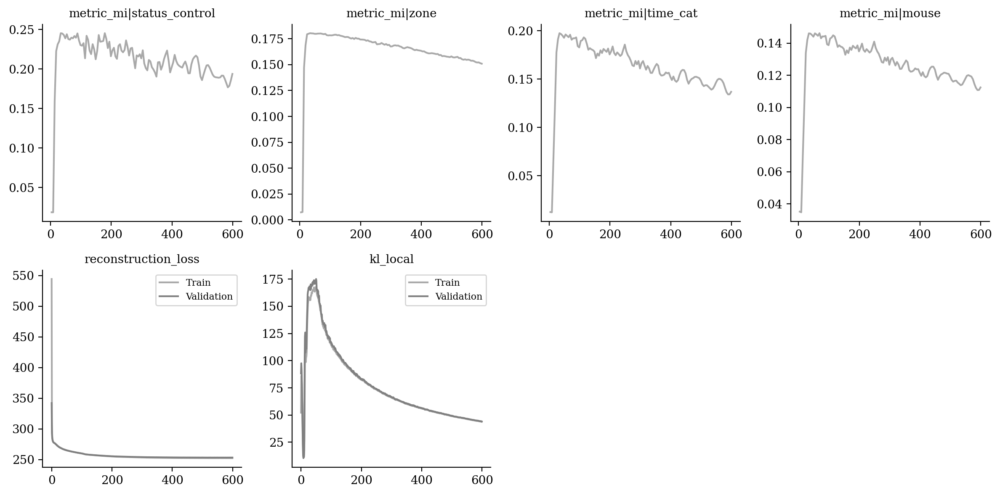

In [15]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [16]:
from tardis._disentanglementmanager import DisentanglementManager as DM

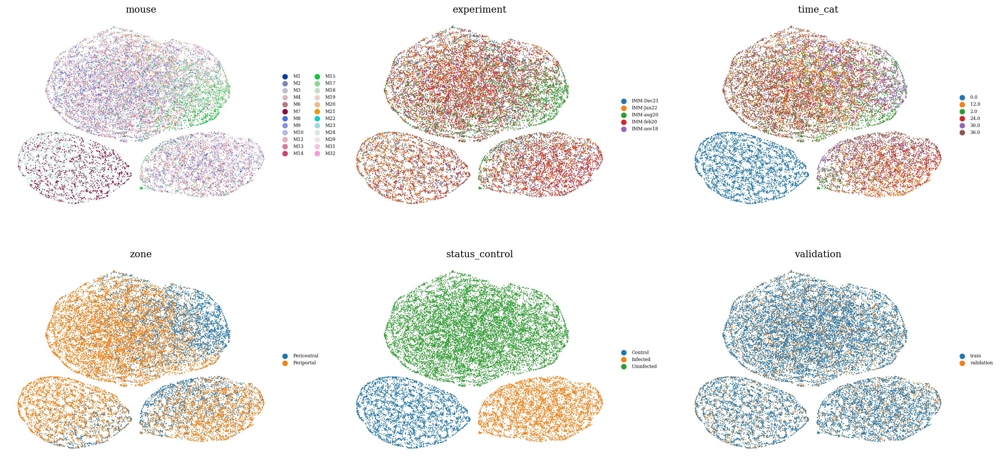

In [17]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

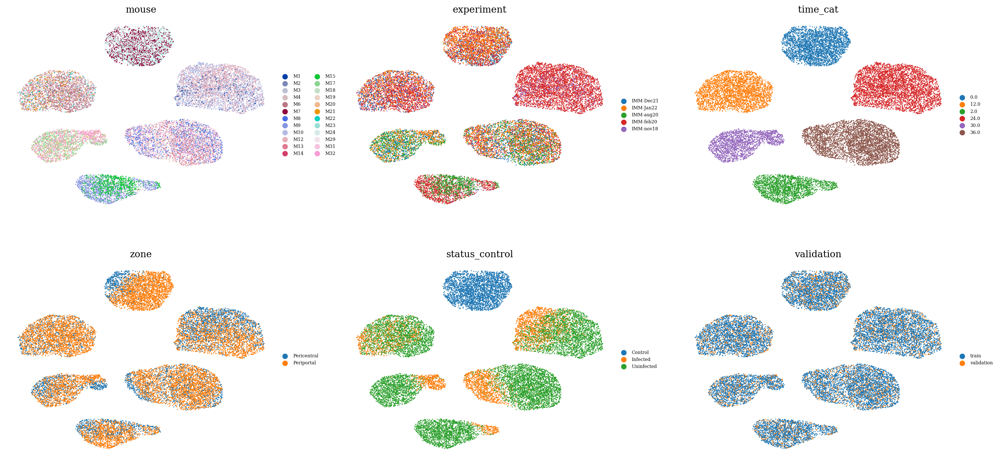

In [18]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

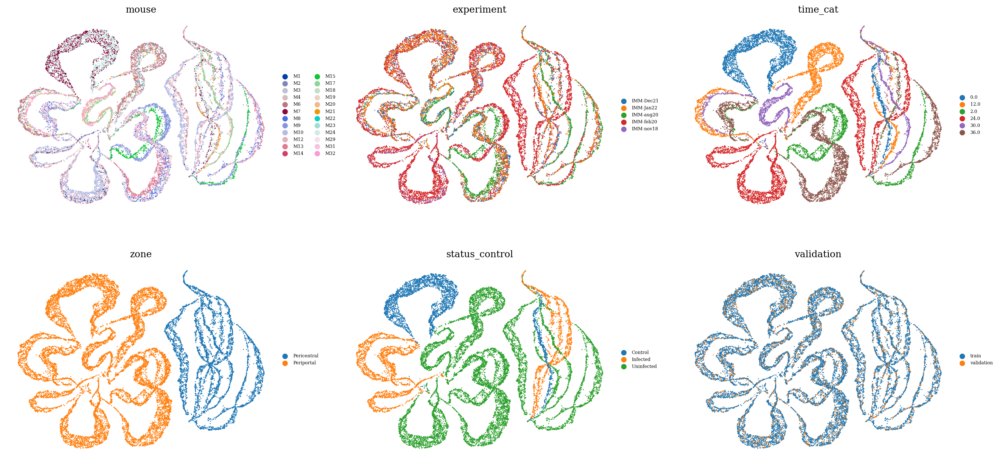

In [19]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

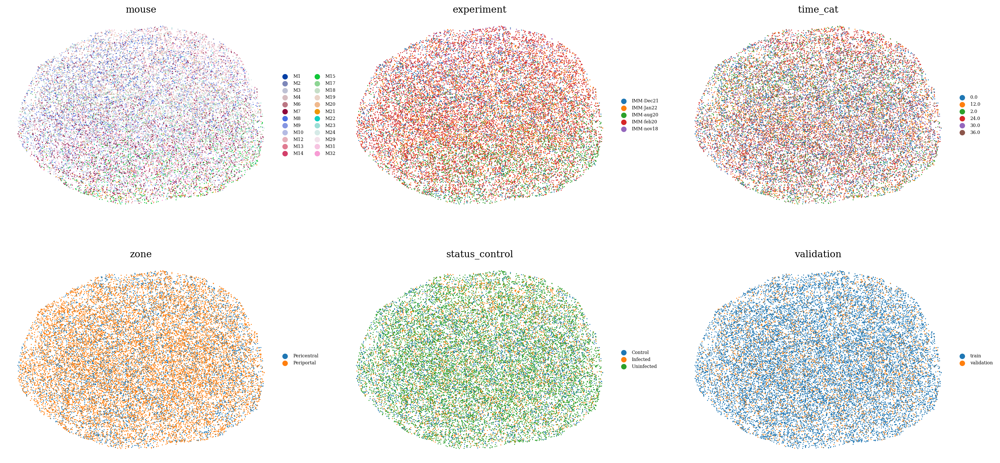

In [20]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

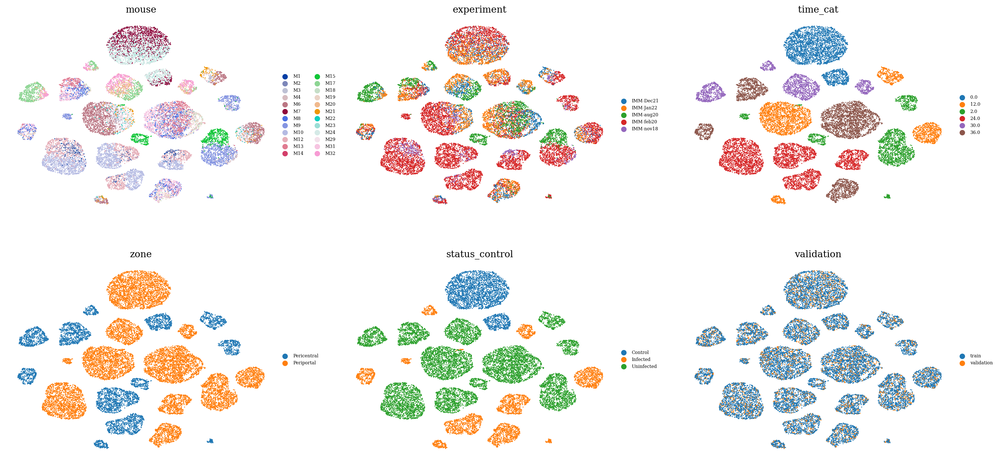

In [21]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [22]:
data = vae.get_latent_representation()

import sklearn
factors_indices = sorted([[indice, config.obs_key] for config in DM.configurations.items for indice in config.reserved_latent_indices])
factors = np.vstack([sklearn.preprocessing.LabelEncoder().fit_transform(
    adata.obs[j].copy().astype(str).values.flatten()
) for i, j in factors_indices]).T

data = data[:, [i for i, j in factors_indices]]

maxMIG = vae.get_MI_precalculated(data=data, factors=factors, variation="maxMIG", discretization_bins=256)
maxMIG_mean = np.mean(maxMIG)
maxMIG_mean

0.8747496216427505

In [23]:
data = vae.get_latent_representation()

import sklearn
factors_indices = sorted([[indice, config.obs_key] for config in DM.configurations.items for indice in config.reserved_latent_indices])
factors = np.vstack([sklearn.preprocessing.LabelEncoder().fit_transform(
    adata.obs[j].copy().astype(str).values.flatten()
) for i, j in factors_indices]).T

data = data[:, [i for i, j in factors_indices]]

maxMIG = vae.get_MI_precalculated(data=data[vae.validation_indices, :], factors=factors[vae.validation_indices, :], variation="maxMIG", discretization_bins=256)
maxMIG_mean = np.mean(maxMIG)
maxMIG_mean

0.828561398410645

In [24]:
vae.get_MI_normalized_training("zone")

{('validation', 'reserved'): 0.9974163883864684,
 ('validation', 'unreserved'): 0.1234396713561778,
 ('train', 'reserved'): 0.9955771070387148,
 ('train', 'unreserved'): 0.08012291252744712}

In [25]:
vae.get_MI_normalized_training("status_control")

{('validation', 'reserved'): 0.9886690253488344,
 ('validation', 'unreserved'): 0.25635955813359546,
 ('train', 'reserved'): 0.988429698325771,
 ('train', 'unreserved'): 0.20177016692571667}

In [26]:
vae.get_MI_normalized_training("time_cat")

{('validation', 'reserved'): 0.9573894100136939,
 ('validation', 'unreserved'): 0.21859278269378377,
 ('train', 'reserved'): 0.9545779515813418,
 ('train', 'unreserved'): 0.14306733082824907}